# 01 — Dataset Exploration & Grouping (Pixel-Art Sprites)

## Notebook: 01_explore_dataset.ipynb
## Project: Hero Portrait Generator — Conditional GAN on Pixel-Art Characters

Этот ноутбук выполняет полное исследование датасета 2D pixel-art персонажей, скачанного с Kaggle (**https://www.kaggle.com/datasets/ayhantasyurt/pixel-art-2dgame-charecter-sprites-idle/data**).

Задача данного этапа — подготовить чистый, структурированный, размеченный датасет, который затем будет использован для обучения Conditional GAN.

## Цели ноутбука

### Загрузить и описать датасет

- количество файлов

- форматы, размеры, RGBA

- структура имён файлов

- выделение индексов idx и хеша спрайта

### Построить таблицу всех файлов

- filename, stem, idx, hash, path

- сохранить как sprites_raw.csv

### Проверить распределения

- частоты idx (0–10)

- размеры изображений

- режимы (RGBA)

- количество хешей

### Выделить уникальные персонажи ("шаблоны")
- Мы группируем спрайты по их силуэту, чтобы понять сколько уникальных персонажей реально есть в датасете.

- бинаризация изображения

- получение silhouette-hash (MD5 от бинарной маски)

- группировка файлов

- построение sprite_groups.csv

### Визуальная проверка кластеров
Для каждой группы отображаем несколько примеров, чтобы:

- убедиться, что silhouette-hash корректно собирает одинаковых персонажей

- определить, какие группы являются ошибочными

(в ноутбуке код: “по 10 представителей каждой группы”)

### Подготовить шаблон для ручной разметки
Создаём CSV group_labels_template.csv со столбцами:

group_id, gender, hero_class


где:

gender → masculine / feminine

hero_class → warrior / mage / cleric / knight / barbarian / rogue / ranger / bard / cavalry

Этот файл размечался вручную.

### Объединить разметку и группы
- Склеиваем:

sprite_groups.csv

group_labels_template.csv

- Результат:
→ sprites_labeled.csv

- Проверка корректности

отсутствие пропущенных групп

размерность

соответствие уникальных group_id

## Структура ноутбука
1. Импорты и настройка путей

Здесь задаются:

base_path

загрузка библиотек PIL / pandas / numpy / tqdm

2. Сбор списков файлов

Из директории train_images/ собираем все PNG-файлы, строим таблицу.

Выводим:

общее количество файлов

первые строки датафрейма

3. Анализ имён файлов

Парсим:

idx — индекс варианта (0–10), скорее всего: front/back/left/right и палитры

hash — уникальный ID конкретного спрайта

Сохраняем в датафрейм.

## Анализ размеров и форматов

Проверяем:

Counter(size)
Counter(mode)


### В результате мы обнаружили:

- все изображения 128×128

- все в режиме RGBA

## Вычисление silhouette-hash

Создаётся функция:

конвертация альфа-маски

бинаризация

MD5

Вычисляем хеш для 7596 изображений.

## Результат:

205 уникальных шаблонов персонажей

Сохраняем:

filename, idx, silhouette_hash
→ sprite_groups.csv

## Предварительный анализ групп

Считаем:

размеры групп

распределение количества спрайтов на персонажа

Строим топ-20 самых больших групп (для визуального контроля).

## Визуальная проверка (по 10 примеров на группу)

Используем подготовленную функцию, которая:

выбирает любую группу

показывает 10 изображений из неё

подтверждает, что silhouette-hash корректен

## Подготовка файла разметки

Создаём:

group_labels_template.csv


с колонками:

group_id,gender,hero_class


Этот файл размечается вручную по группам.

## Слияние групп + разметки

После разметки, объединяем:

groups = read_csv(sprite_groups.csv)
labels = read_csv(group_labels_template.csv)
merged = groups.merge(labels)


Сохраняем:

sprites_labeled.csv

## Результаты ноутбука

Финально создаются три ключевых артефакта:

✔ sprites_raw.csv

Все файлы + пути + idx + хеши

✔ sprite_groups.csv

Отнесение каждого файла к конкретному персонажу (205 групп)

✔ sprites_labeled.csv

Файлы + группа + пол + класс персонажа

Эти данные идут в следующий ноутбук: 02_build_final_dataset.ipynb

In [2]:
import hashlib
import math
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from collections import Counter
from pathlib import Path
from PIL import Image
from tqdm import tqdm

In [2]:
ROOT_DIR = Path(r"D:\ML\LS\Deep_learning\GAN\hero_portrait_generator")
TRAIN_DATA_DIR = ROOT_DIR / 'train_images'

files = sorted(TRAIN_DATA_DIR.glob("*.png"))
print(f"Всего файлов: {len(files)}")

rows = []
for p in files:
    stem = p.stem  
    parts = stem.split("_")
    if len(parts) >= 3 and parts[0] == "image":
        idx = parts[1]
        hash_part = "_".join(parts[2:])
    else:
        idx = None
        hash_part = None
    rows.append({
        "filename": p.name,
        "stem": stem,
        "idx": idx,
        "hash": hash_part,
        "path": str(p)
    })

df = pd.DataFrame(rows)
df.head()

Всего файлов: 7596


,filename,stem,idx,hash,path
0,image_0_017767286f7f40fdac605acf20e0abd0.png,image_0_017767286f7f40fdac605acf20e0abd0,0,017767286f7f40fdac605acf20e0abd0,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...
1,image_0_0c675f243c4144d98e5d21061d661911.png,image_0_0c675f243c4144d98e5d21061d661911,0,0c675f243c4144d98e5d21061d661911,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...
2,image_0_1c6697f5b9684e28b67d9e1f36c20e2a.png,image_0_1c6697f5b9684e28b67d9e1f36c20e2a,0,1c6697f5b9684e28b67d9e1f36c20e2a,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...
3,image_0_1ed2ac7ca5e44321ae1dbad2a4c523fc.png,image_0_1ed2ac7ca5e44321ae1dbad2a4c523fc,0,1ed2ac7ca5e44321ae1dbad2a4c523fc,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...
4,image_0_2630d288f1c540e19246aff50a66625e.png,image_0_2630d288f1c540e19246aff50a66625e,0,2630d288f1c540e19246aff50a66625e,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...


In [3]:
print("Распределение по idx (вторая часть имени):")
print(df["idx"].value_counts().sort_index())

Распределение по idx (вторая часть имени):
idx
0       19
1        2
10     259
102      3
105     18
      ... 
91      33
92      44
95     104
96      43
98     242
Name: count, Length: 116, dtype: int64


In [6]:
sizes = Counter()
modes = Counter()

for p in files: 
    with Image.open(p) as img:
        sizes[img.size] += 1
        modes[img.mode] += 1

print("Размеры (size -> count):", sizes)
print("Режимы (mode -> count):", modes)

Размеры (size -> count): Counter({(128, 128): 7596})
Режимы (mode -> count): Counter({'RGBA': 7596})


In [7]:
DATA_DIR = ROOT_DIR / 'data'
raw_csv_path = DATA_DIR / "sprites_raw.csv"
df[["filename", "path", "idx"]].to_csv(raw_csv_path, index=False)
print(f"Сохранено: {raw_csv_path}")

Сохранено: D:\ML\LS\Deep_learning\GAN\hero_portrait_generator\sprites_raw.csv


In [8]:
def silhouette_hash(path, size=(32, 32), threshold=5):
    """
    path: путь к PNG
    size: к какому размеру приводим
    threshold: порог яркости для бинаризации (0–255)
    """
    with Image.open(path) as img:
        # приводим к L, уменьшаем
        img = img.convert("L").resize(size, Image.NEAREST)
        arr = np.array(img)
        # выкидываем почти-чёрный фон
        mask = (arr > threshold).astype(np.uint8)
        # считаем хэш по бинарной маске
        h = hashlib.md5(mask.tobytes()).hexdigest()
        return h

hashes = []
for p in tqdm(files, desc="Computing silhouette hashes"):
    h = silhouette_hash(p)
    hashes.append(h)

df["silhouette_hash"] = hashes

print("Количество уникальных шаблонов (по silhouette_hash):", df["silhouette_hash"].nunique())
df[["filename", "idx", "silhouette_hash"]].head()

Computing silhouette hashes: 100%|██████████| 7596/7596 [00:01<00:00, 4451.26it/s]

Количество уникальных шаблонов (по silhouette_hash): 205


,filename,idx,silhouette_hash
0,image_0_017767286f7f40fdac605acf20e0abd0.png,0,eec6bb950739fea09983e1f52b0cd4e3
1,image_0_0c675f243c4144d98e5d21061d661911.png,0,e87042f6b71065c219f8456ec2d18732
2,image_0_1c6697f5b9684e28b67d9e1f36c20e2a.png,0,c1012a17d3ed53d968679e18a1729120
3,image_0_1ed2ac7ca5e44321ae1dbad2a4c523fc.png,0,3d1c8e4373c5622762aa9b59c741a30f
4,image_0_2630d288f1c540e19246aff50a66625e.png,0,c6a807ea2c297b40193171d74ce4b45b


In [9]:
group_sizes = df.groupby("silhouette_hash")["filename"].count().sort_values(ascending=False)
print(group_sizes.head(20))
print("Всего групп:", len(group_sizes))

silhouette_hash
373543245f7fb30b1b55d7778102eede    311
fdda870821d4d78c0a24b9292f51302f    281
92da744dc77ed632730b683de5dc0047     66
f5a5fcf54d9dd7e89cc233bef368641b     64
f04a6c8aefaed2cdd88bc9730a1e06be     63
6567180dc44e16a7cea756de64a8f62f     61
3f68ef2d6403c00121c2973d88a17292     60
c5823831108ff326dd0fef21beeeef60     57
8fa879d9e410732730e114193a6dddc2     57
dafc02b461e18128b1e3ba6bbe84424f     57
4fccf3c88584dbbe5d8ec509a8068ae7     56
73068f4c117fbe45baf714e5a9a5e838     56
cd9d5d9042f0ee314a51f9937deb5c6f     56
51effabf407c61fda9fb73f2ae1ea663     55
307f375d9c4f174318df10f399caffe4     55
2943aede4b6fdb93b8f44a2dd865e8d0     55
3f5ace450c0b39a3c9b631292b285191     55
7a32126c75716e8498eab2493e09bb27     55
c0f1685256232e69dc909371bfdd73dc     54
6fbfa55374fa39935df1c2373a67747a     54
Name: filename, dtype: int64
Всего групп: 205


In [10]:
# присвоим group_id как просто порядковый номер уникального silhouette_hash
hash_to_group = {h: i for i, h in enumerate(df["silhouette_hash"].unique())}
df["group_id"] = df["silhouette_hash"].map(hash_to_group)

groups_csv_path = DATA_DIR / "sprite_groups.csv"
df[["filename", "path", "idx", "silhouette_hash", "group_id"]].to_csv(groups_csv_path, index=False)
print(f"Сохранено: {groups_csv_path}")

Сохранено: D:\ML\LS\Deep_learning\GAN\hero_portrait_generator\sprite_groups.csv


Всего групп: 205


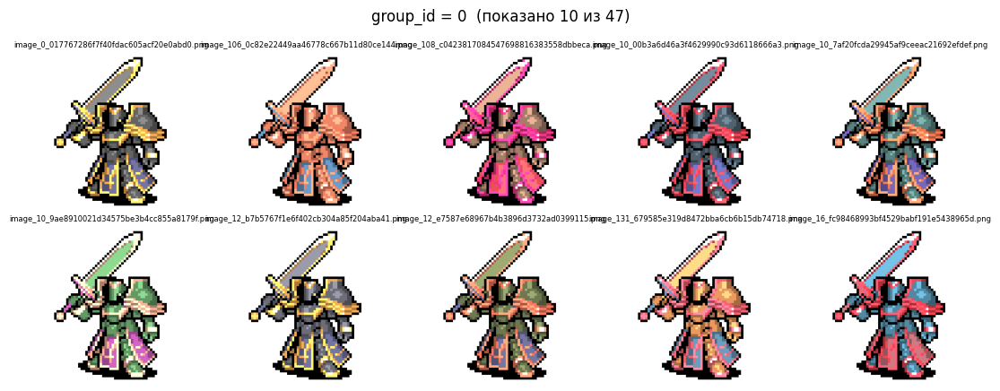

Enter — следующая группа, 'q' — выйти:  


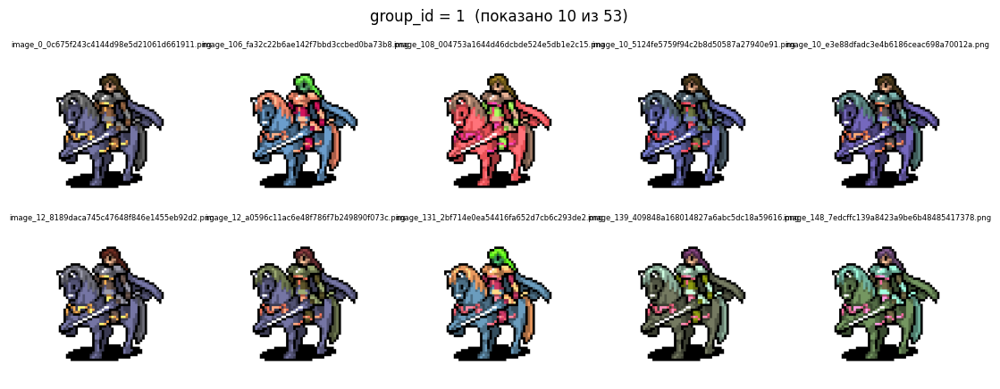

Enter — следующая группа, 'q' — выйти:  


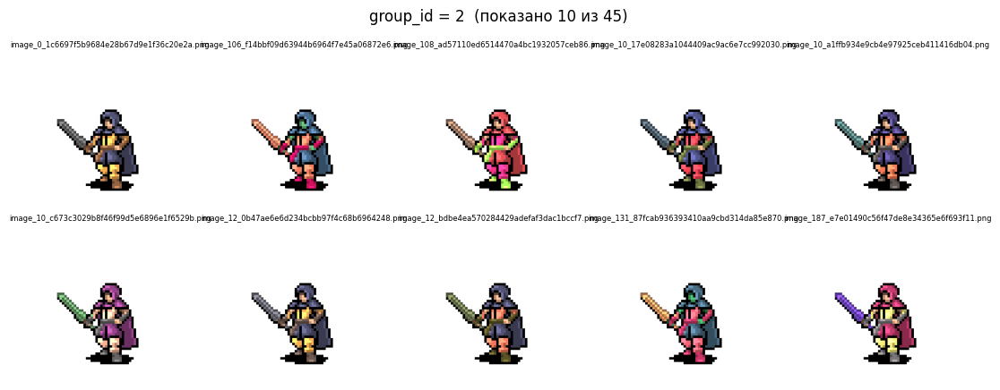

Enter — следующая группа, 'q' — выйти:  


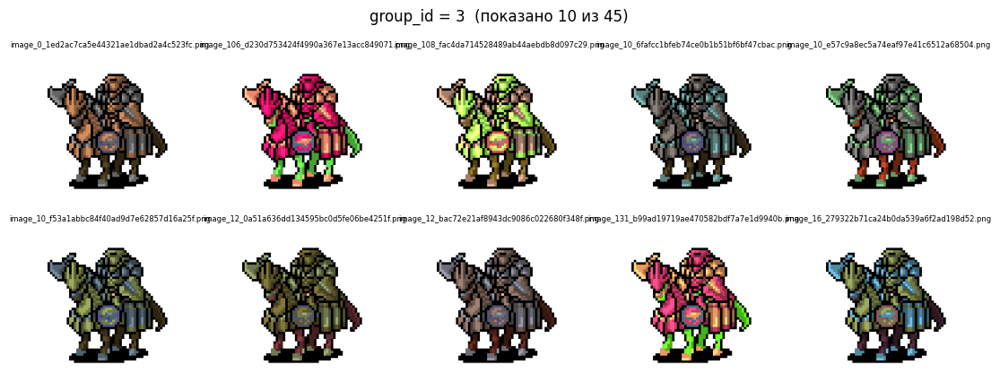

Enter — следующая группа, 'q' — выйти:  


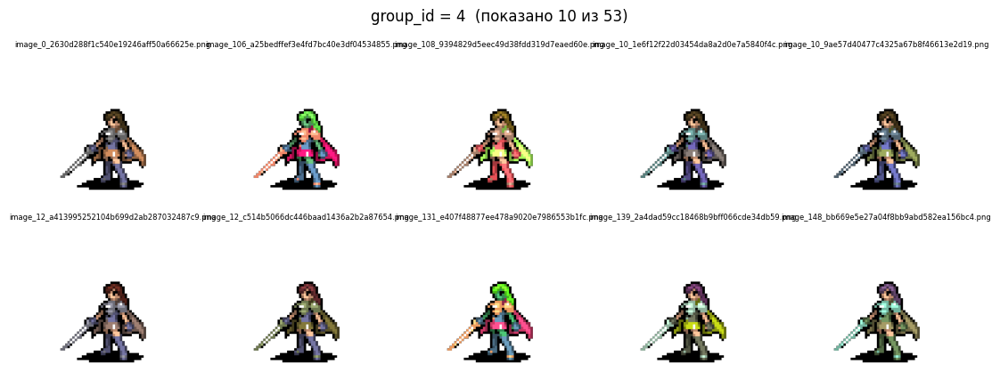

Enter — следующая группа, 'q' — выйти:  


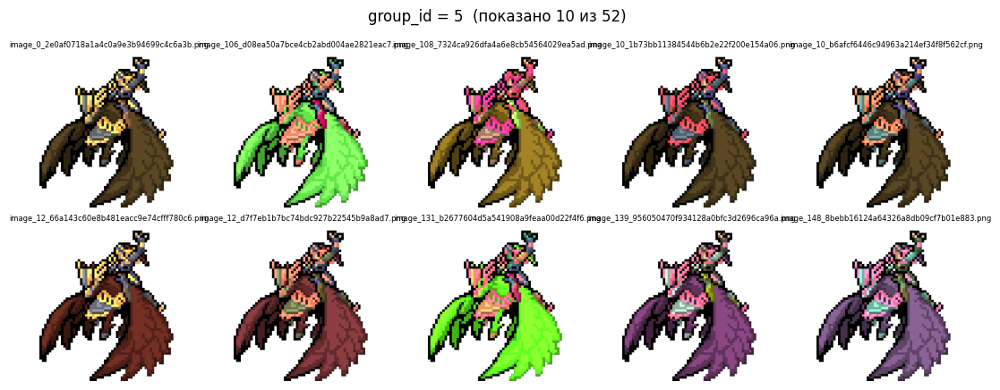

Enter — следующая группа, 'q' — выйти:  


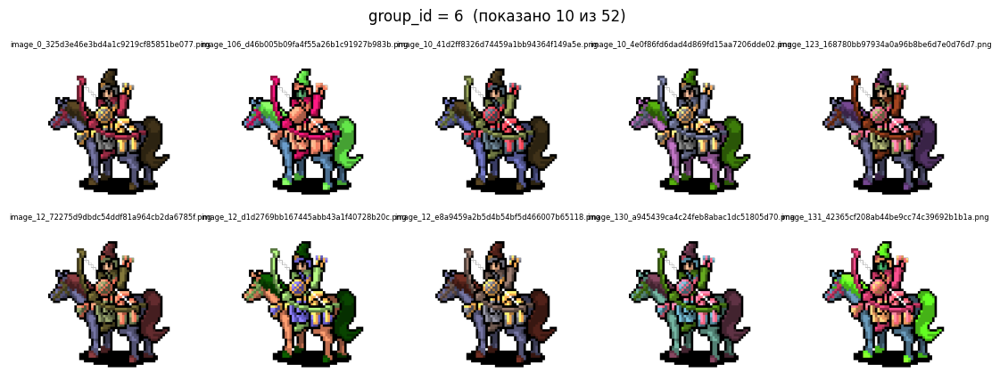

Enter — следующая группа, 'q' — выйти:  


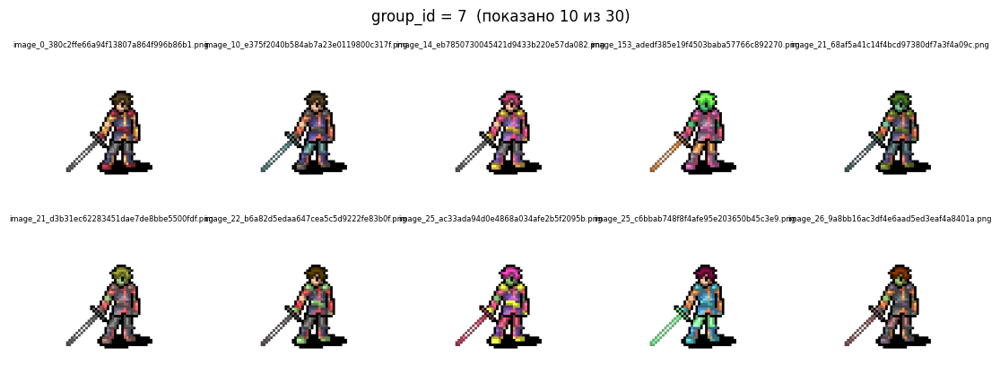

Enter — следующая группа, 'q' — выйти:  


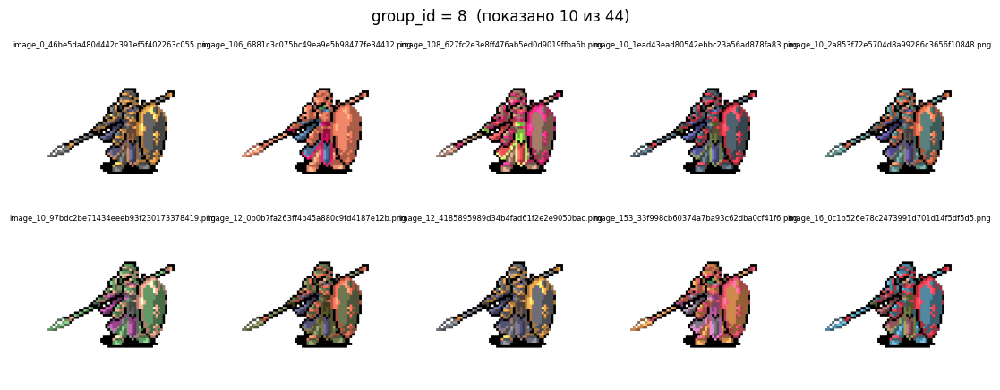

Enter — следующая группа, 'q' — выйти:  


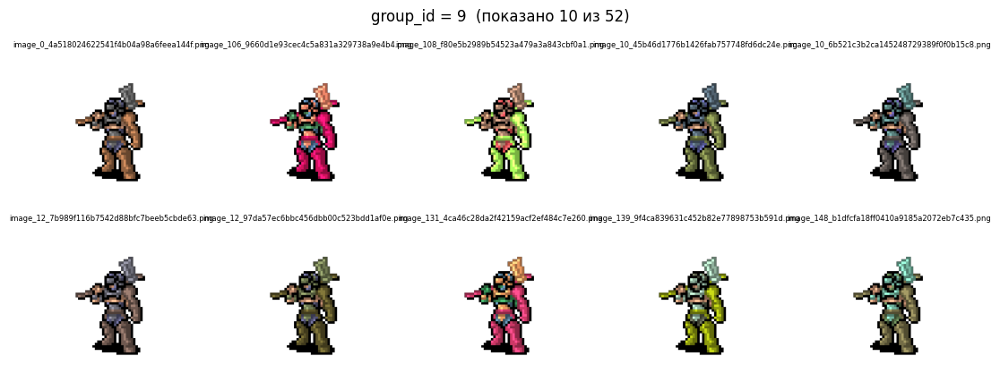

Enter — следующая группа, 'q' — выйти:  


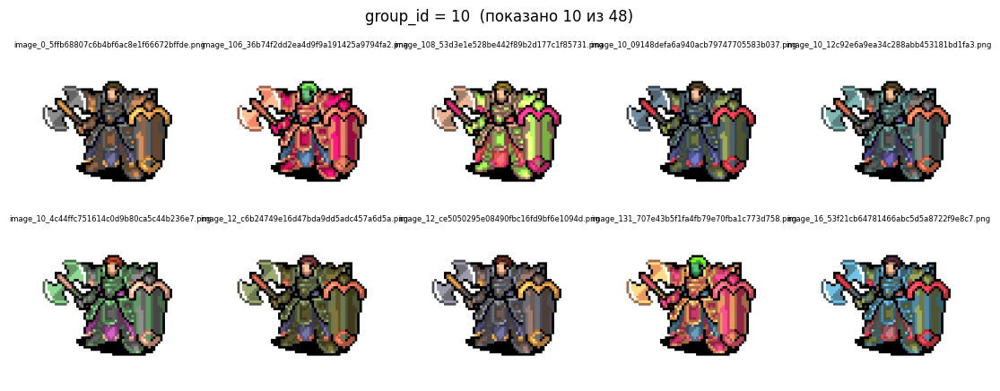

Enter — следующая группа, 'q' — выйти:  


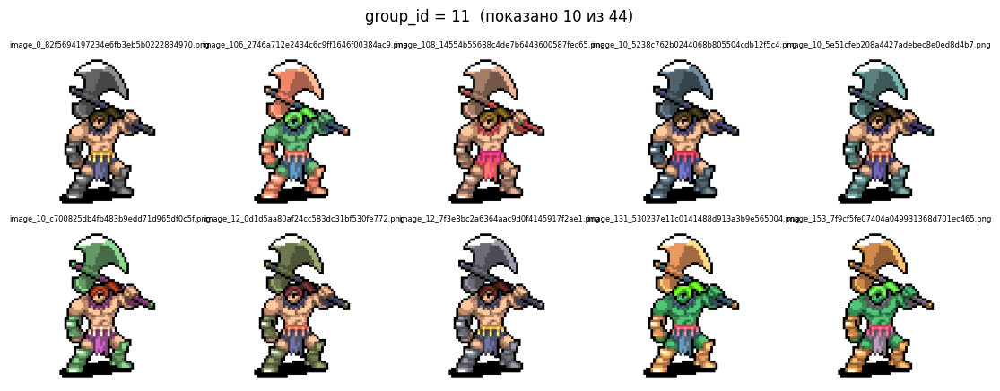

Enter — следующая группа, 'q' — выйти:  


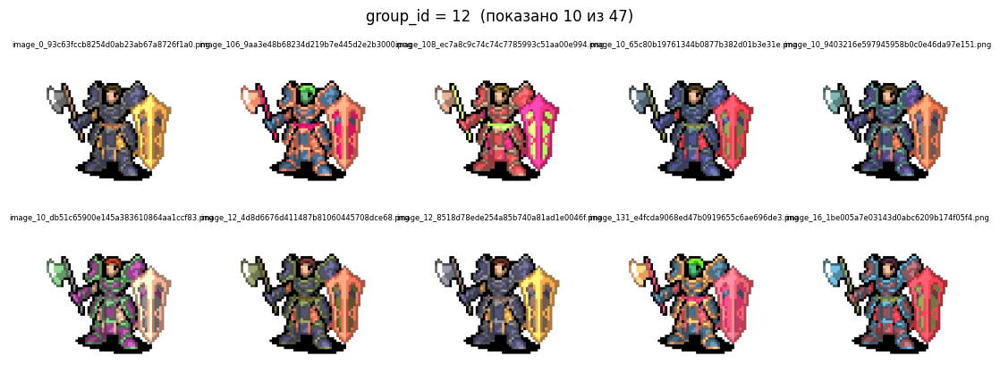

Enter — следующая группа, 'q' — выйти:  


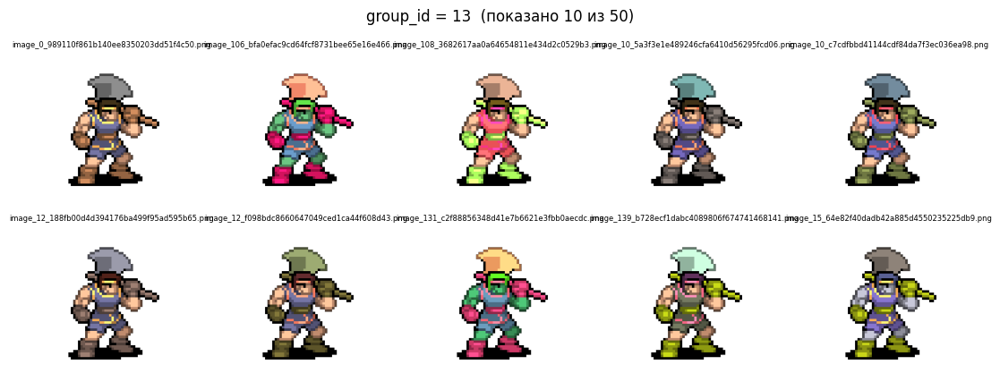

Enter — следующая группа, 'q' — выйти:  


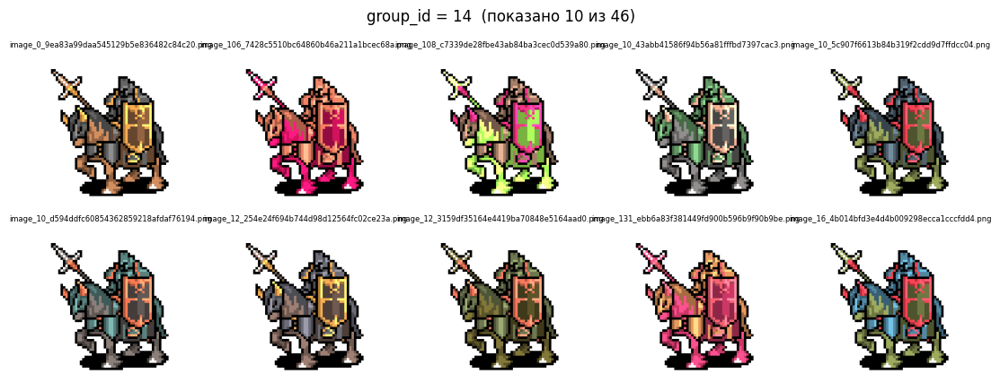

Enter — следующая группа, 'q' — выйти:  


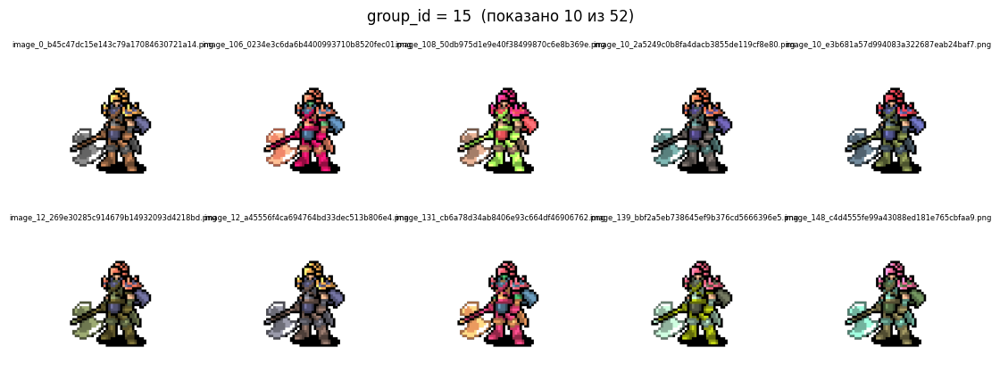

Enter — следующая группа, 'q' — выйти:  


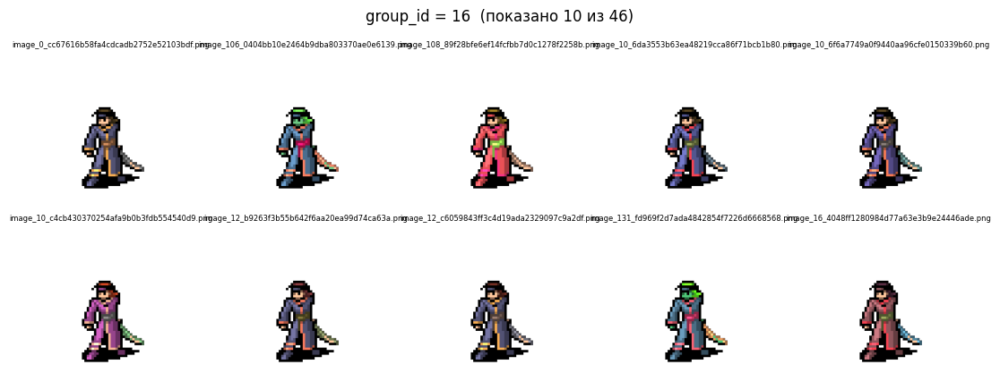

Enter — следующая группа, 'q' — выйти:  


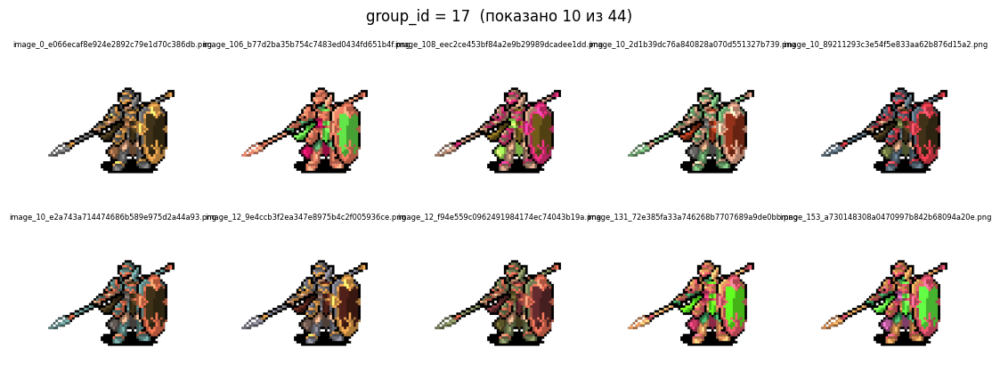

Enter — следующая группа, 'q' — выйти:  


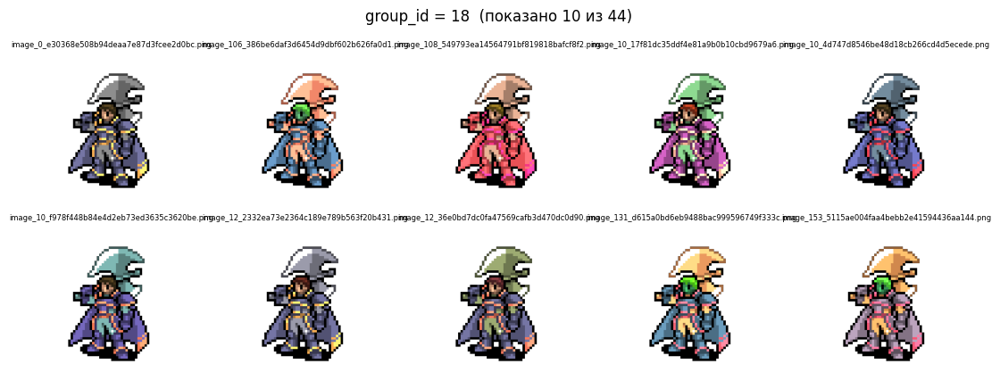

Enter — следующая группа, 'q' — выйти:  


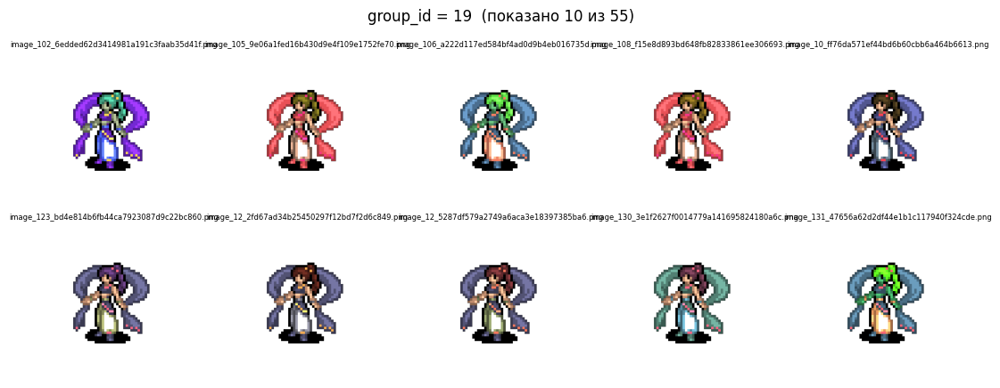

Enter — следующая группа, 'q' — выйти:  


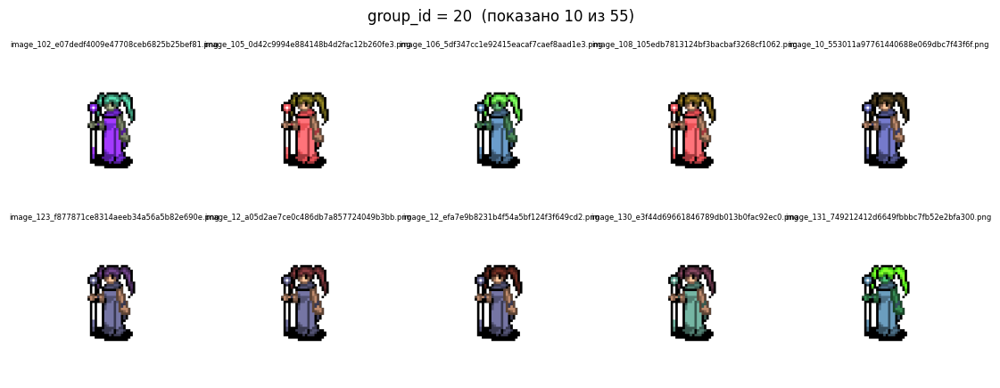

Enter — следующая группа, 'q' — выйти:  


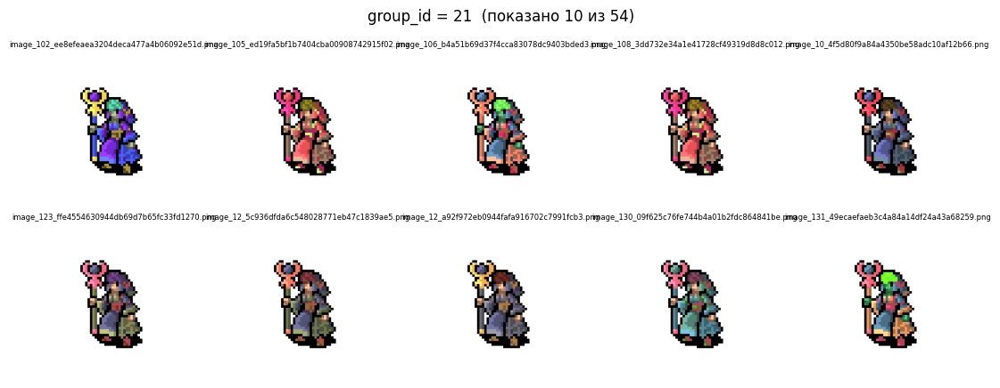

Enter — следующая группа, 'q' — выйти:  


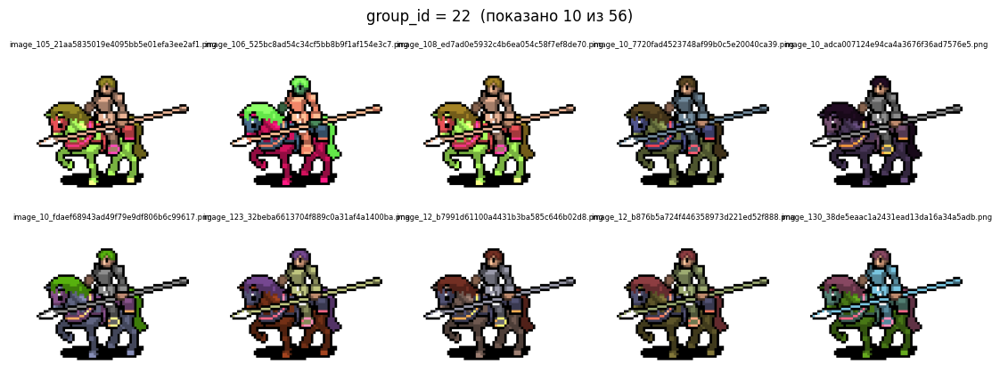

Enter — следующая группа, 'q' — выйти:  


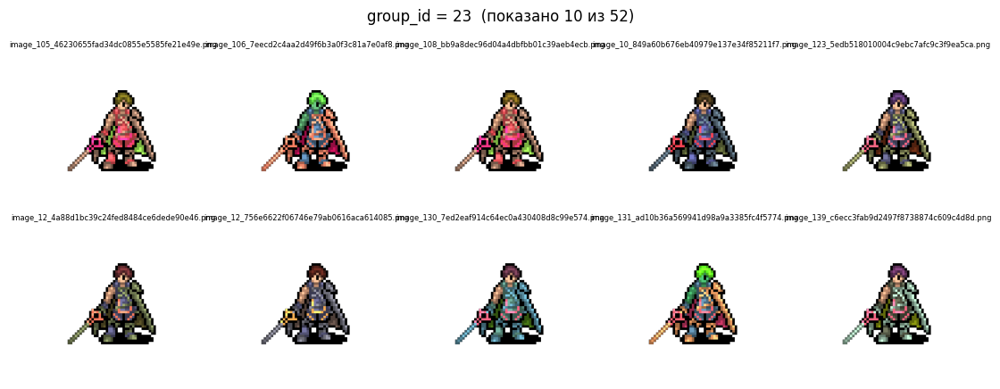

Enter — следующая группа, 'q' — выйти:  


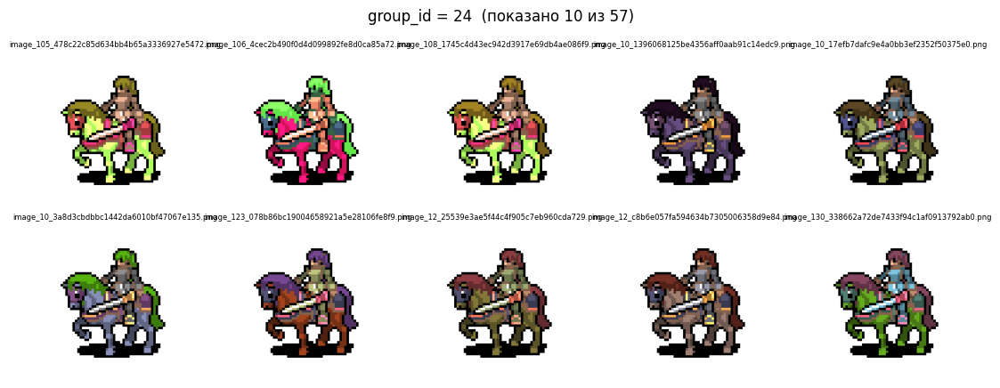

Enter — следующая группа, 'q' — выйти:  


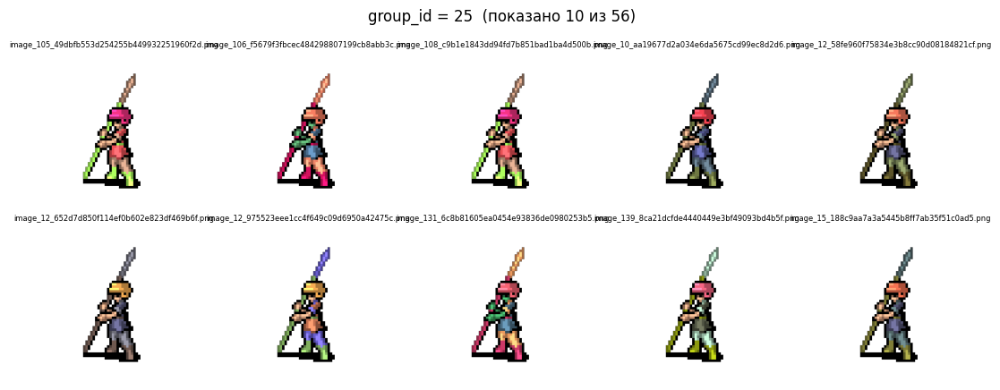

Enter — следующая группа, 'q' — выйти:  


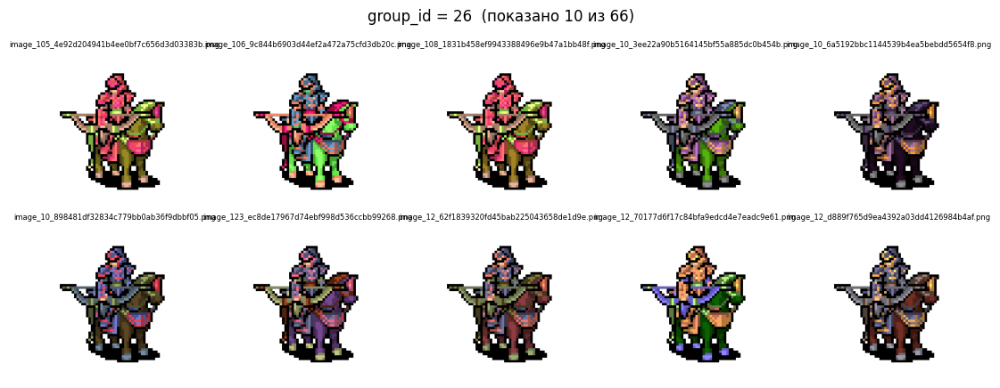

Enter — следующая группа, 'q' — выйти:  


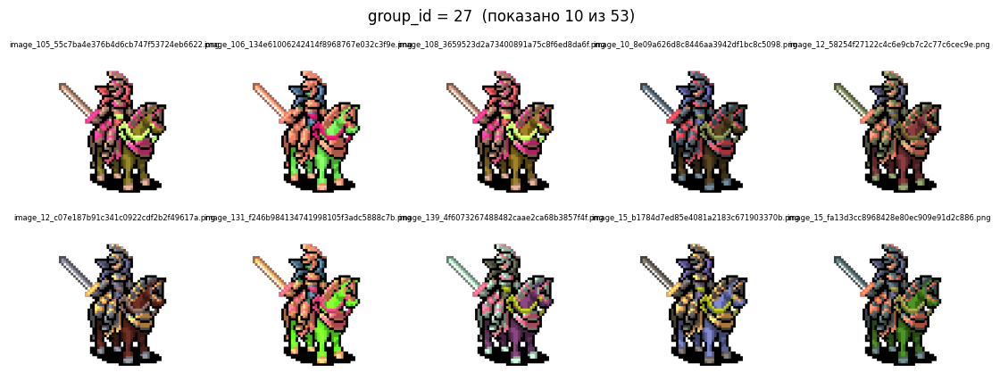

Enter — следующая группа, 'q' — выйти:  


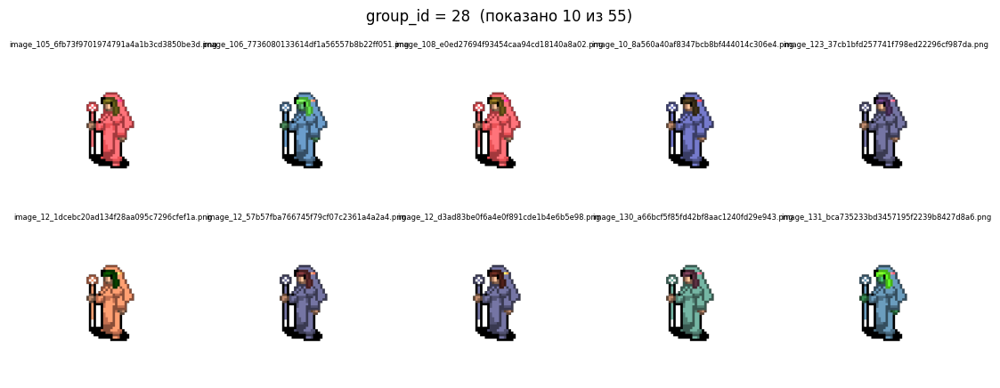

Enter — следующая группа, 'q' — выйти:  


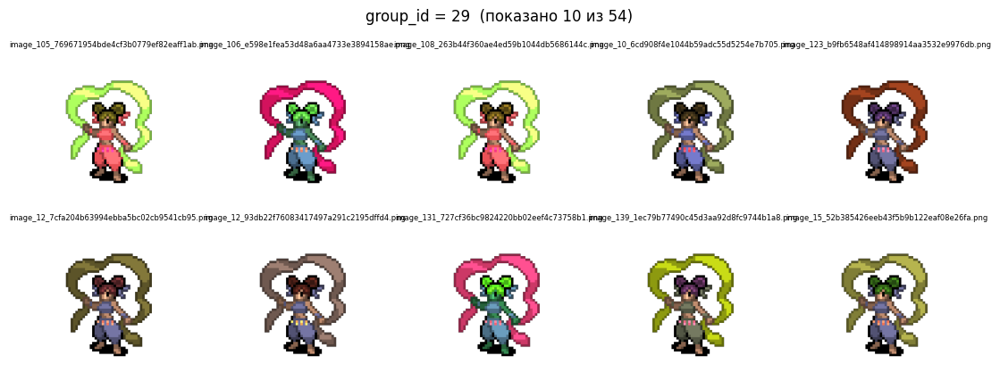

Enter — следующая группа, 'q' — выйти:  


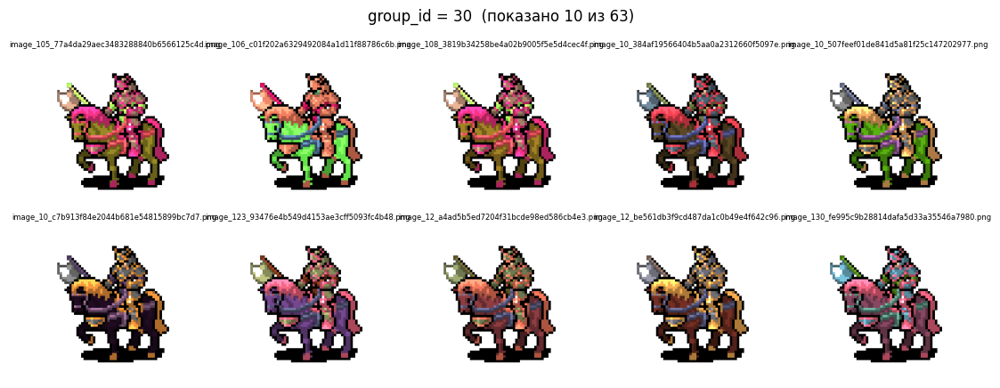

Enter — следующая группа, 'q' — выйти:  


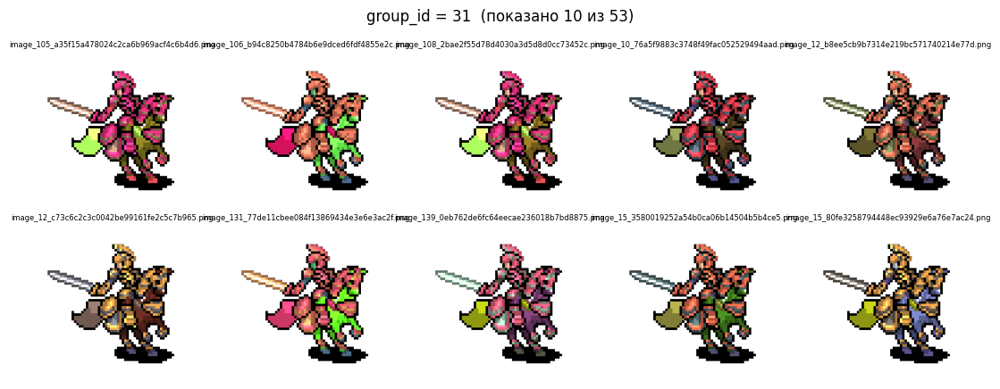

Enter — следующая группа, 'q' — выйти:  


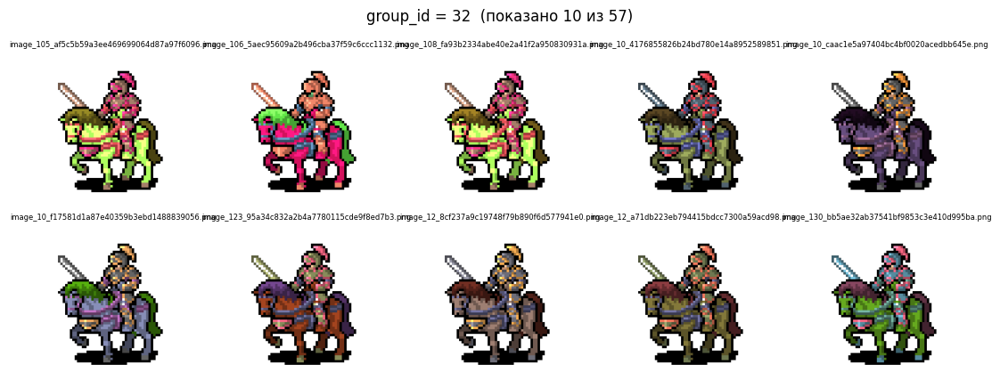

Enter — следующая группа, 'q' — выйти:  


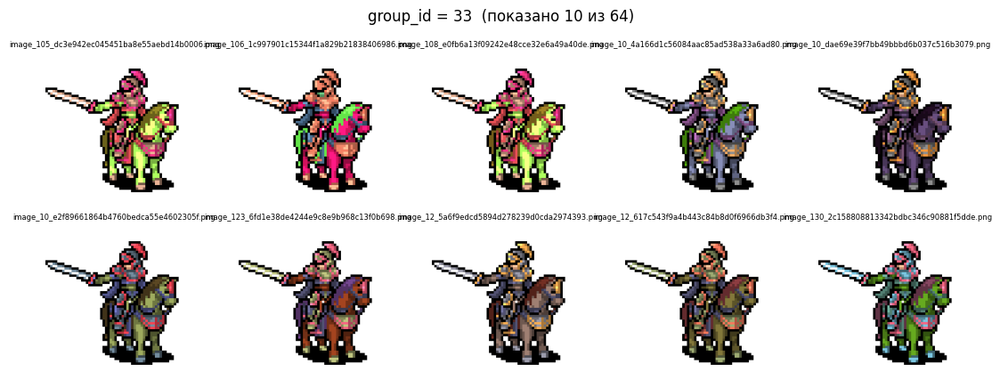

Enter — следующая группа, 'q' — выйти:  


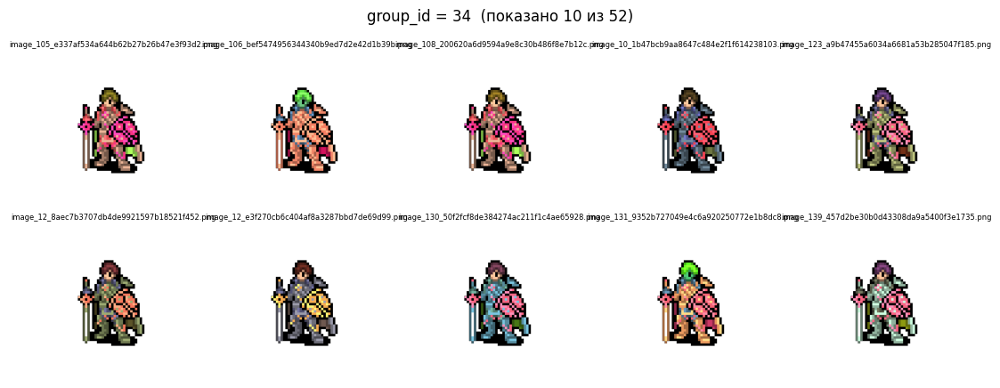

Enter — следующая группа, 'q' — выйти:  


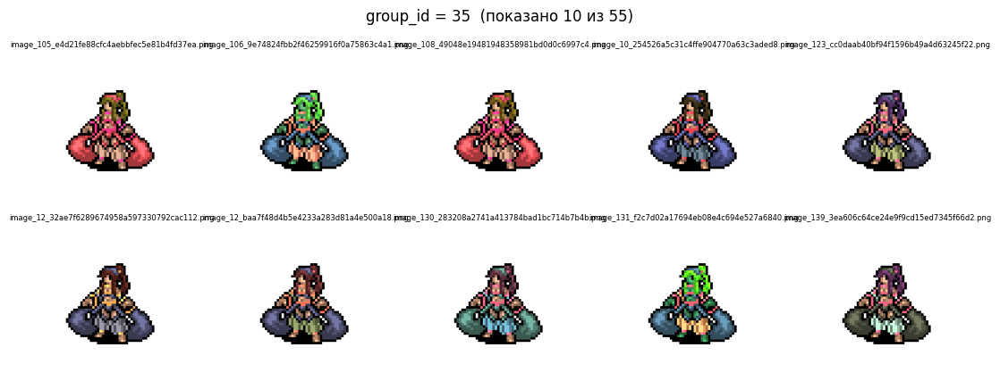

Enter — следующая группа, 'q' — выйти:  


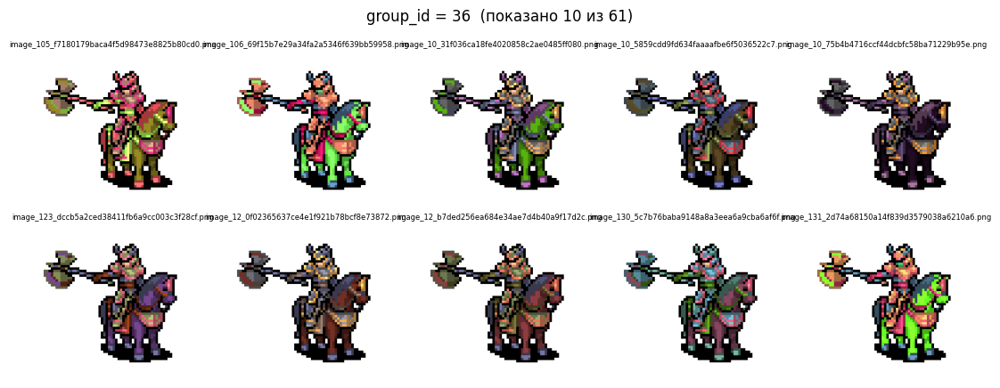

Enter — следующая группа, 'q' — выйти:  


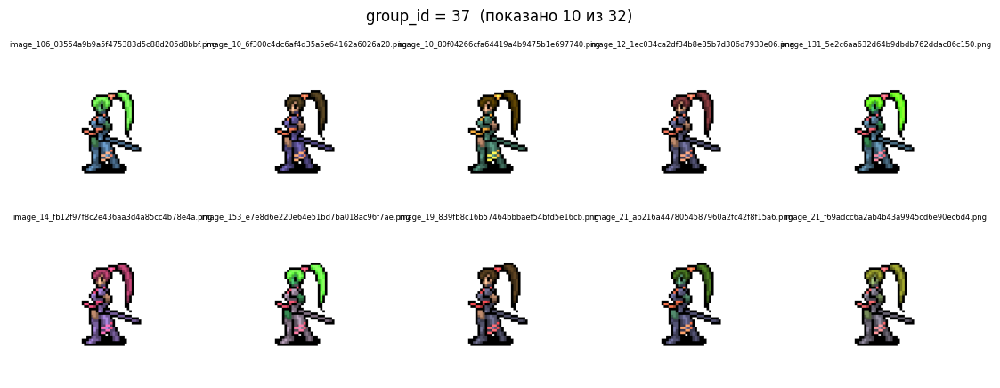

Enter — следующая группа, 'q' — выйти:  


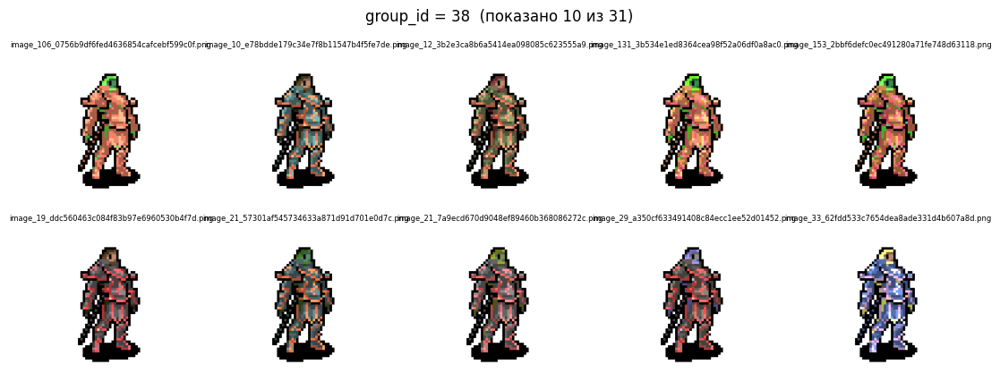

Enter — следующая группа, 'q' — выйти:  


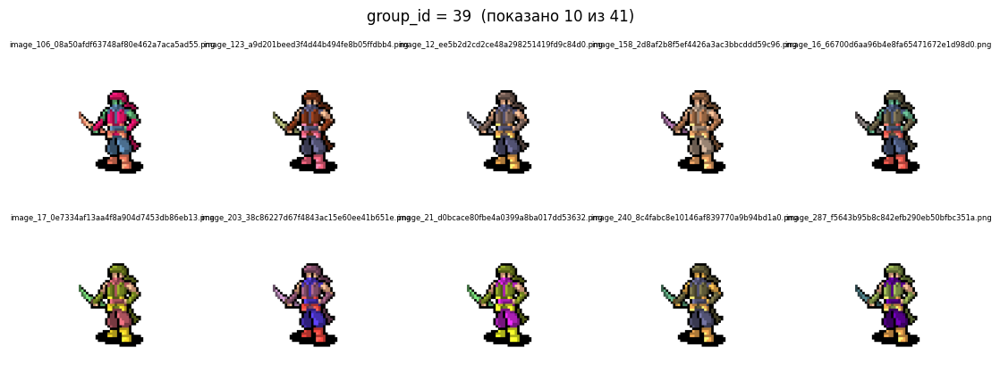

Enter — следующая группа, 'q' — выйти:  


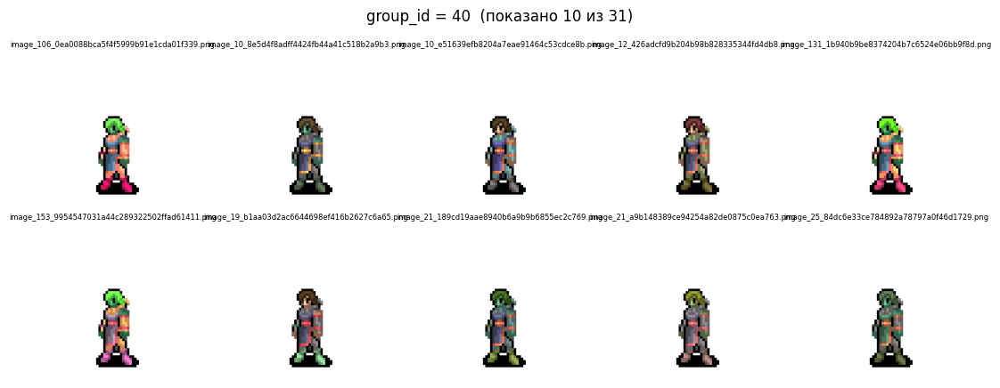

Enter — следующая группа, 'q' — выйти:  


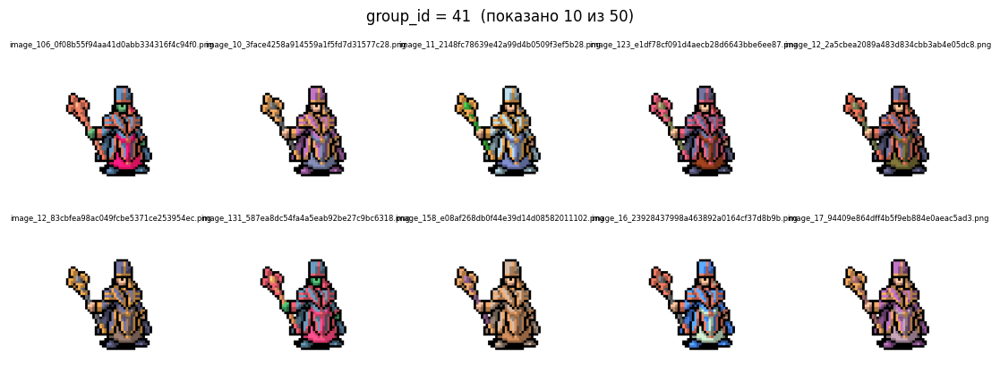

Enter — следующая группа, 'q' — выйти:  


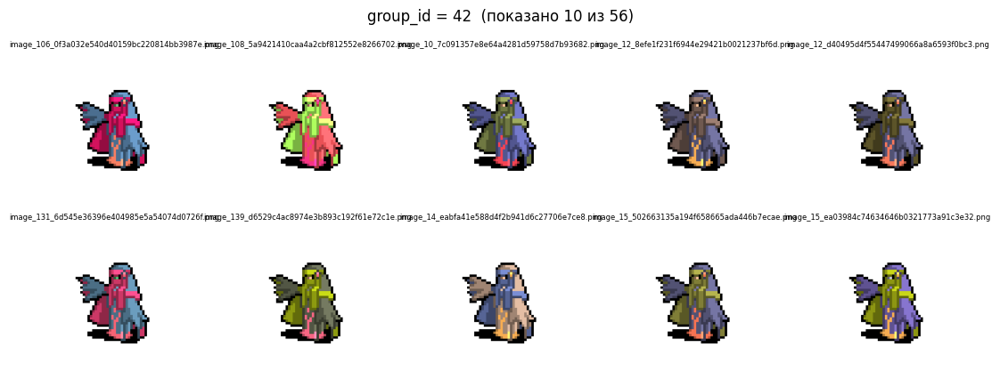

Enter — следующая группа, 'q' — выйти:  


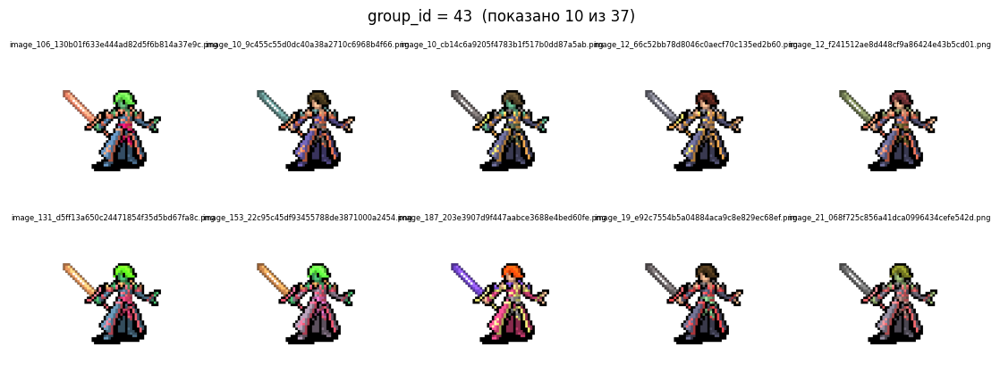

Enter — следующая группа, 'q' — выйти:  


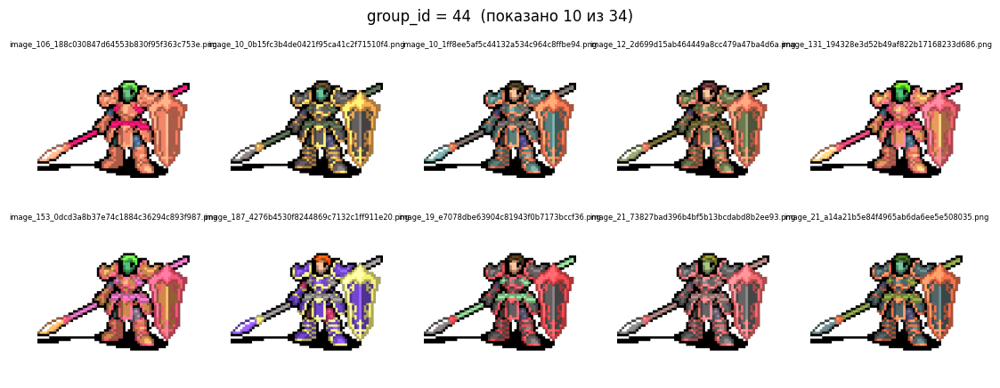

Enter — следующая группа, 'q' — выйти:  


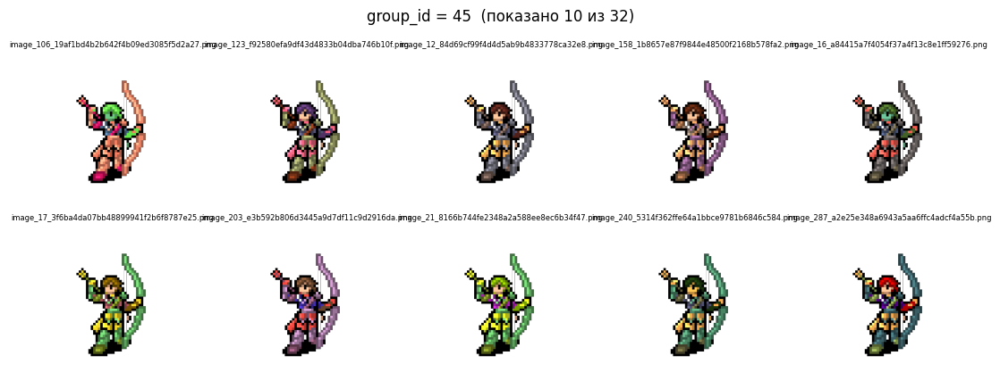

Enter — следующая группа, 'q' — выйти:  


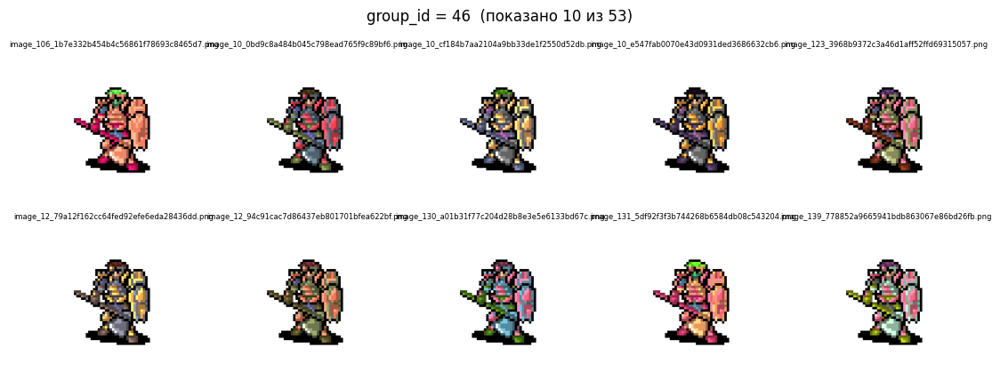

Enter — следующая группа, 'q' — выйти:  


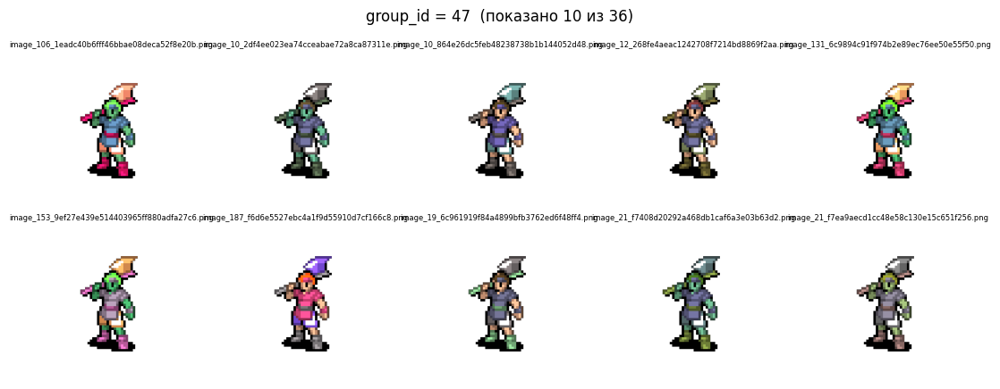

Enter — следующая группа, 'q' — выйти:  


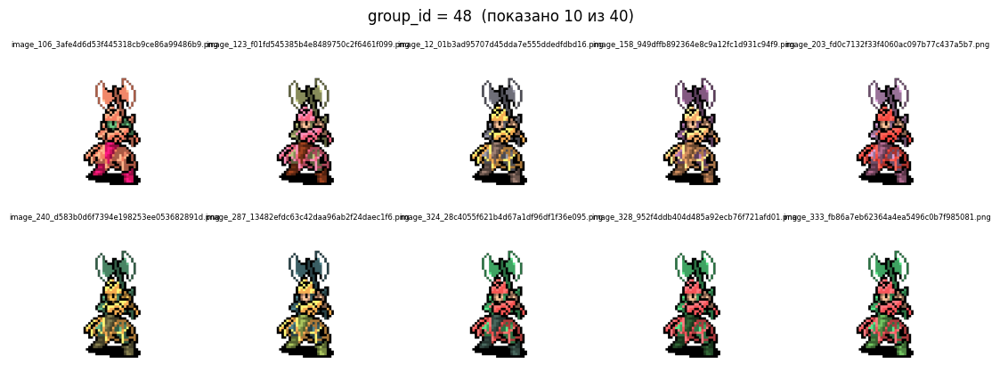

Enter — следующая группа, 'q' — выйти:  


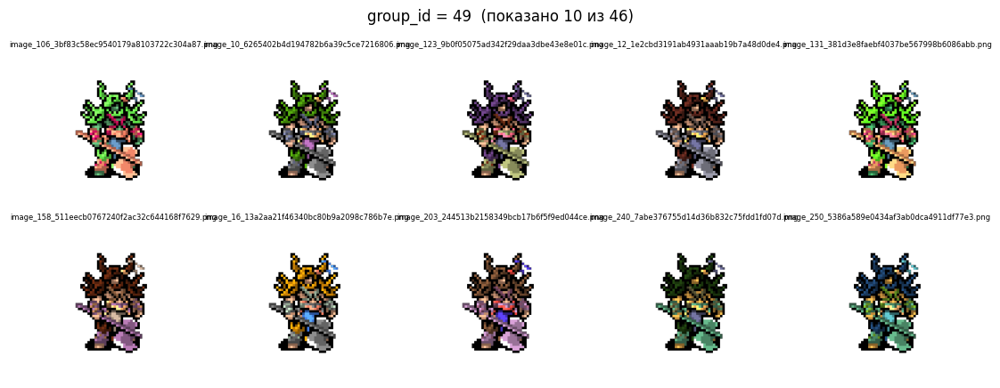

Enter — следующая группа, 'q' — выйти:  


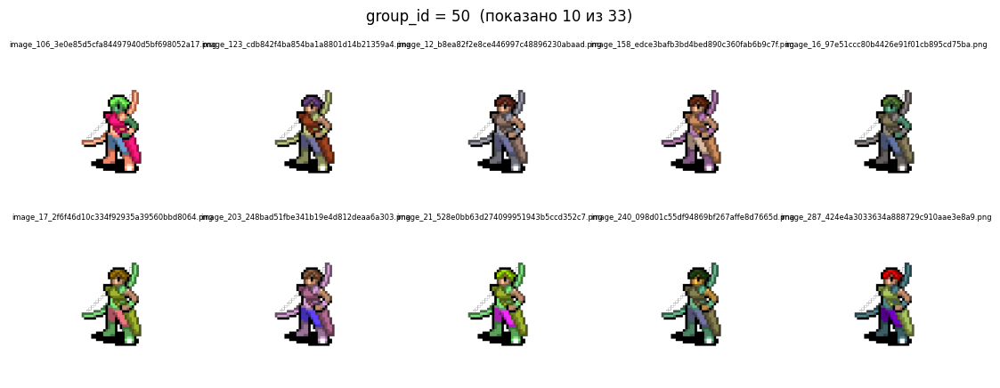

Enter — следующая группа, 'q' — выйти:  


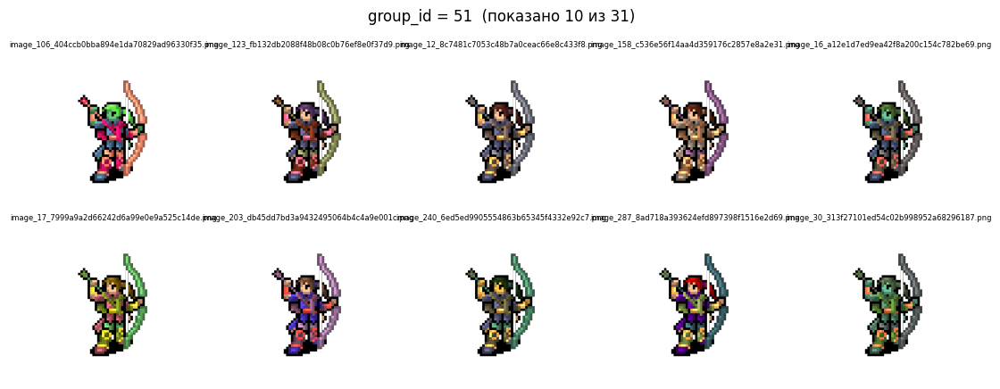

Enter — следующая группа, 'q' — выйти:  


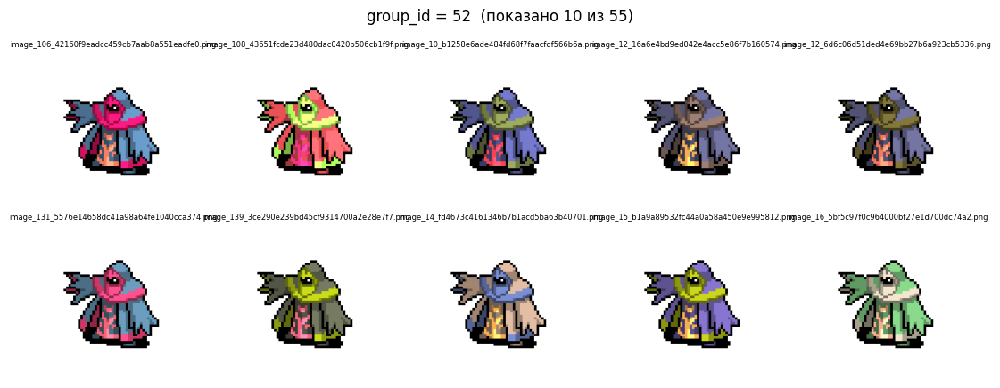

Enter — следующая группа, 'q' — выйти:  


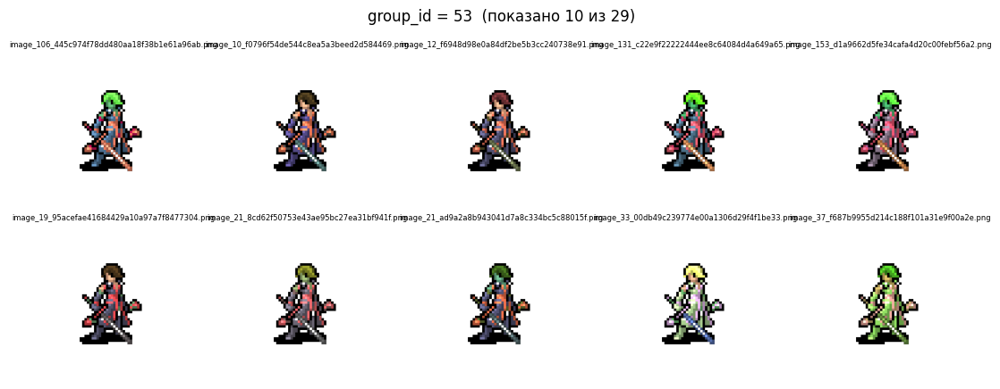

Enter — следующая группа, 'q' — выйти:  


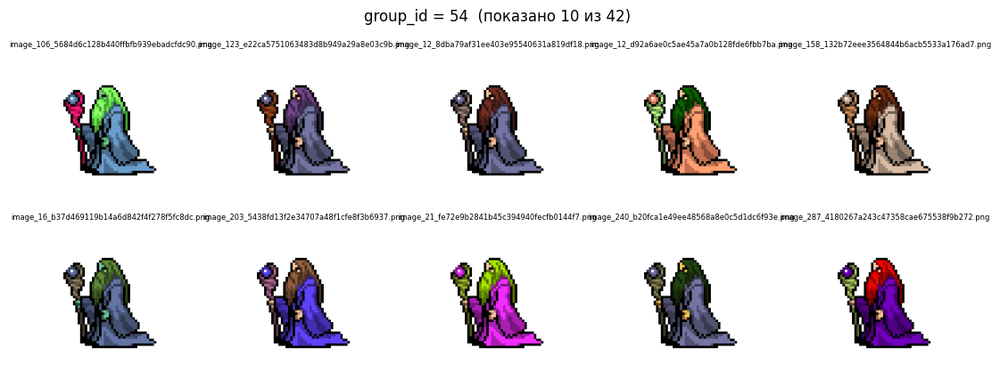

Enter — следующая группа, 'q' — выйти:  


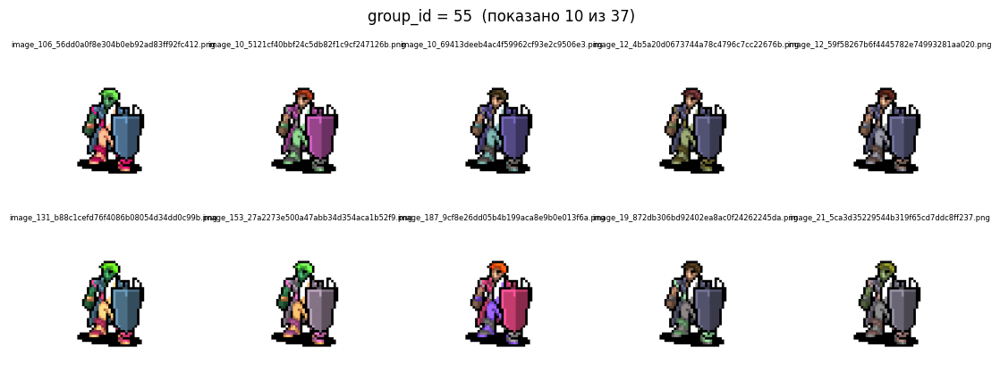

Enter — следующая группа, 'q' — выйти:  


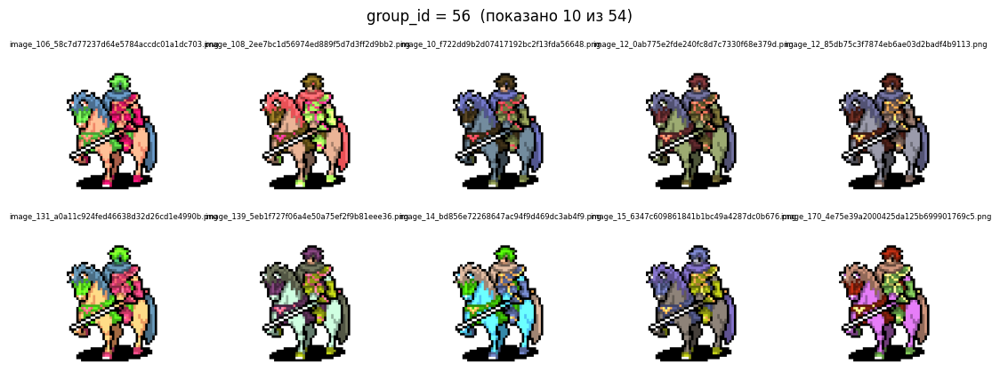

Enter — следующая группа, 'q' — выйти:  


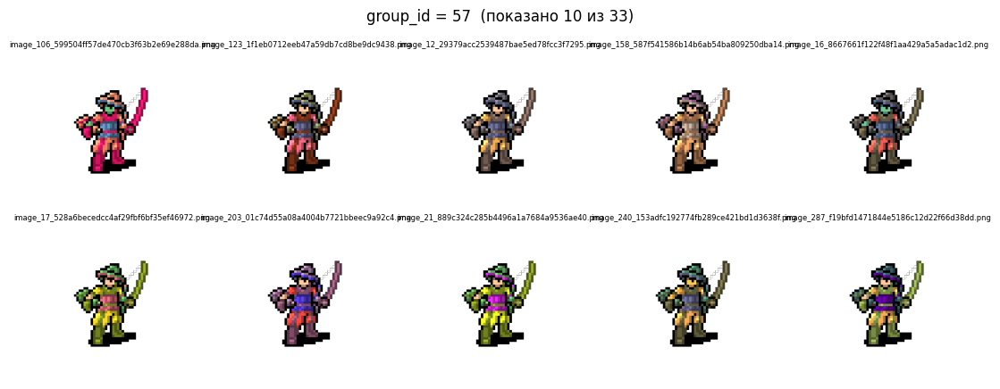

Enter — следующая группа, 'q' — выйти:  


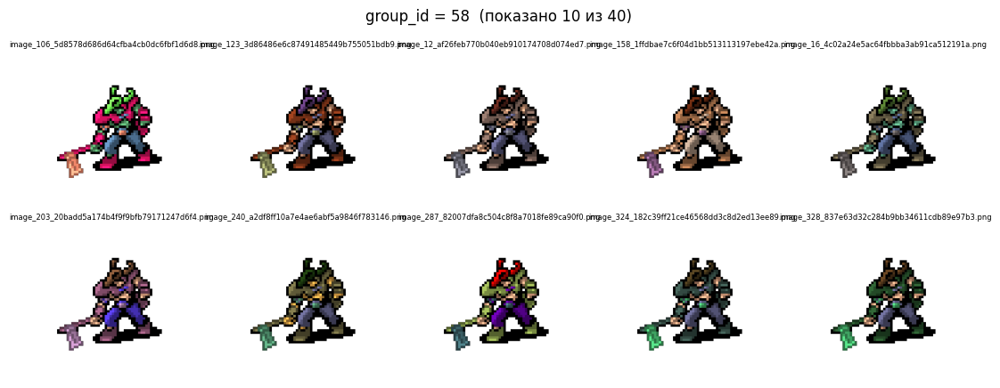

Enter — следующая группа, 'q' — выйти:  


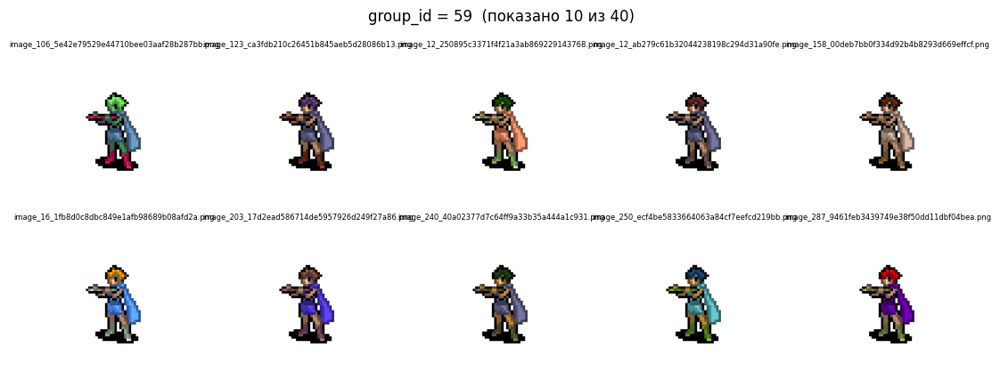

Enter — следующая группа, 'q' — выйти:  


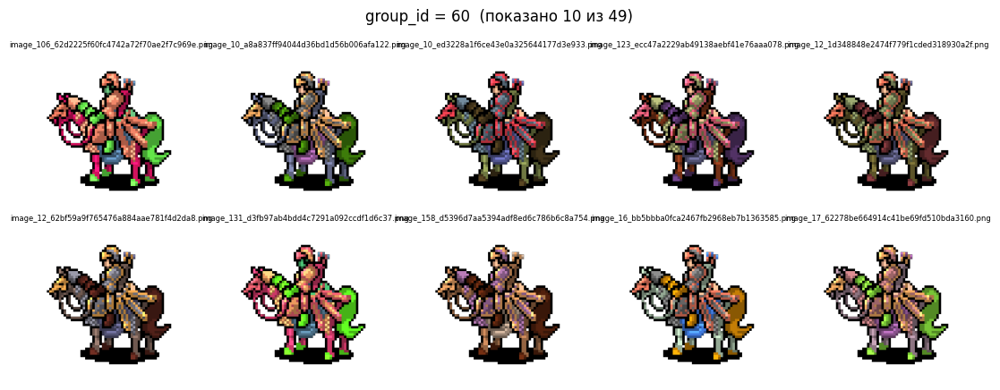

Enter — следующая группа, 'q' — выйти:  


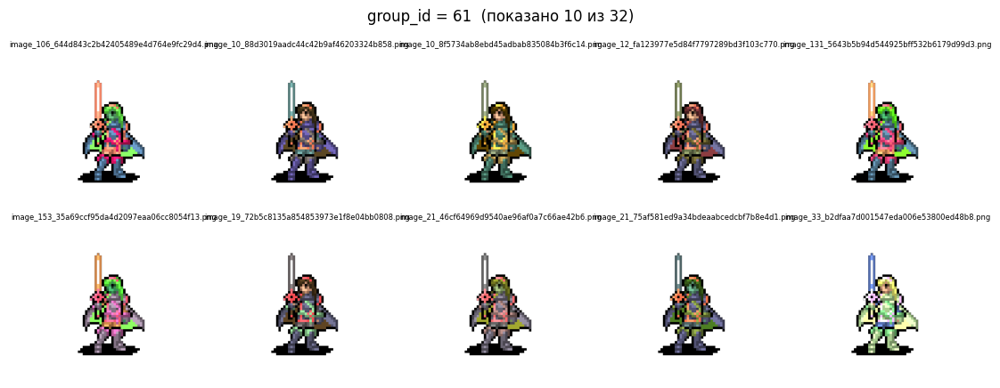

Enter — следующая группа, 'q' — выйти:  


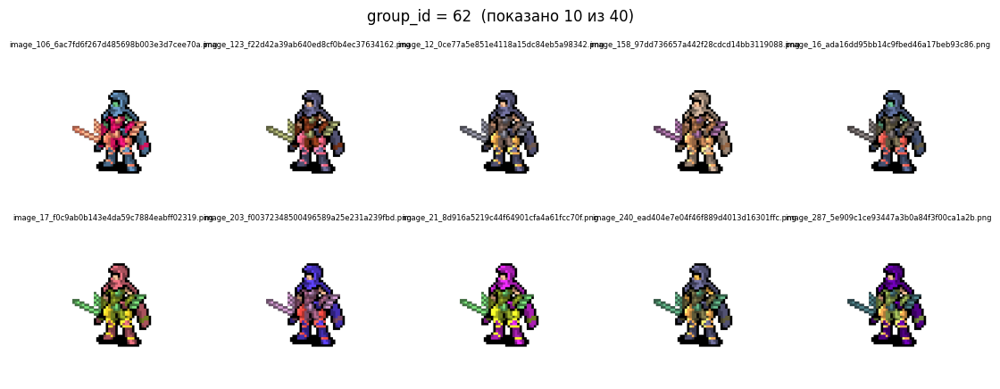

Enter — следующая группа, 'q' — выйти:  


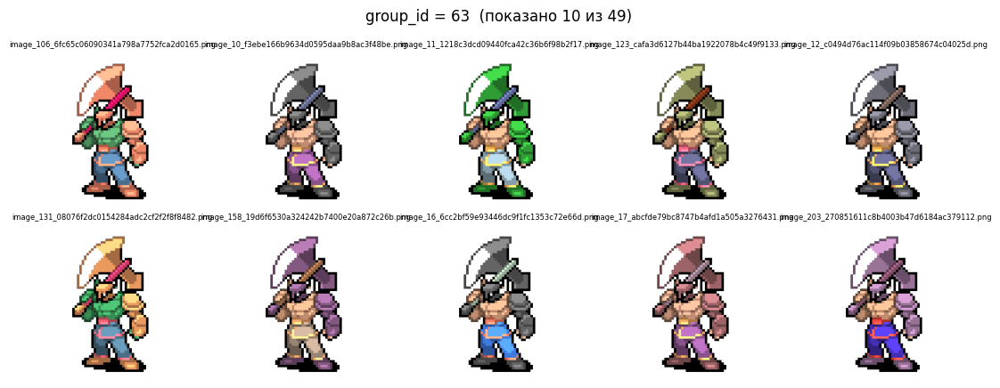

Enter — следующая группа, 'q' — выйти:  


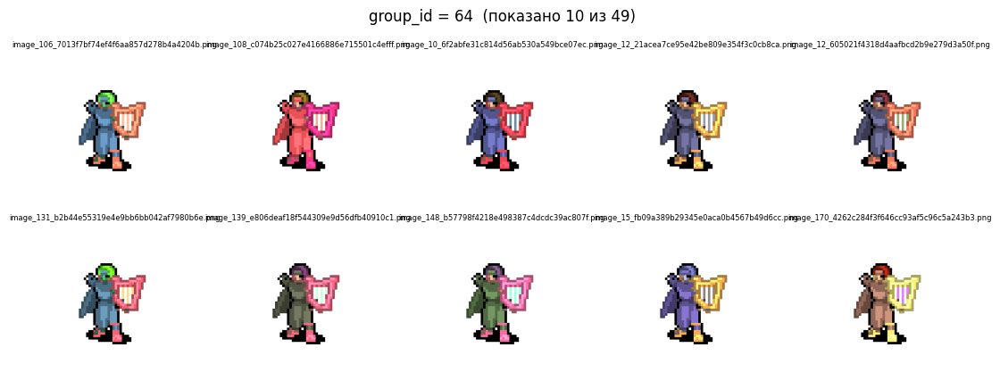

Enter — следующая группа, 'q' — выйти:  


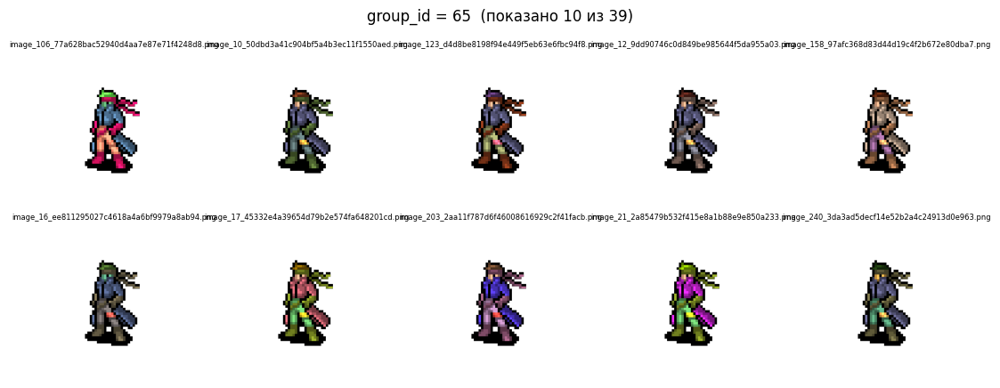

Enter — следующая группа, 'q' — выйти:  


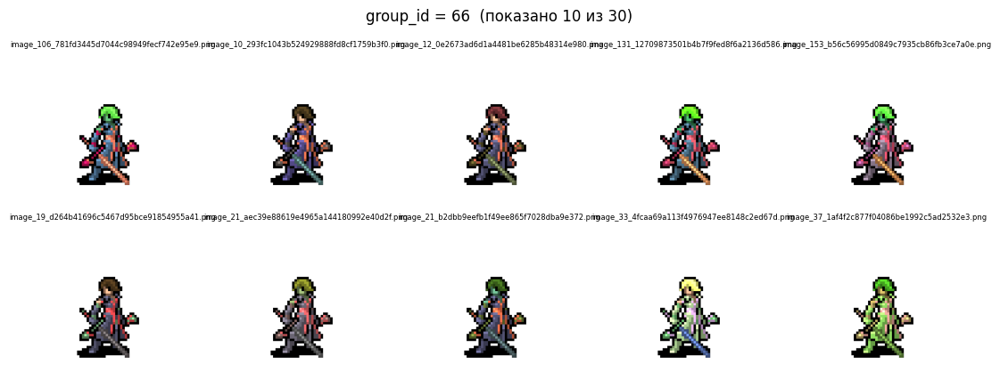

Enter — следующая группа, 'q' — выйти:  


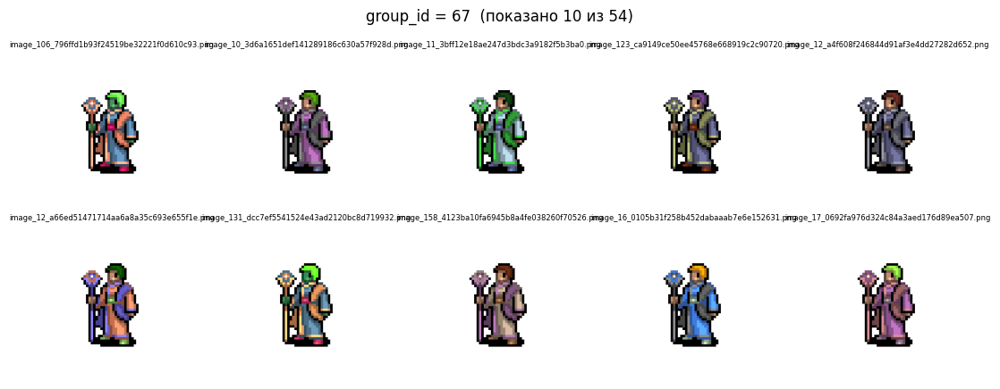

Enter — следующая группа, 'q' — выйти:  


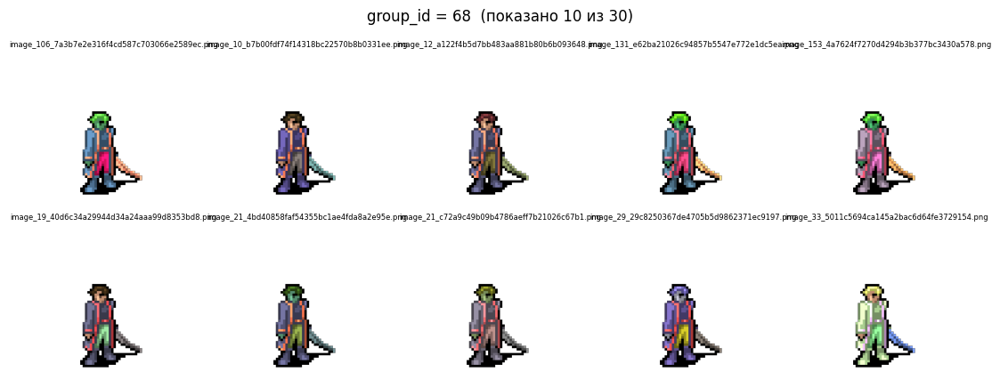

Enter — следующая группа, 'q' — выйти:  


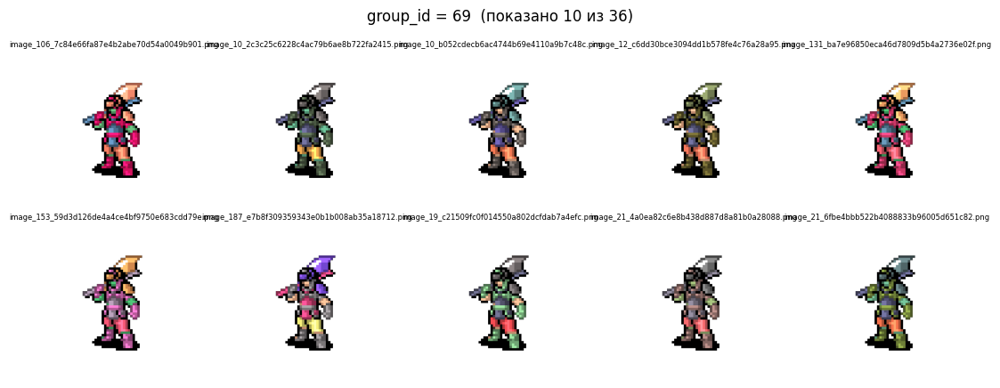

Enter — следующая группа, 'q' — выйти:  


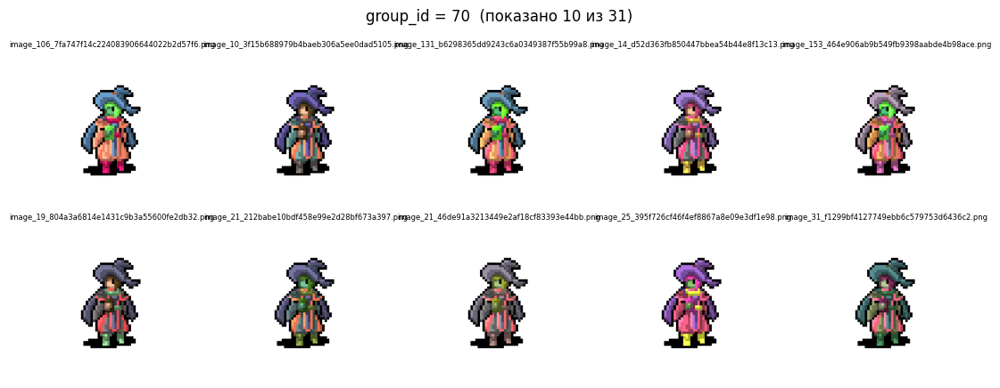

Enter — следующая группа, 'q' — выйти:  


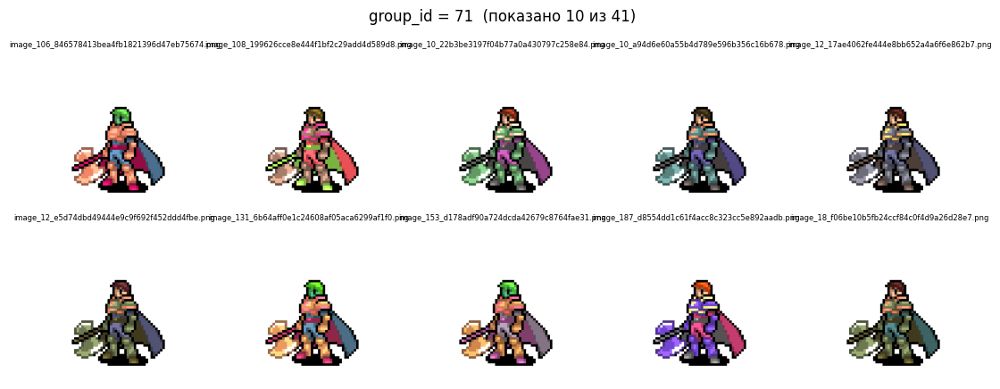

Enter — следующая группа, 'q' — выйти:  


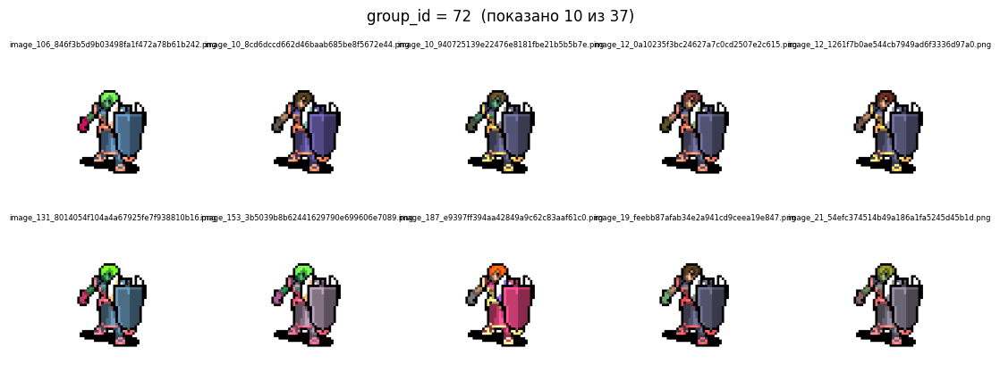

Enter — следующая группа, 'q' — выйти:  


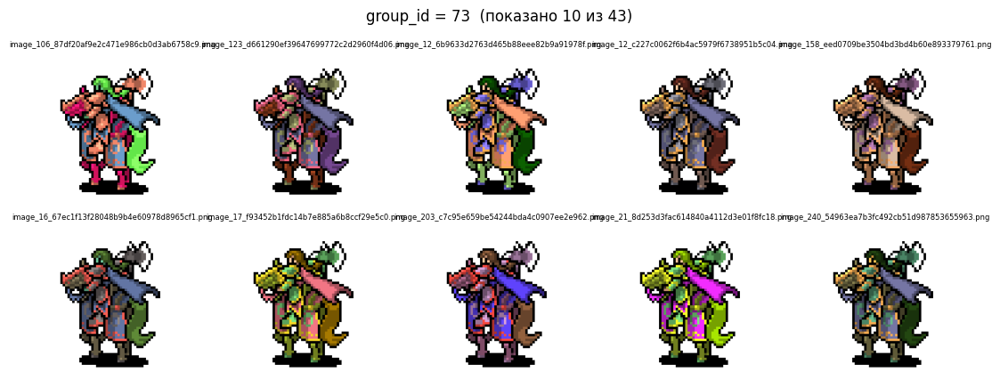

Enter — следующая группа, 'q' — выйти:  


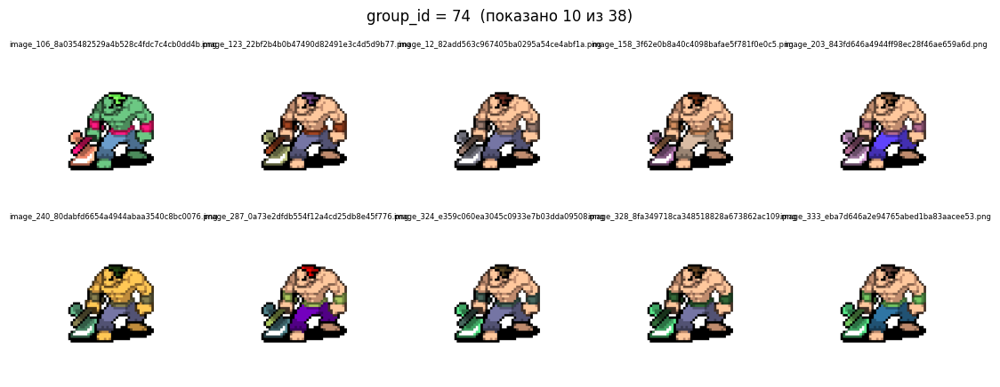

Enter — следующая группа, 'q' — выйти:  


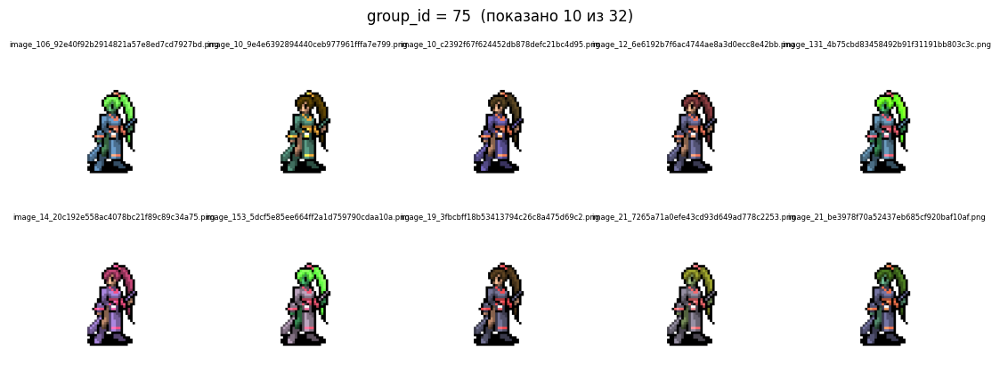

Enter — следующая группа, 'q' — выйти:  


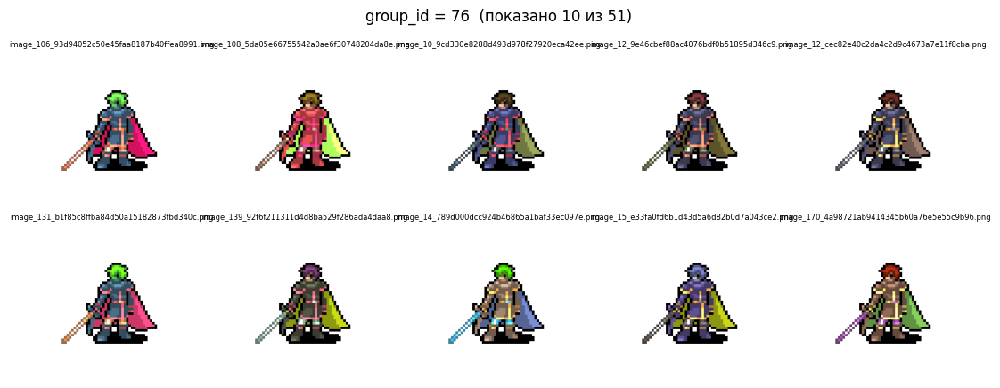

Enter — следующая группа, 'q' — выйти:  


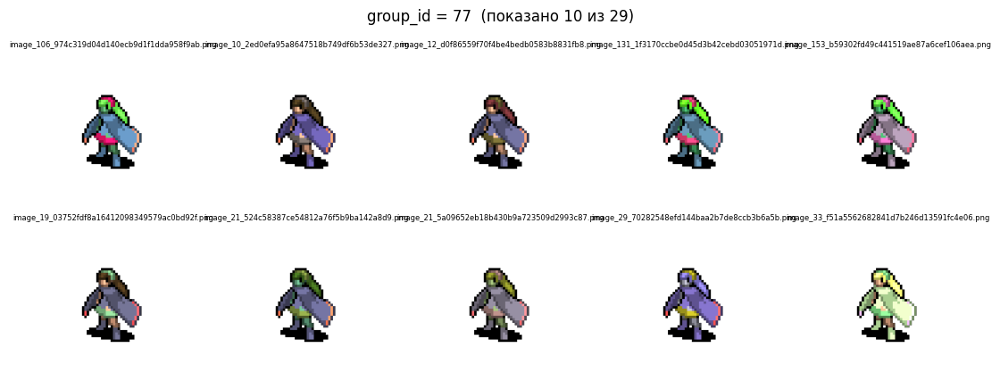

Enter — следующая группа, 'q' — выйти:  


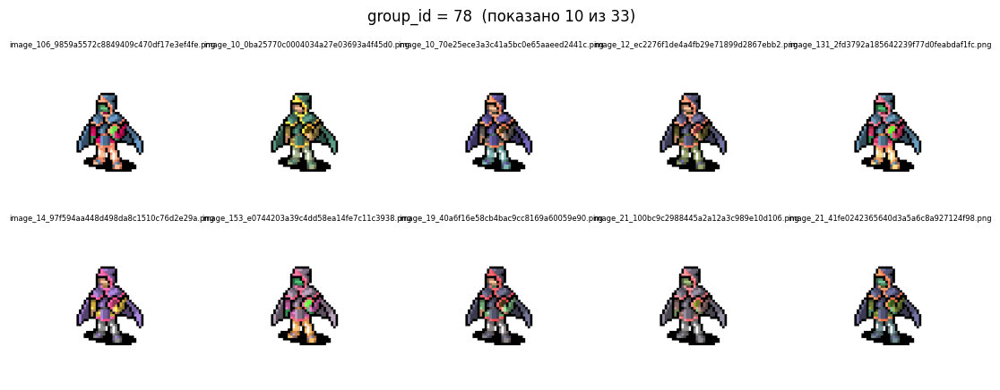

Enter — следующая группа, 'q' — выйти:  


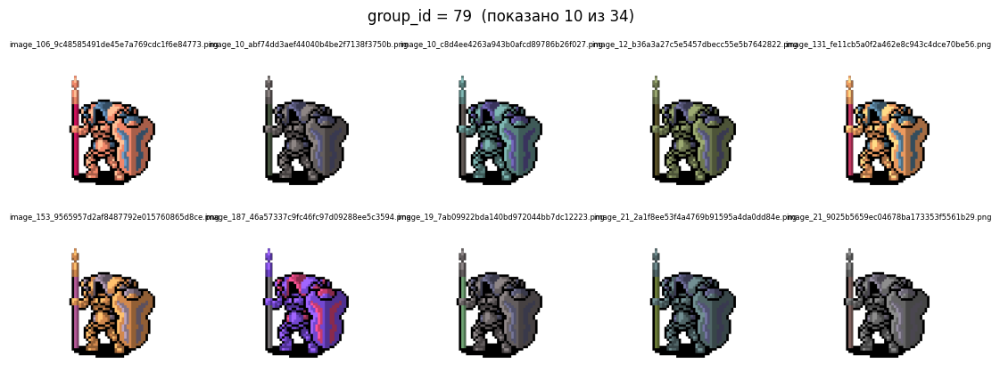

Enter — следующая группа, 'q' — выйти:  


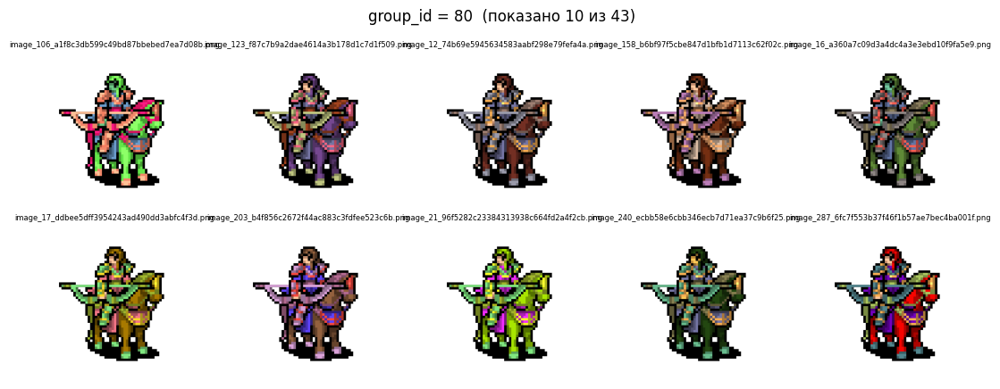

Enter — следующая группа, 'q' — выйти:  


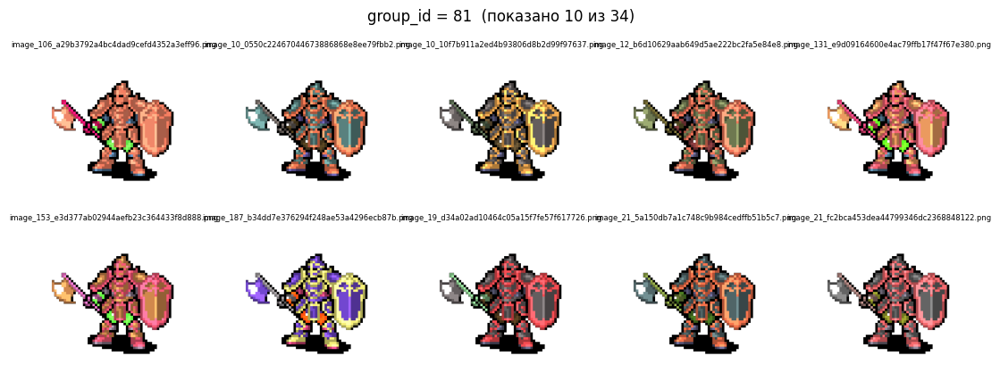

Enter — следующая группа, 'q' — выйти:  


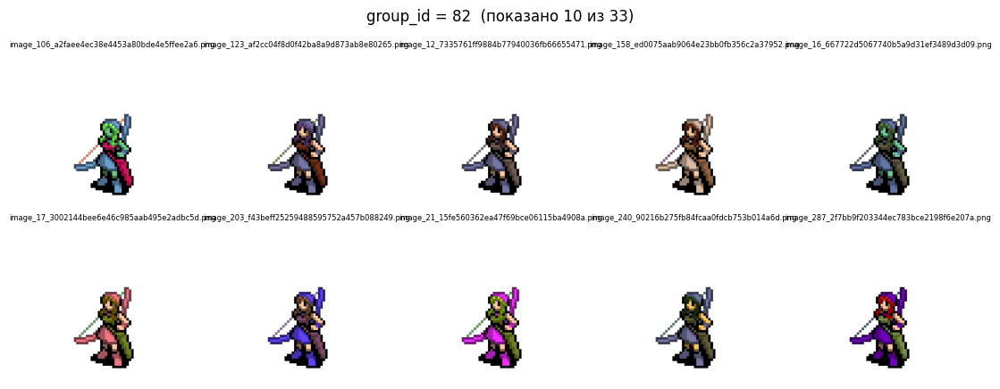

Enter — следующая группа, 'q' — выйти:  


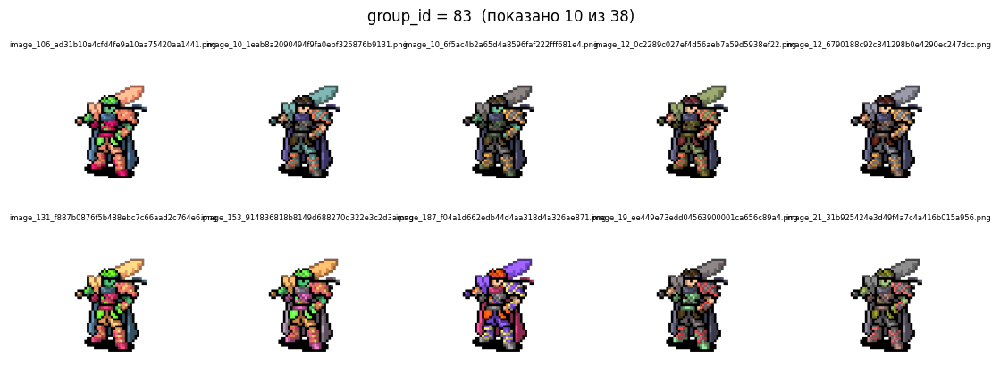

Enter — следующая группа, 'q' — выйти:  


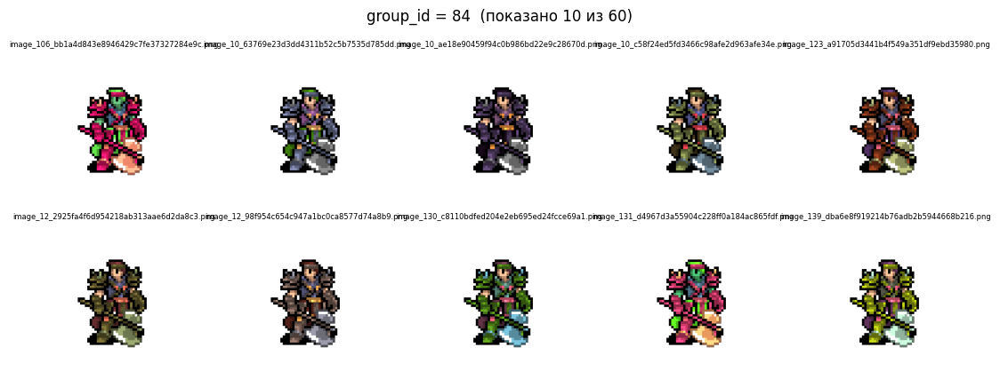

Enter — следующая группа, 'q' — выйти:  


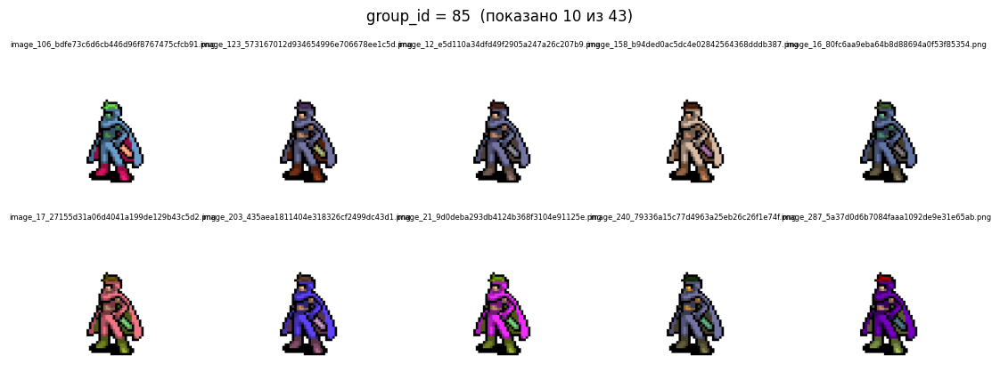

Enter — следующая группа, 'q' — выйти:  


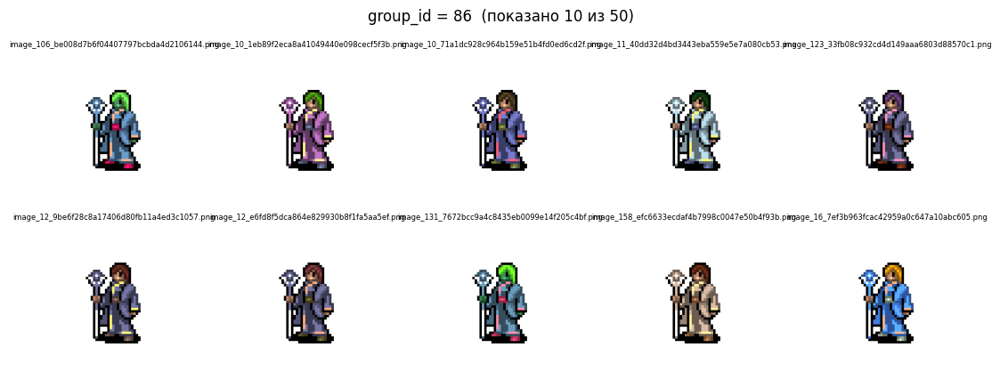

Enter — следующая группа, 'q' — выйти:  


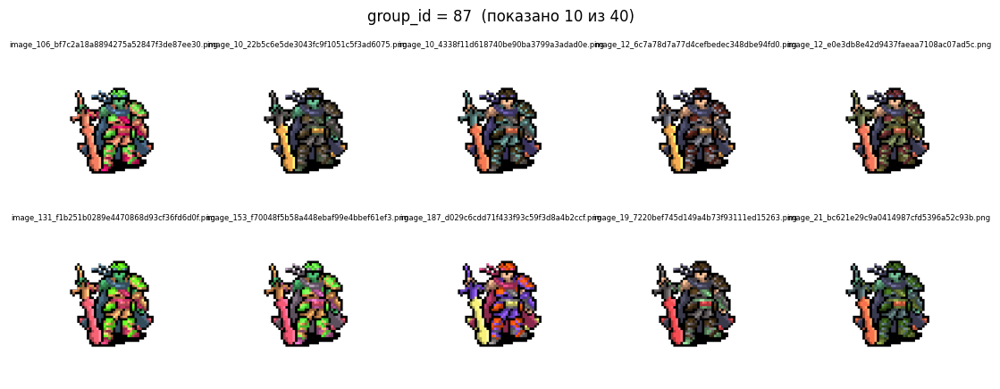

Enter — следующая группа, 'q' — выйти:  


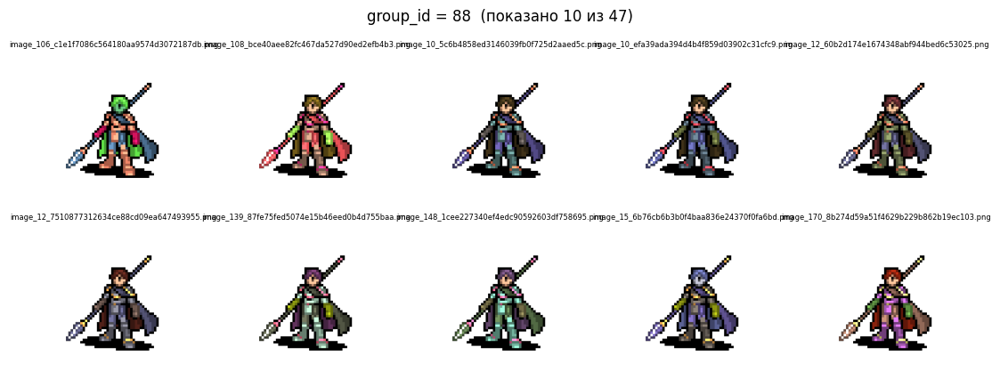

Enter — следующая группа, 'q' — выйти:  


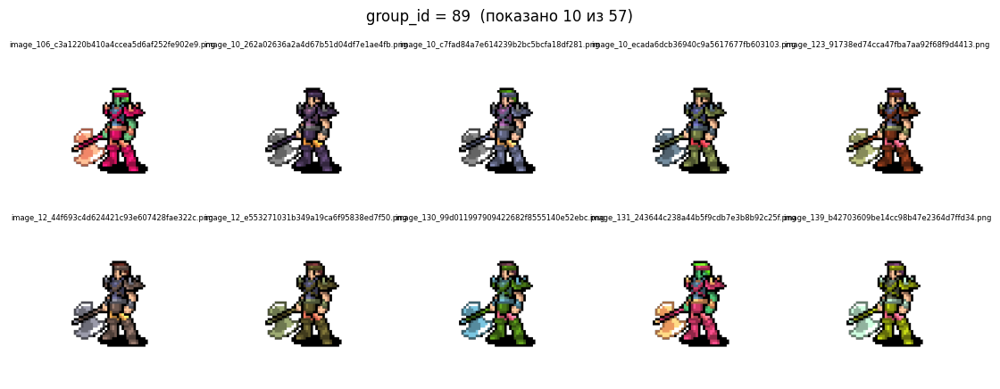

Enter — следующая группа, 'q' — выйти:  


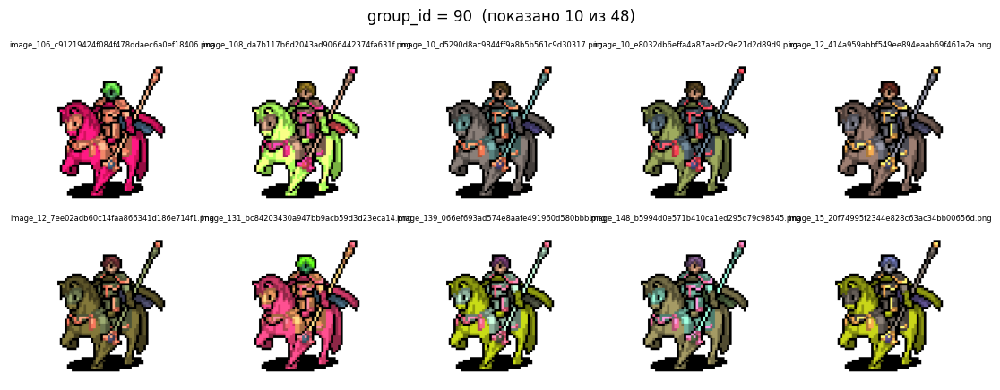

Enter — следующая группа, 'q' — выйти:  


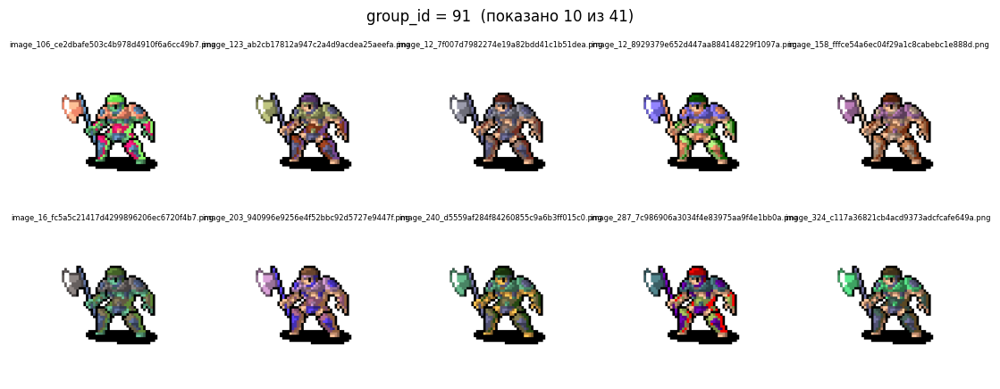

Enter — следующая группа, 'q' — выйти:  


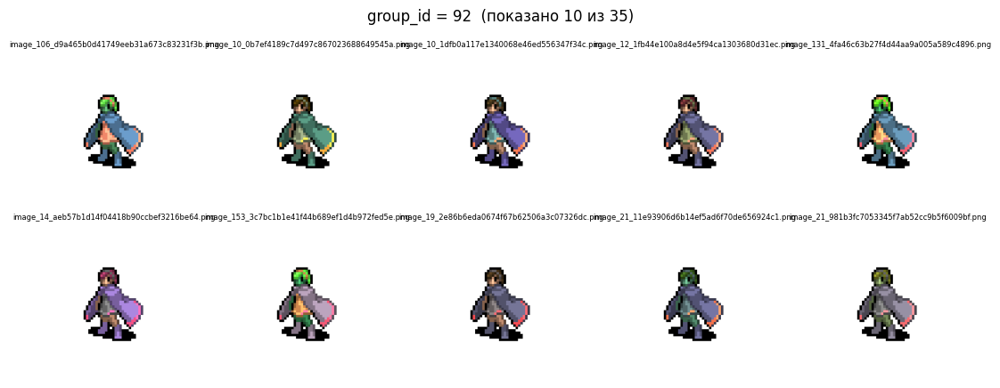

Enter — следующая группа, 'q' — выйти:  


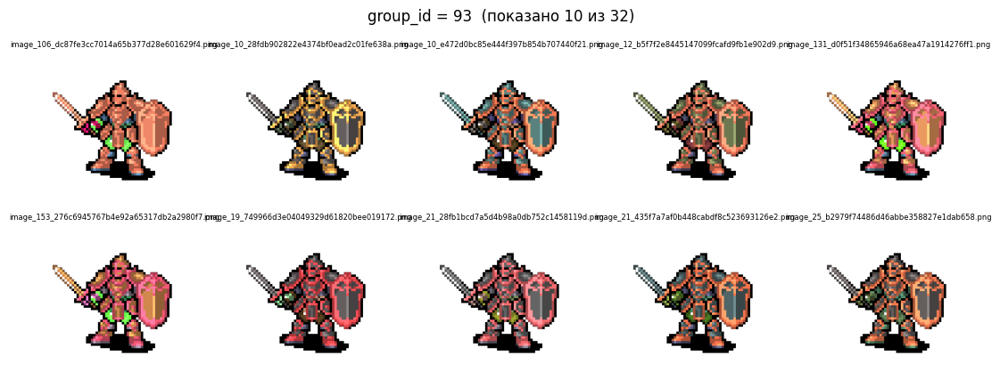

Enter — следующая группа, 'q' — выйти:  


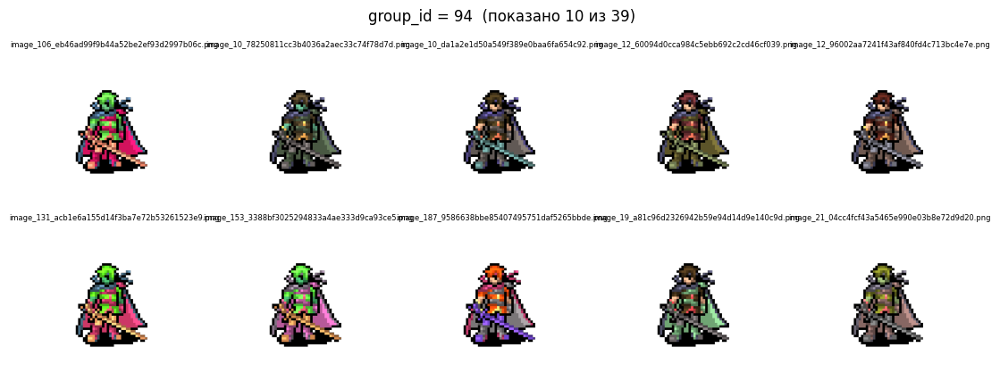

Enter — следующая группа, 'q' — выйти:  


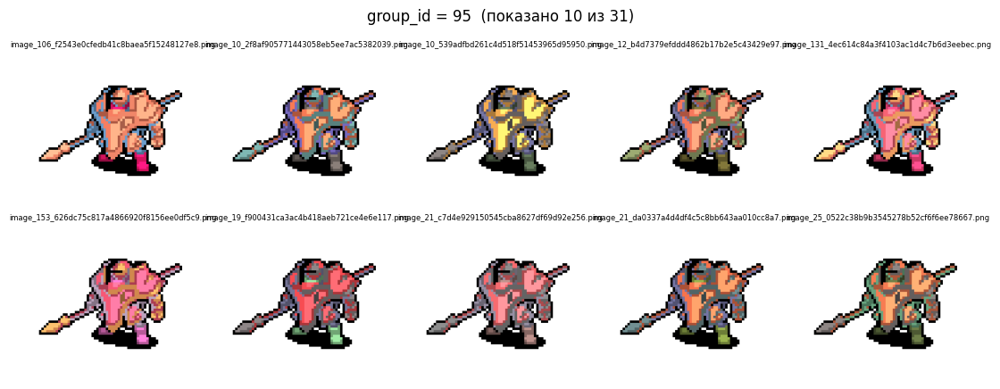

Enter — следующая группа, 'q' — выйти:  


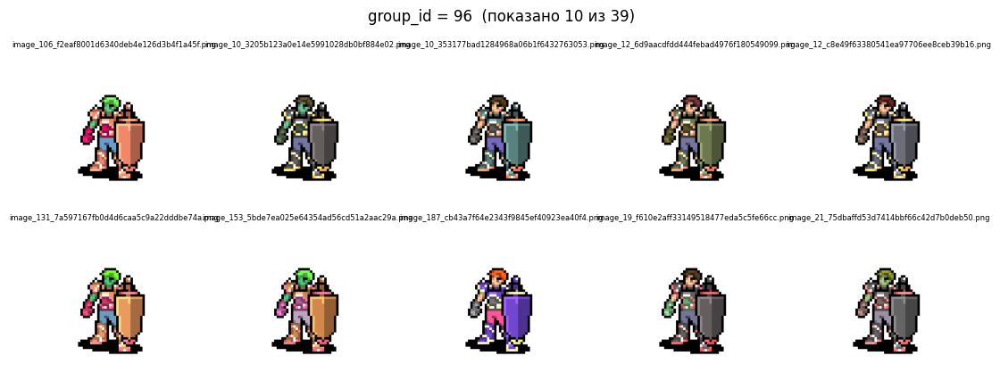

Enter — следующая группа, 'q' — выйти:  


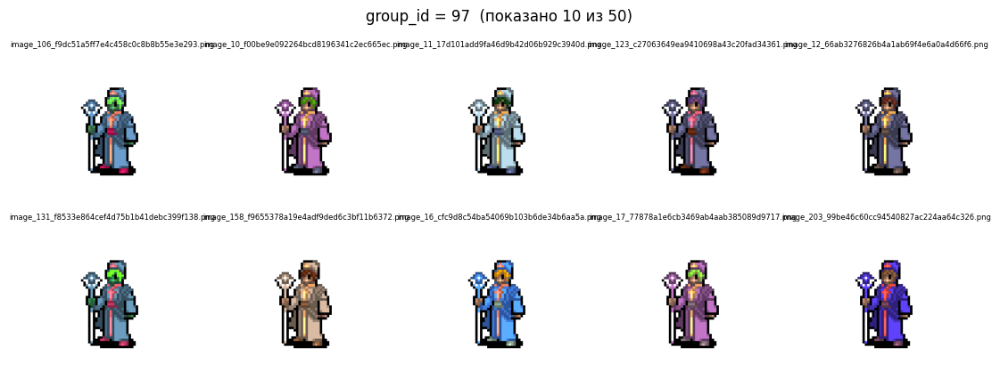

Enter — следующая группа, 'q' — выйти:  


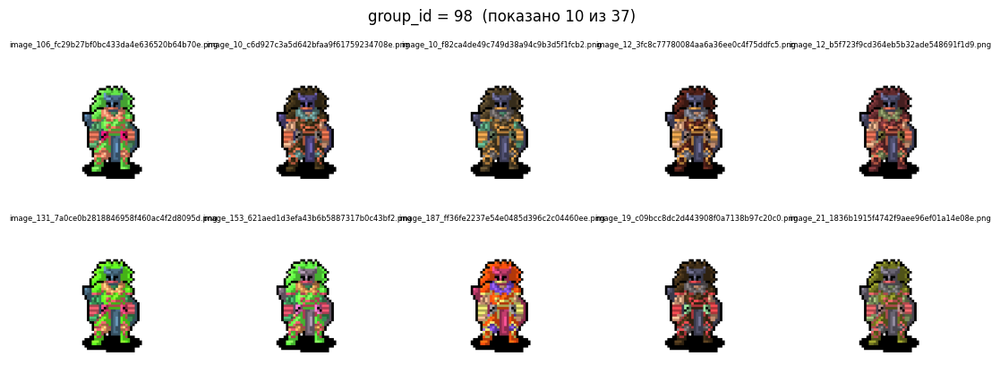

Enter — следующая группа, 'q' — выйти:  


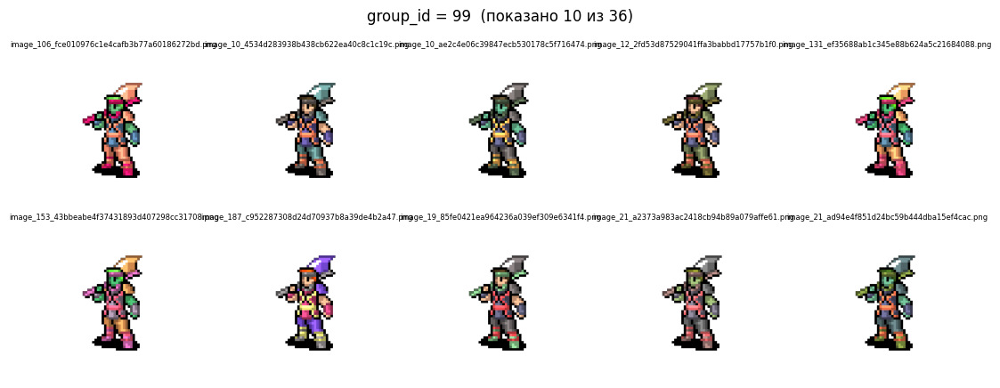

Enter — следующая группа, 'q' — выйти:  


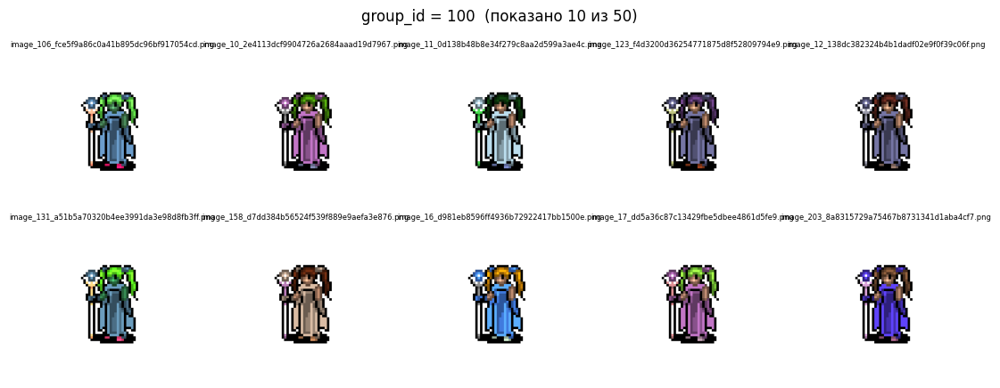

Enter — следующая группа, 'q' — выйти:  


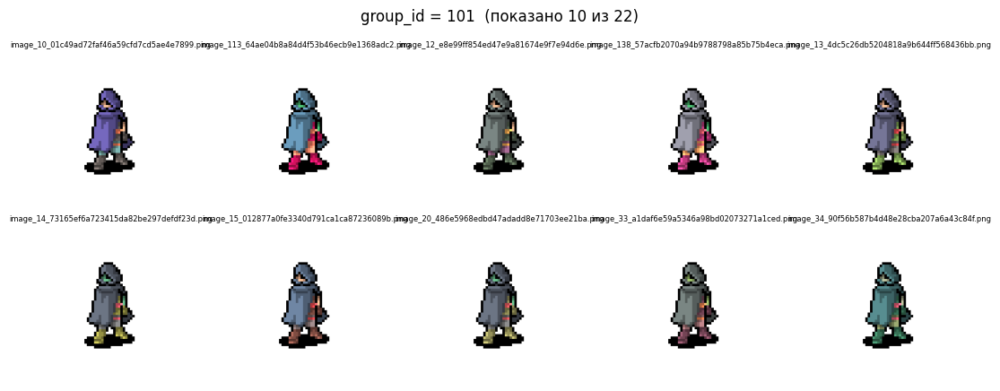

Enter — следующая группа, 'q' — выйти:  


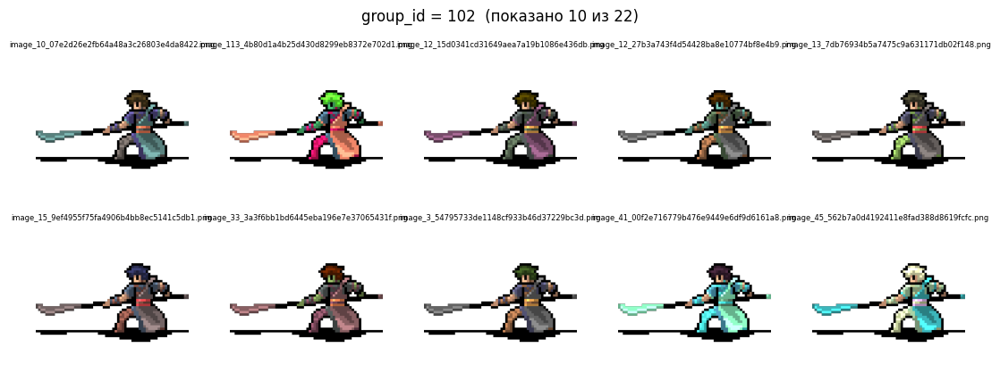

Enter — следующая группа, 'q' — выйти:  


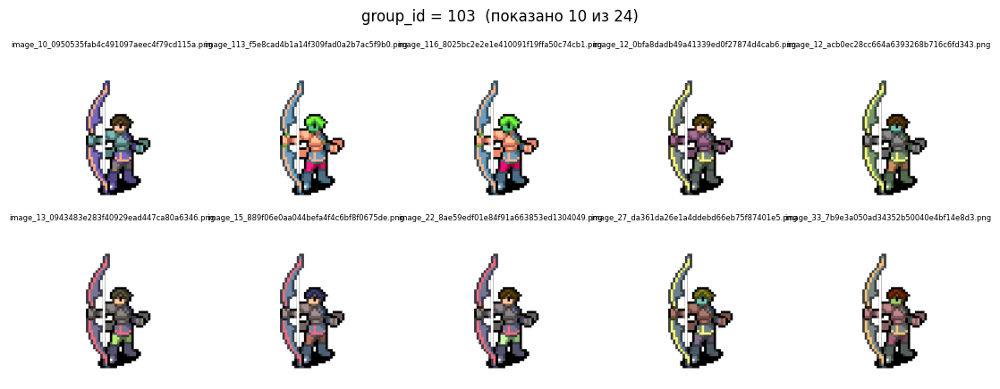

Enter — следующая группа, 'q' — выйти:  


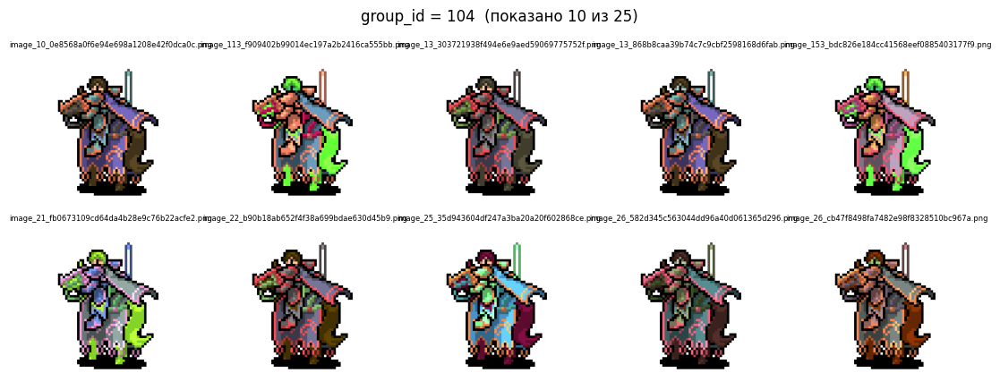

Enter — следующая группа, 'q' — выйти:  


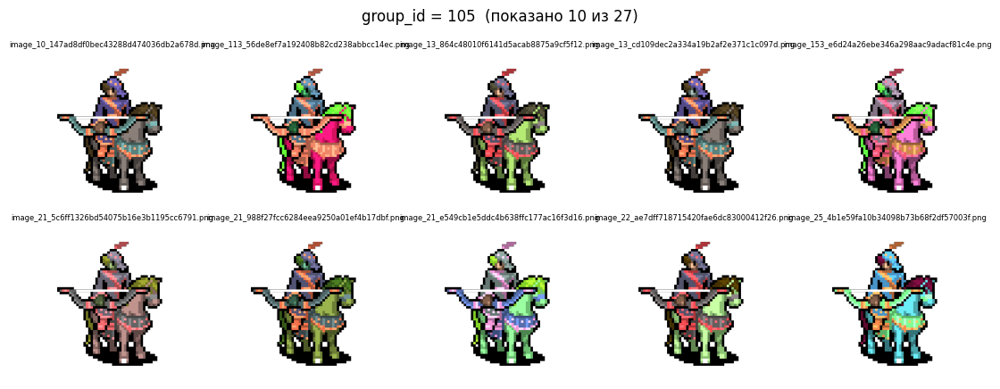

Enter — следующая группа, 'q' — выйти:  


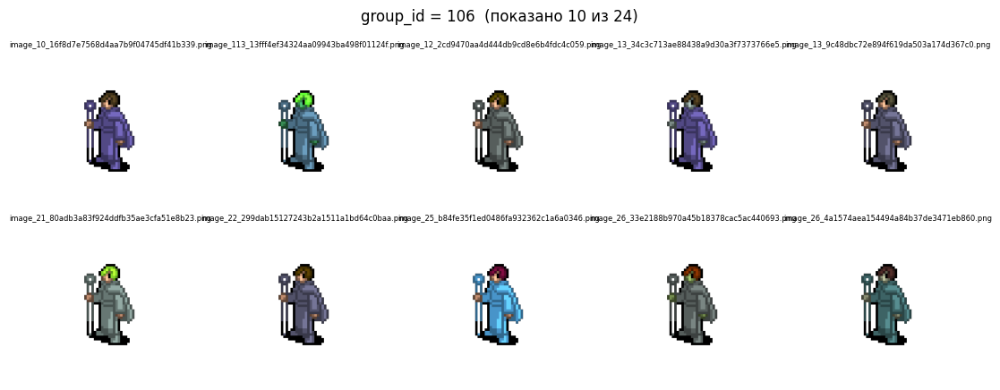

Enter — следующая группа, 'q' — выйти:  


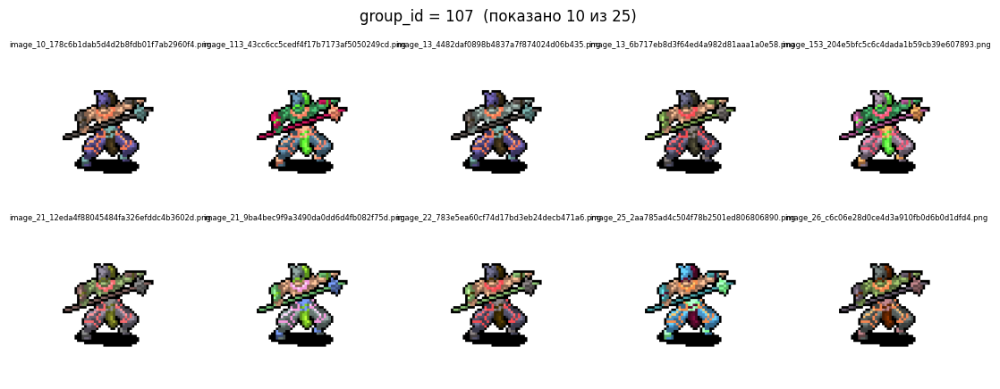

Enter — следующая группа, 'q' — выйти:  


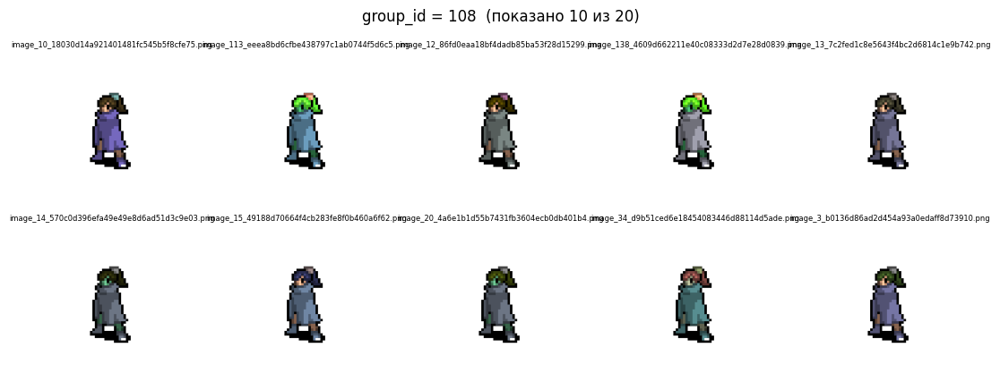

Enter — следующая группа, 'q' — выйти:  


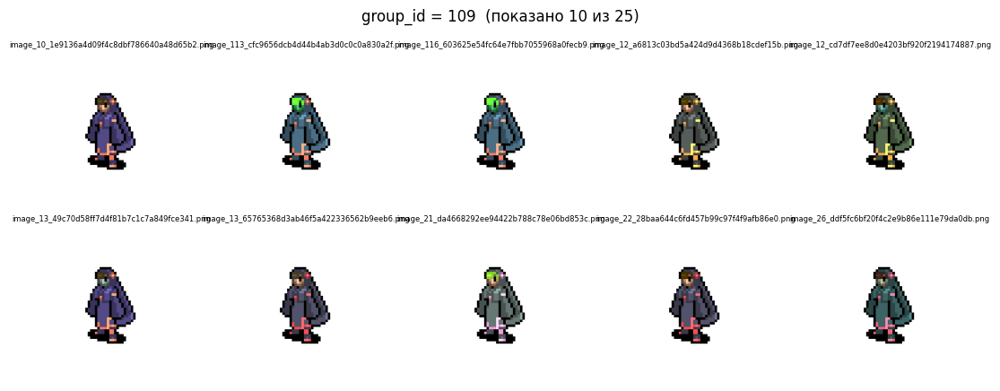

Enter — следующая группа, 'q' — выйти:  


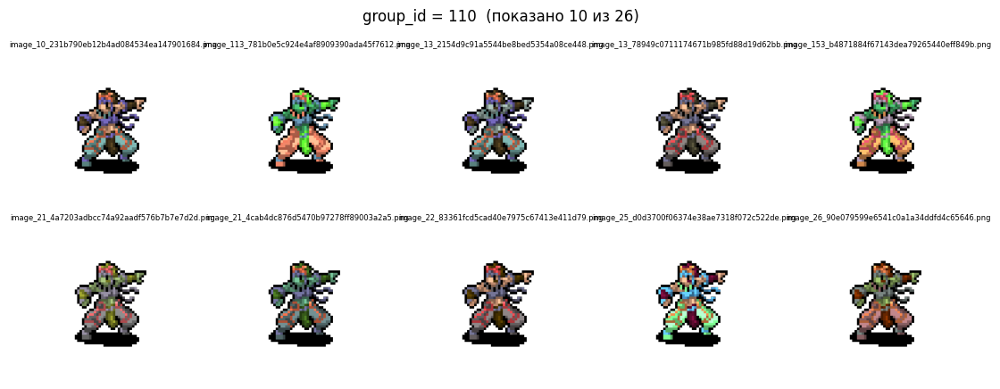

Enter — следующая группа, 'q' — выйти:  


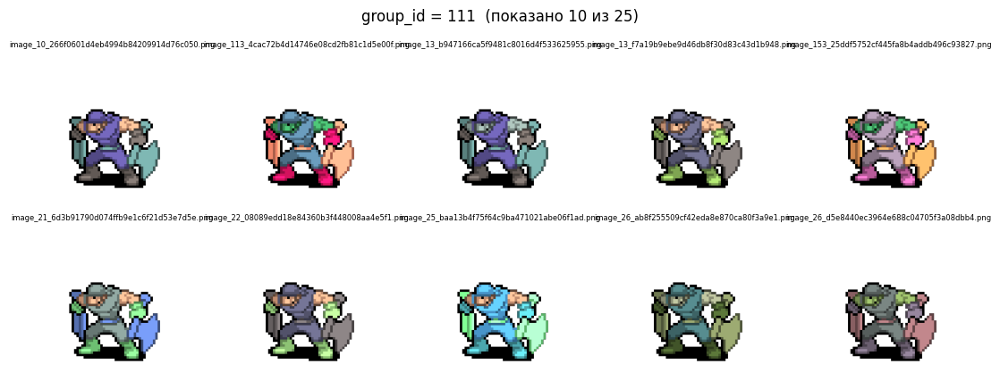

Enter — следующая группа, 'q' — выйти:  


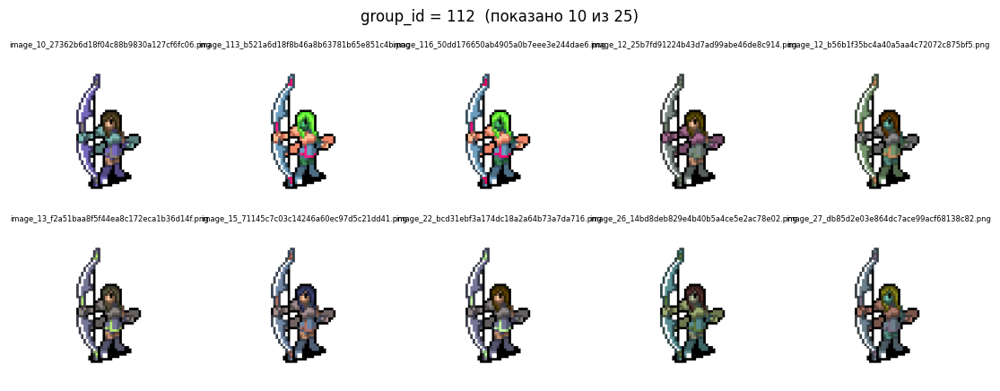

Enter — следующая группа, 'q' — выйти:  


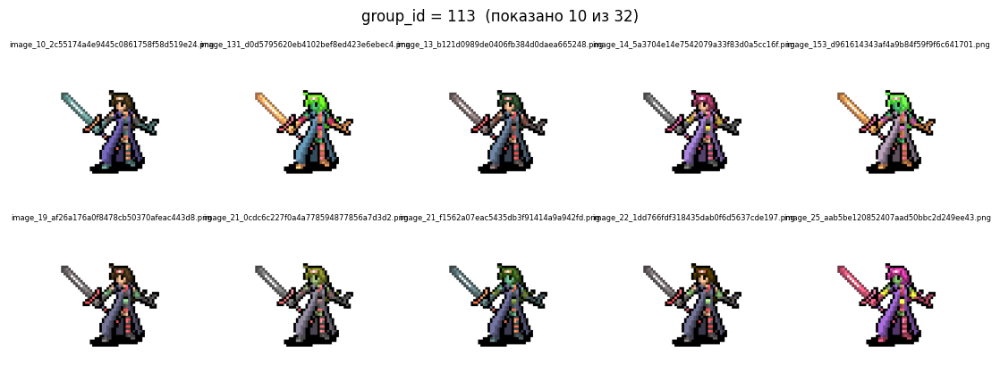

Enter — следующая группа, 'q' — выйти:  


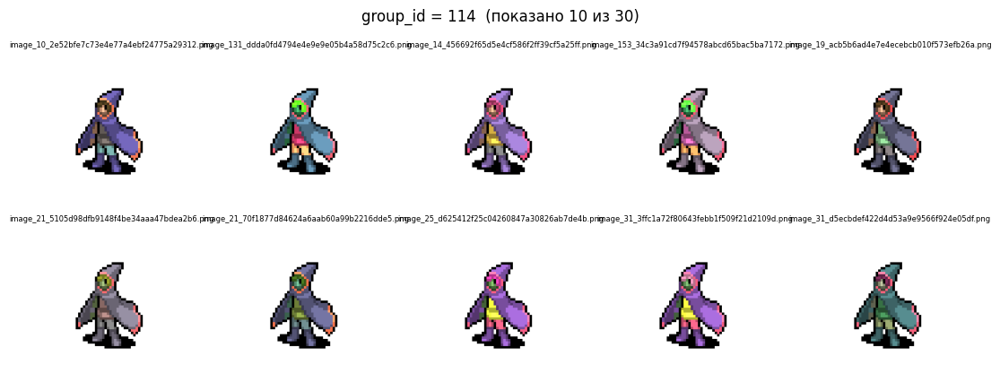

Enter — следующая группа, 'q' — выйти:  


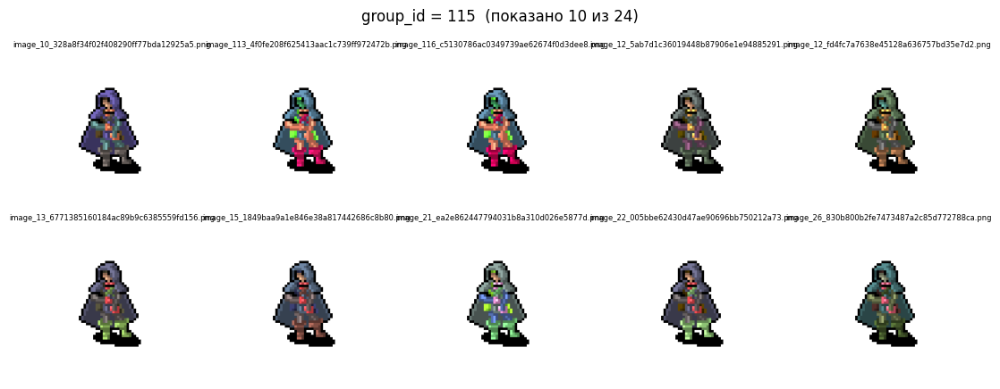

Enter — следующая группа, 'q' — выйти:  


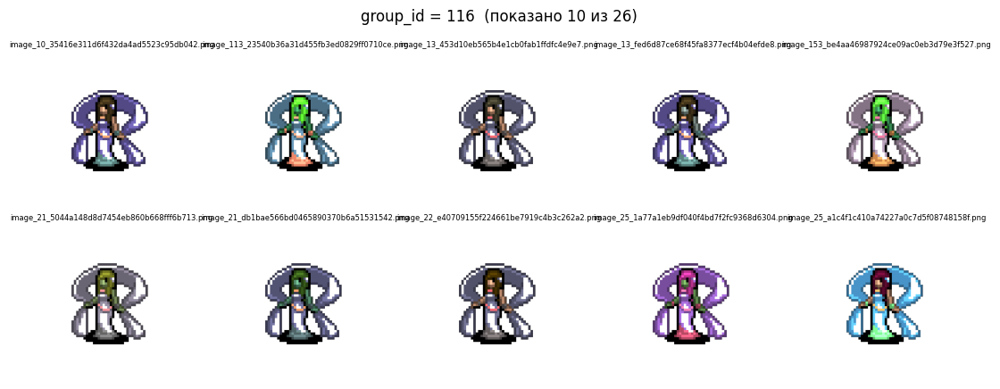

Enter — следующая группа, 'q' — выйти:  


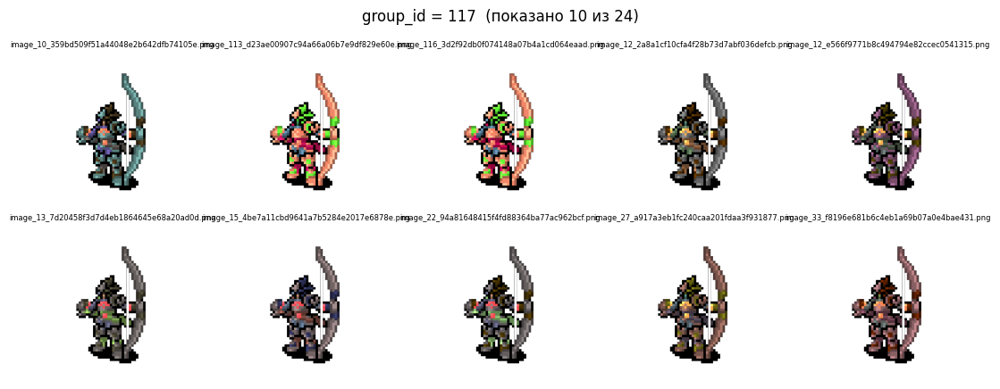

Enter — следующая группа, 'q' — выйти:  


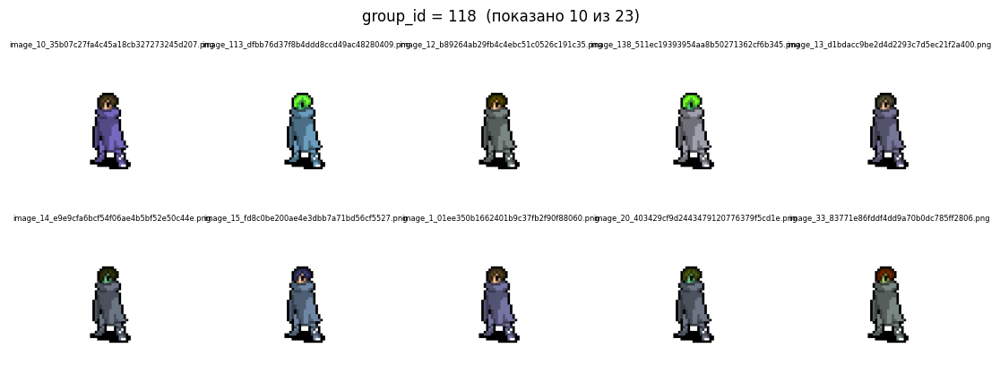

Enter — следующая группа, 'q' — выйти:  


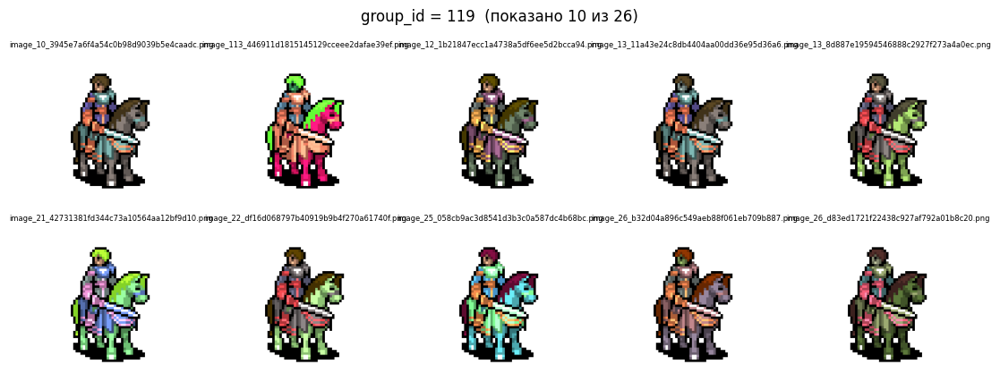

Enter — следующая группа, 'q' — выйти:  


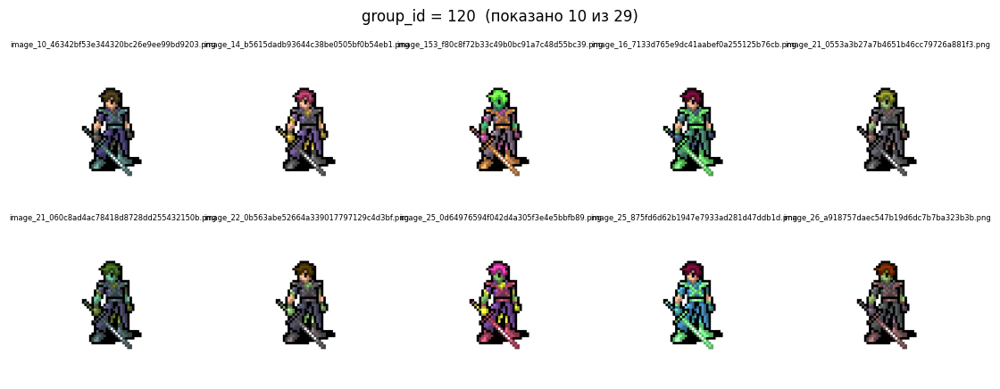

Enter — следующая группа, 'q' — выйти:  


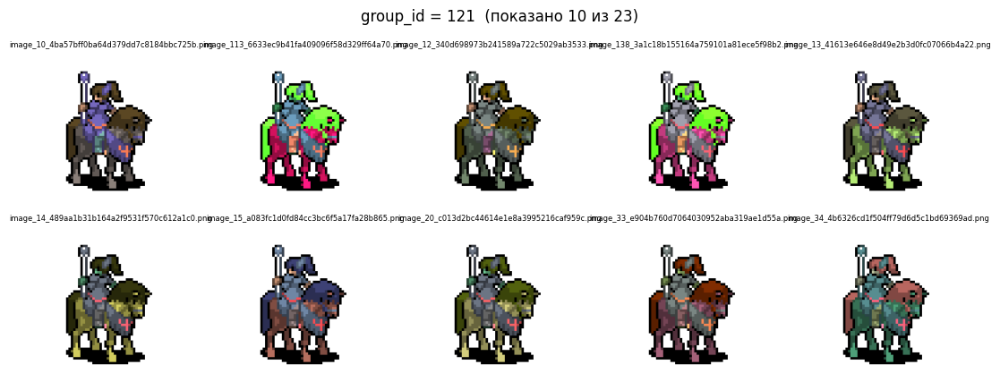

Enter — следующая группа, 'q' — выйти:  


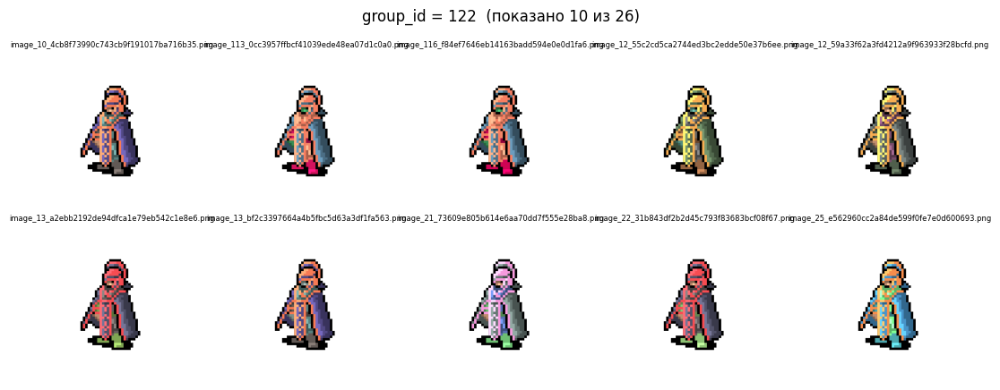

Enter — следующая группа, 'q' — выйти:  


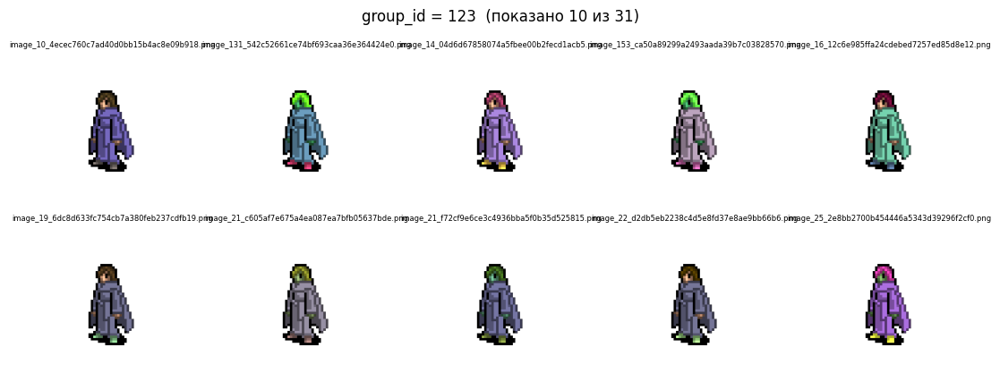

Enter — следующая группа, 'q' — выйти:  


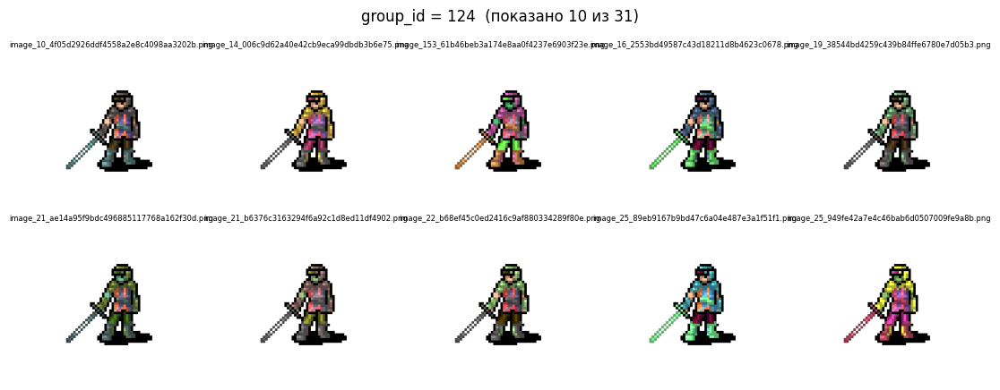

Enter — следующая группа, 'q' — выйти:  


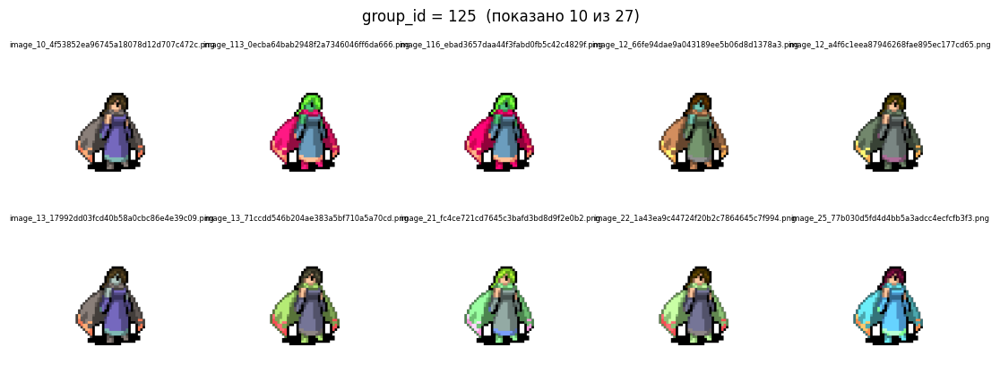

Enter — следующая группа, 'q' — выйти:  


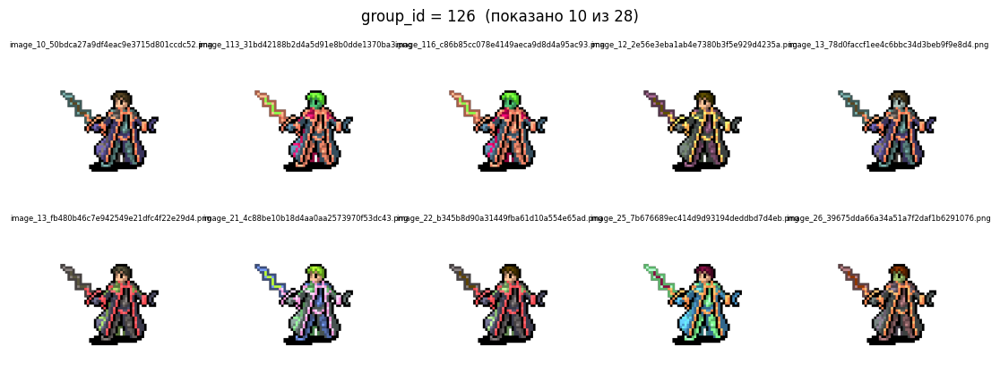

Enter — следующая группа, 'q' — выйти:  


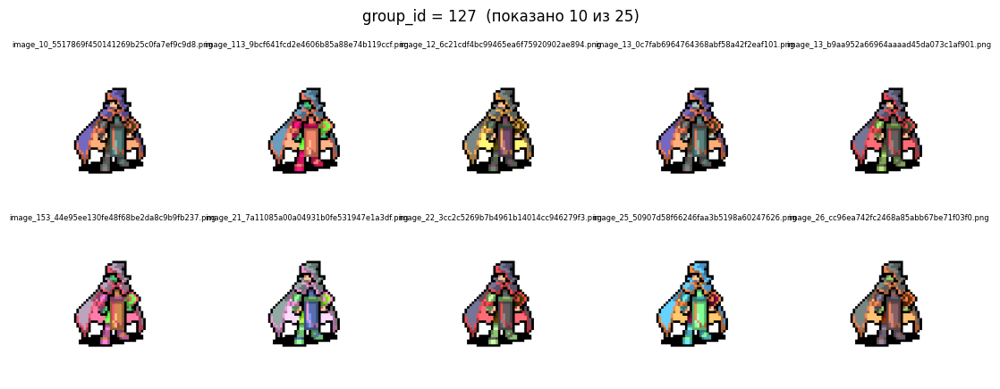

Enter — следующая группа, 'q' — выйти:  


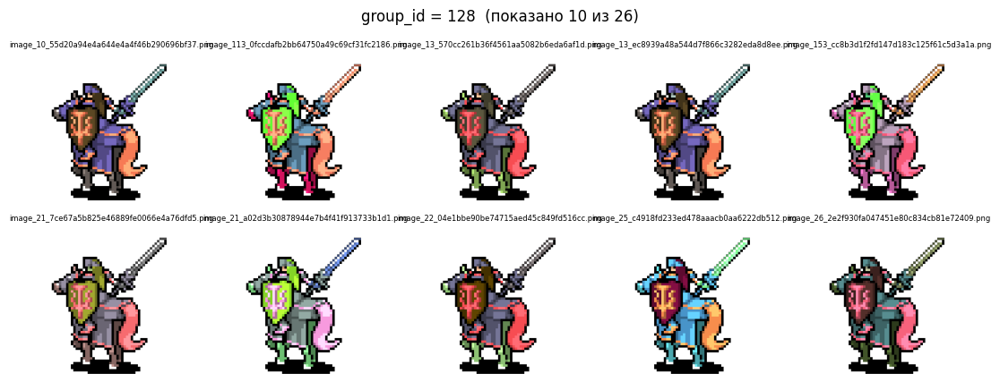

Enter — следующая группа, 'q' — выйти:  


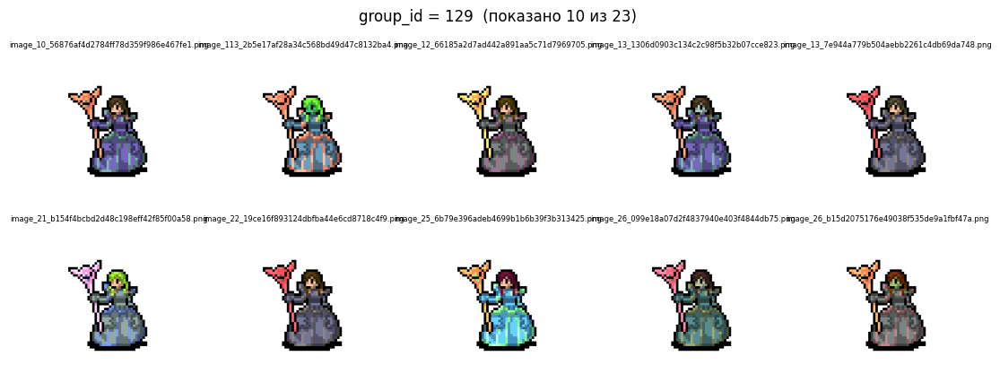

Enter — следующая группа, 'q' — выйти:  


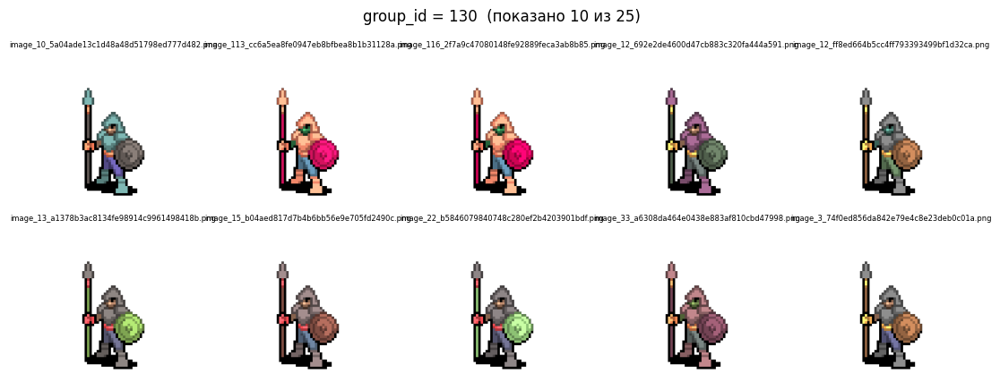

Enter — следующая группа, 'q' — выйти:  


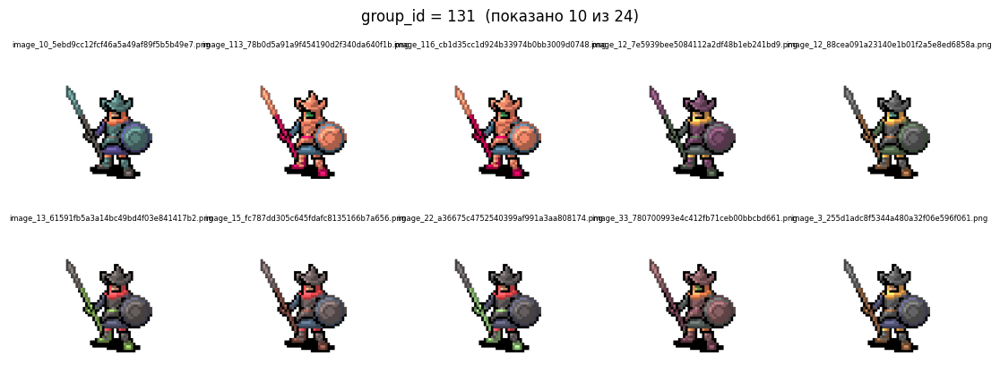

Enter — следующая группа, 'q' — выйти:  


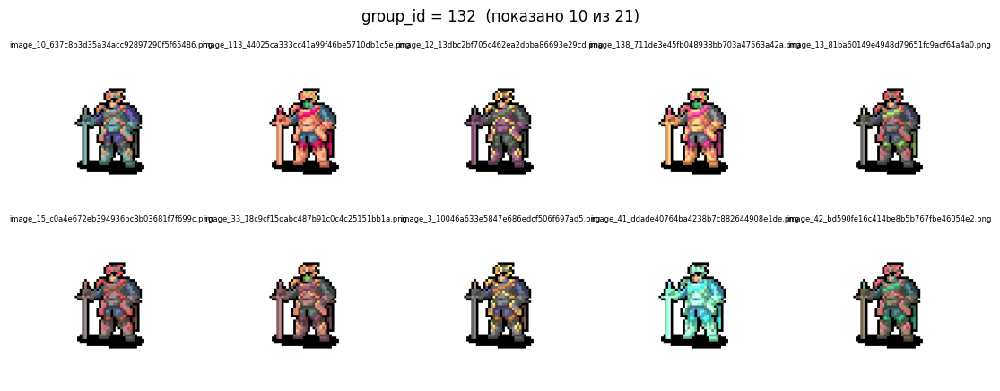

Enter — следующая группа, 'q' — выйти:  


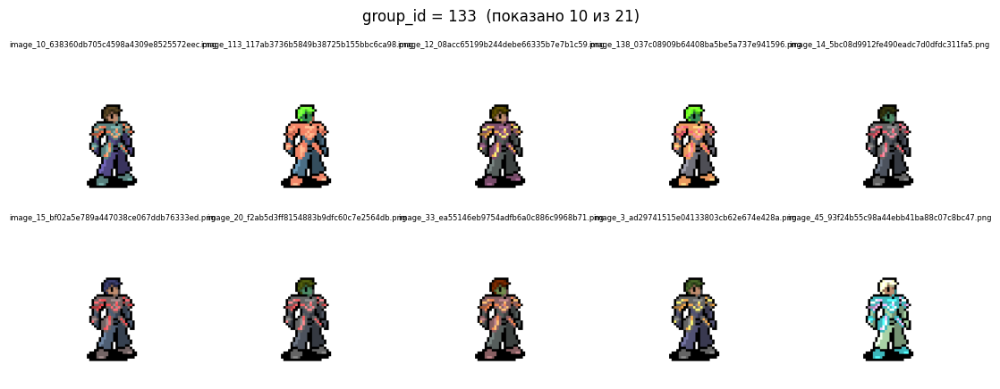

Enter — следующая группа, 'q' — выйти:  


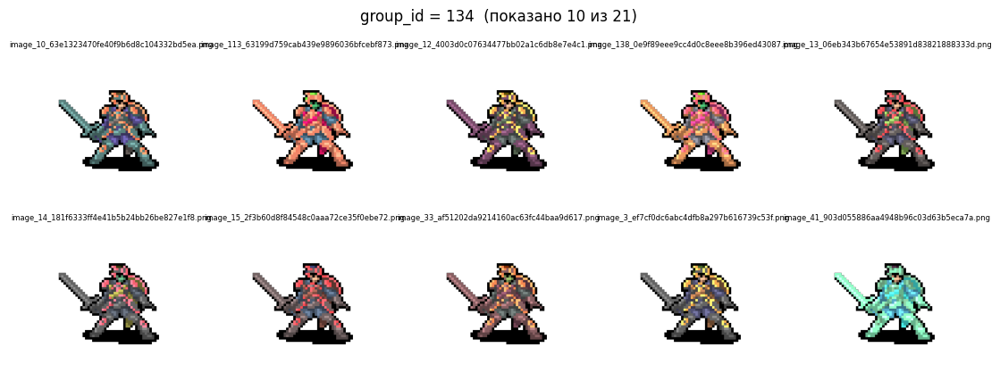

Enter — следующая группа, 'q' — выйти:  


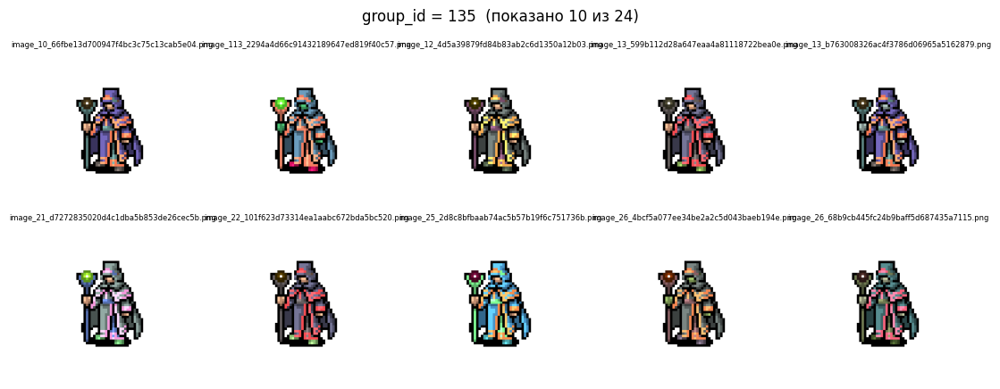

Enter — следующая группа, 'q' — выйти:  


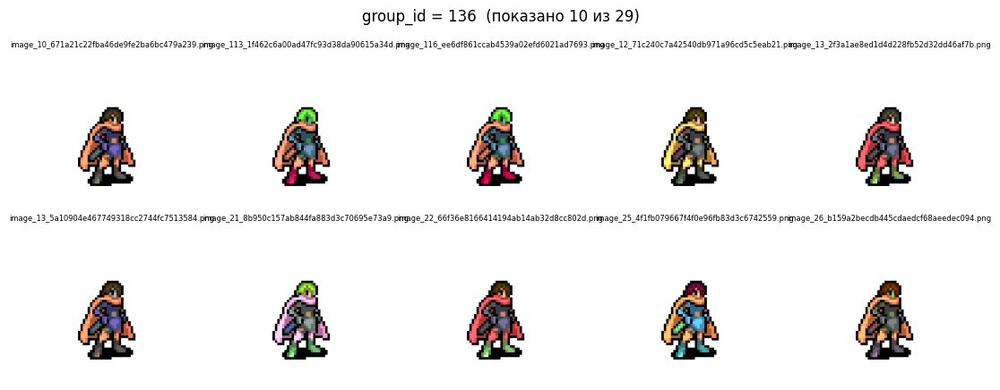

Enter — следующая группа, 'q' — выйти:  


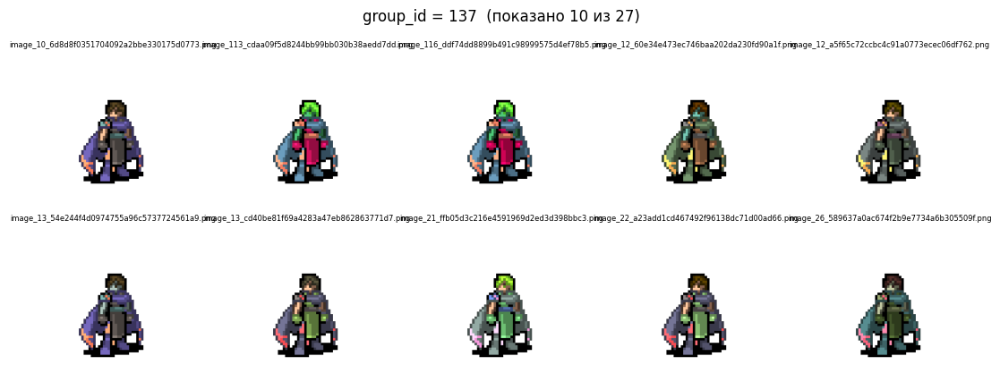

Enter — следующая группа, 'q' — выйти:  


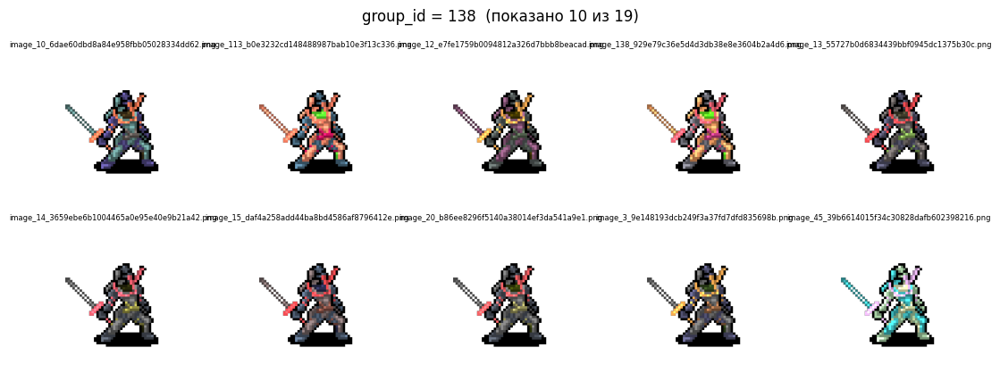

Enter — следующая группа, 'q' — выйти:  


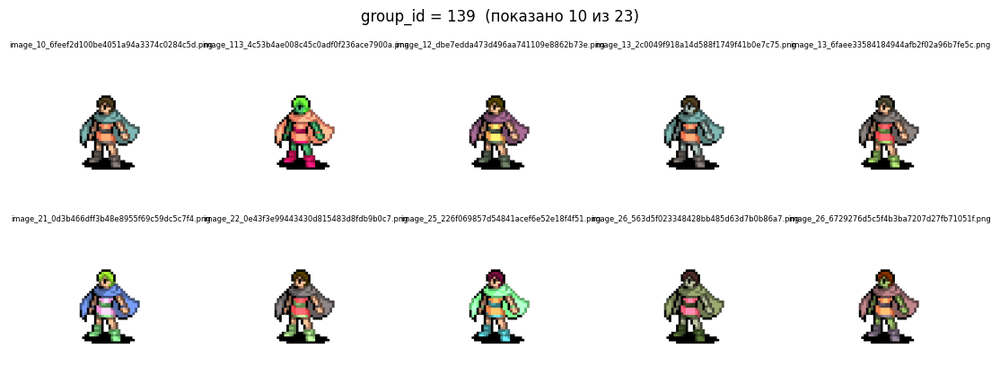

Enter — следующая группа, 'q' — выйти:  


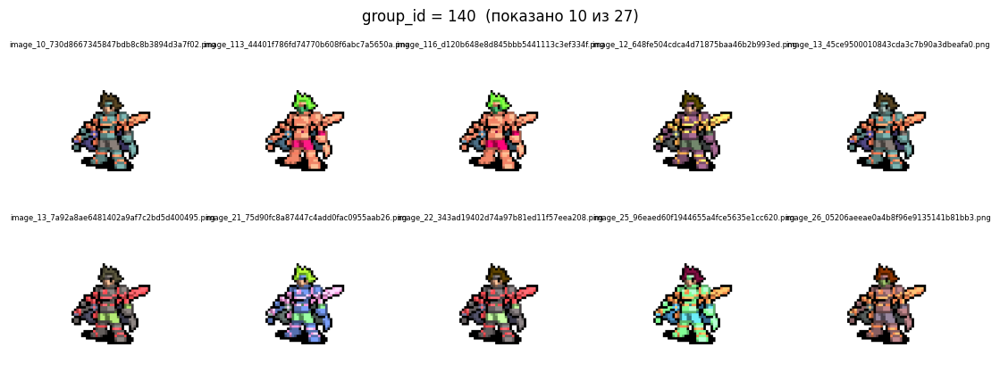

Enter — следующая группа, 'q' — выйти:  


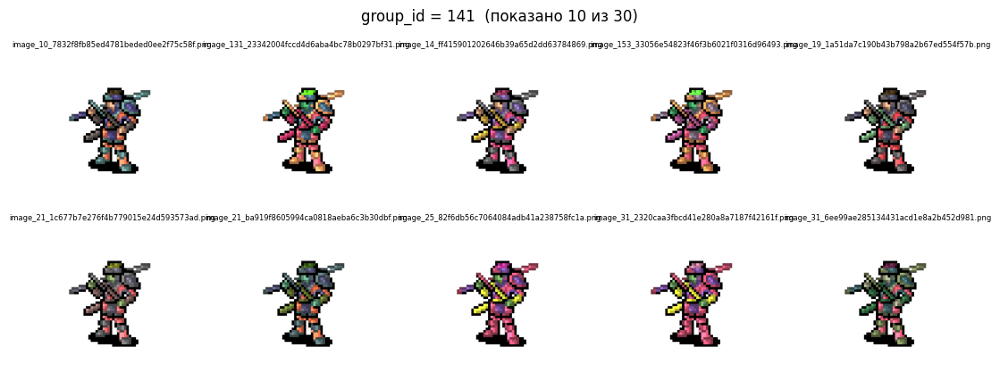

Enter — следующая группа, 'q' — выйти:  


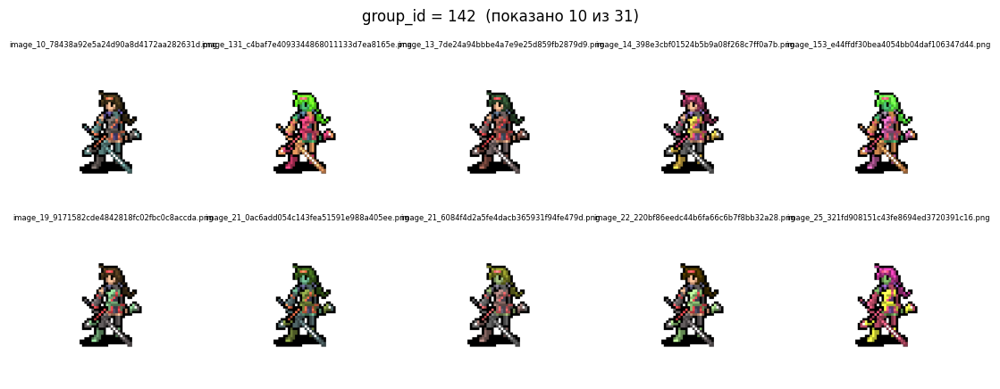

Enter — следующая группа, 'q' — выйти:  


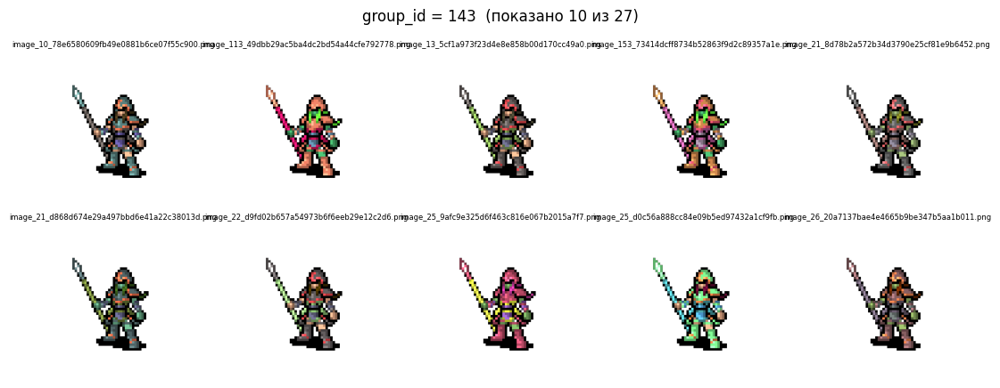

Enter — следующая группа, 'q' — выйти:  


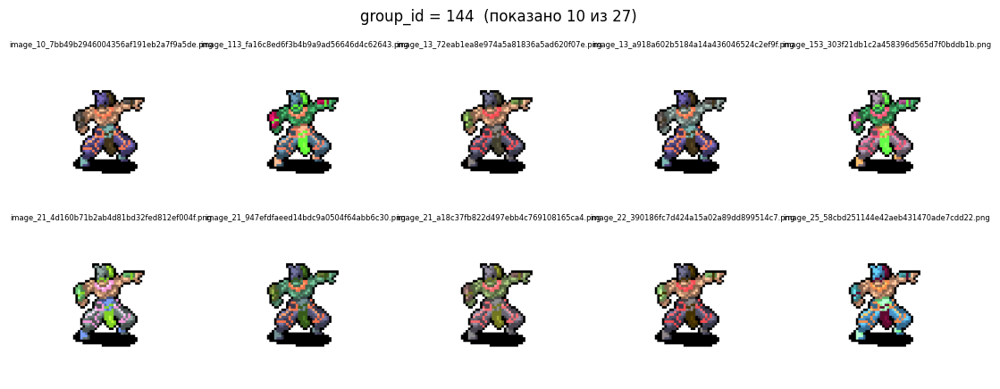

Enter — следующая группа, 'q' — выйти:  


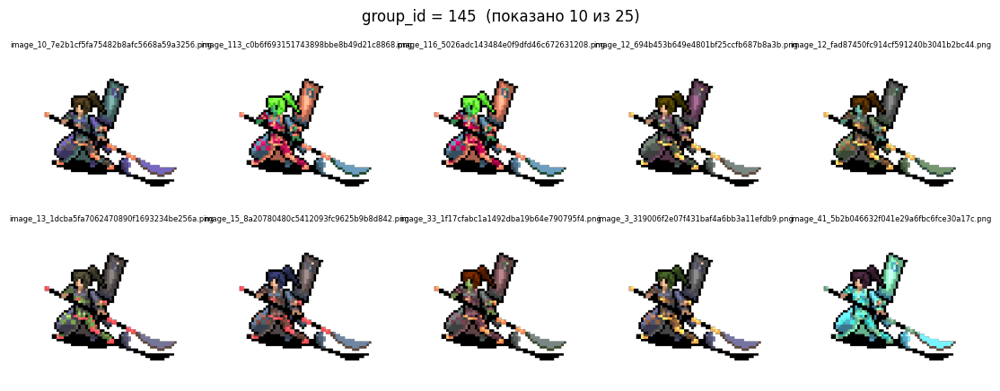

Enter — следующая группа, 'q' — выйти:  


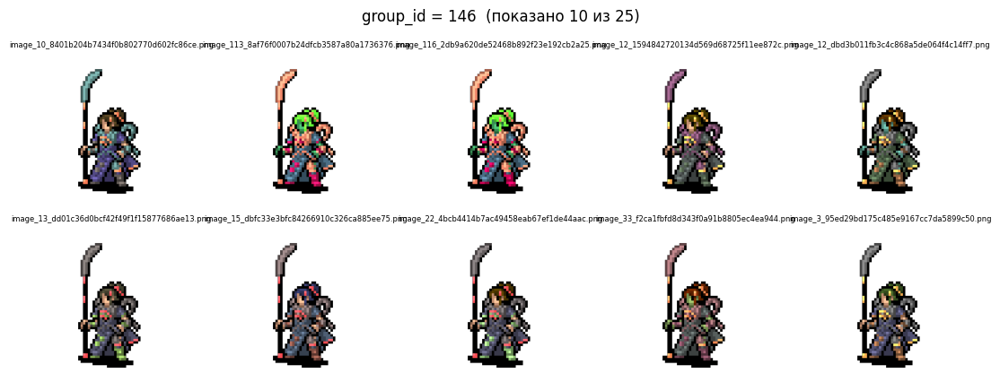

Enter — следующая группа, 'q' — выйти:  


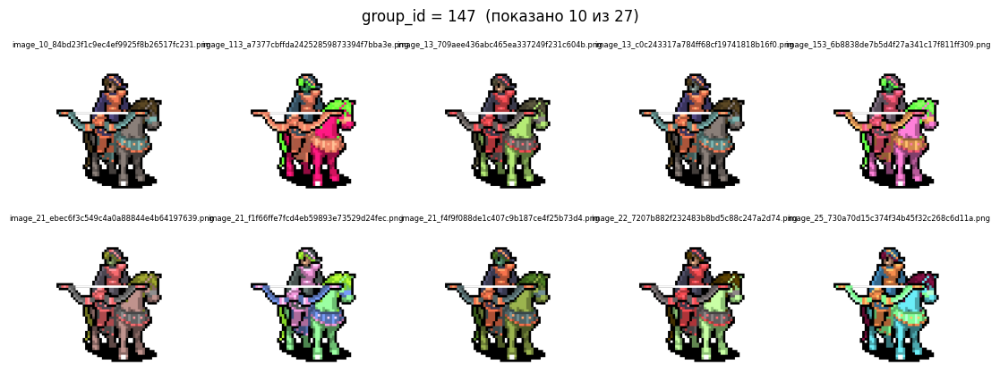

Enter — следующая группа, 'q' — выйти:  


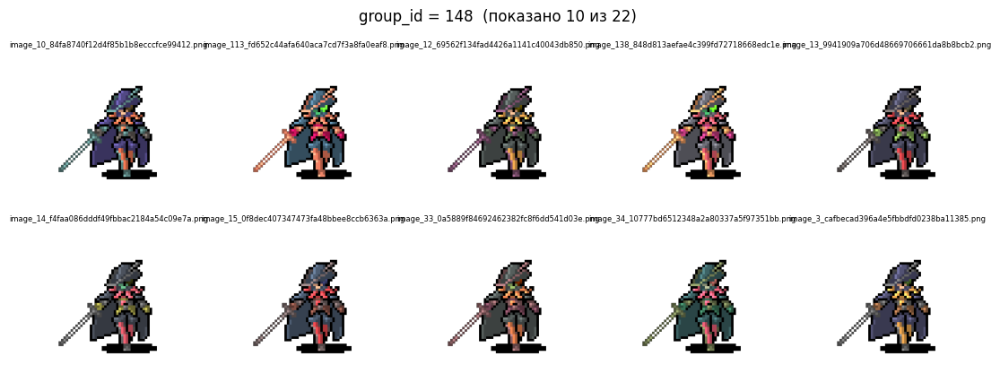

Enter — следующая группа, 'q' — выйти:  


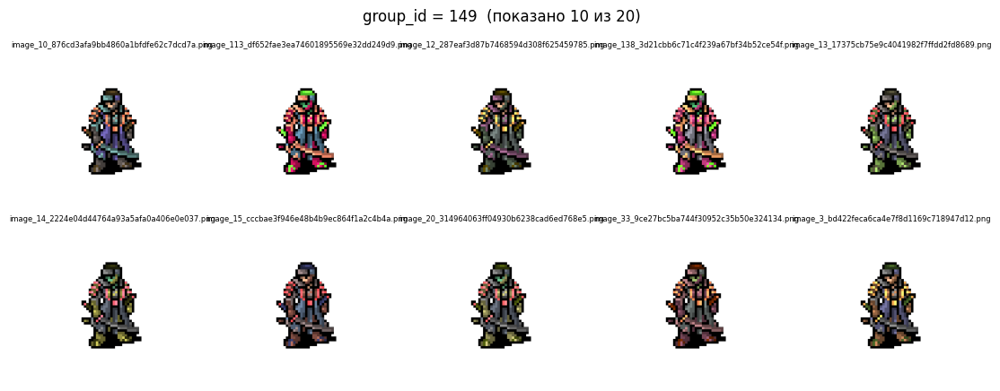

Enter — следующая группа, 'q' — выйти:  


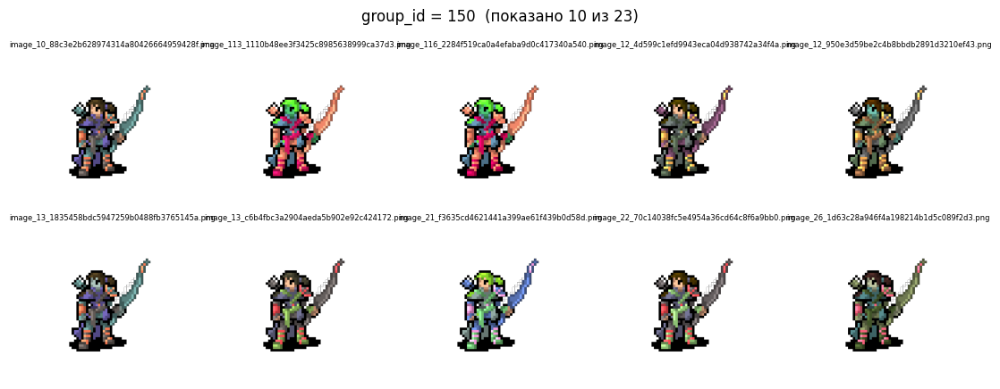

Enter — следующая группа, 'q' — выйти:  


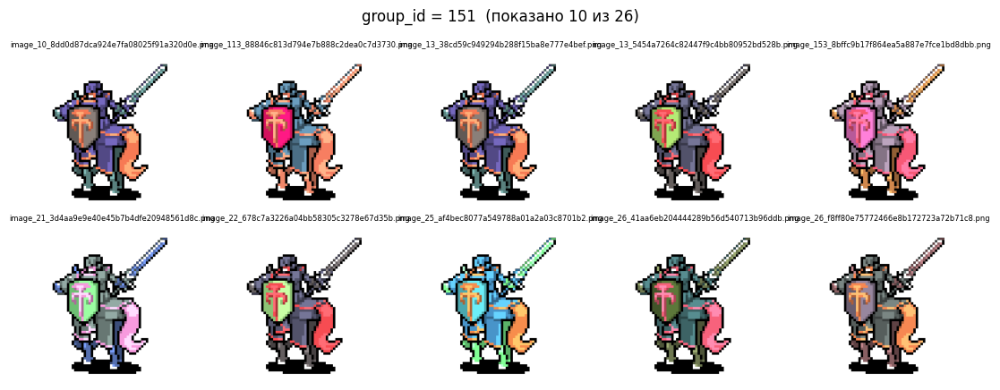

Enter — следующая группа, 'q' — выйти:  


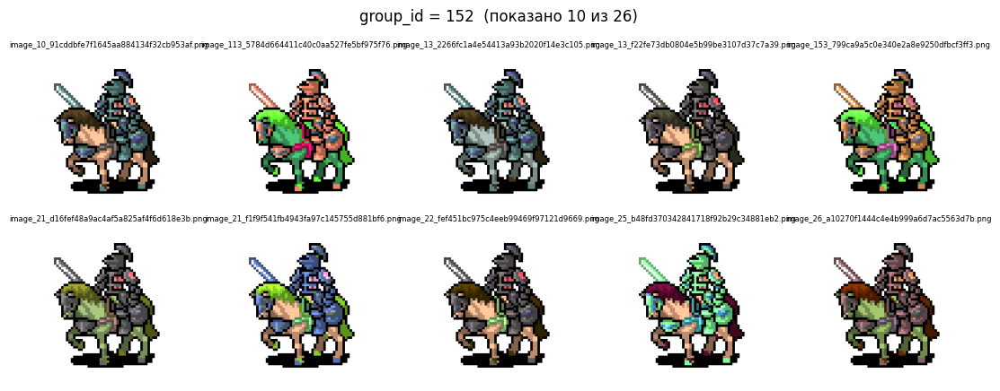

Enter — следующая группа, 'q' — выйти:  


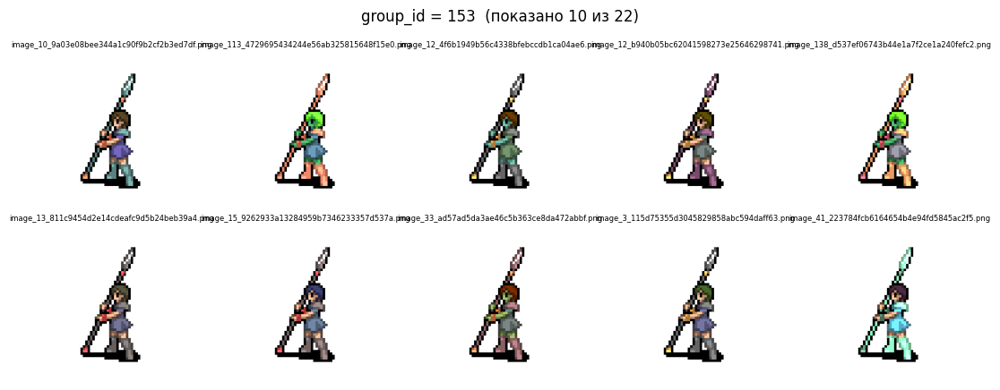

Enter — следующая группа, 'q' — выйти:  


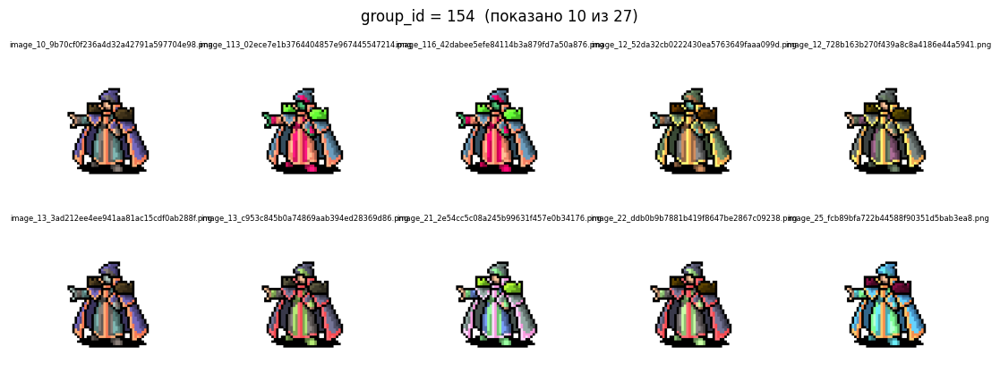

Enter — следующая группа, 'q' — выйти:  


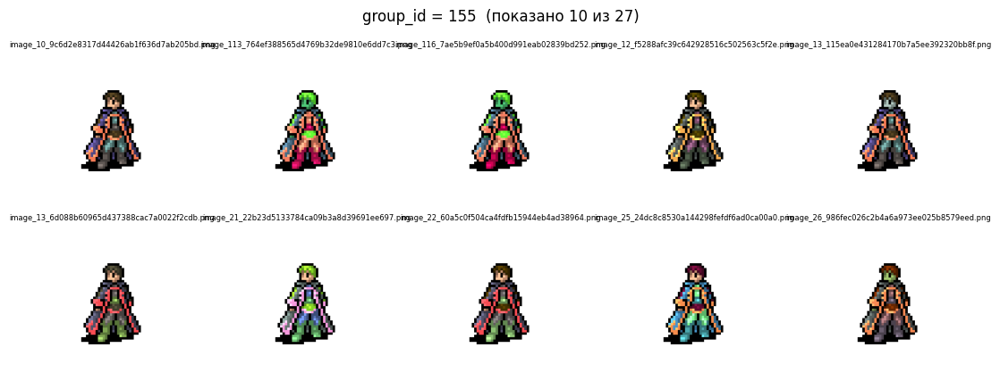

Enter — следующая группа, 'q' — выйти:  


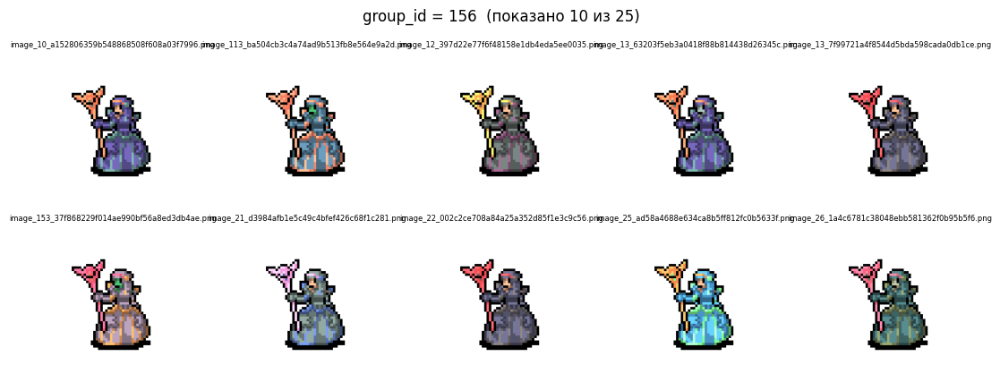

Enter — следующая группа, 'q' — выйти:  


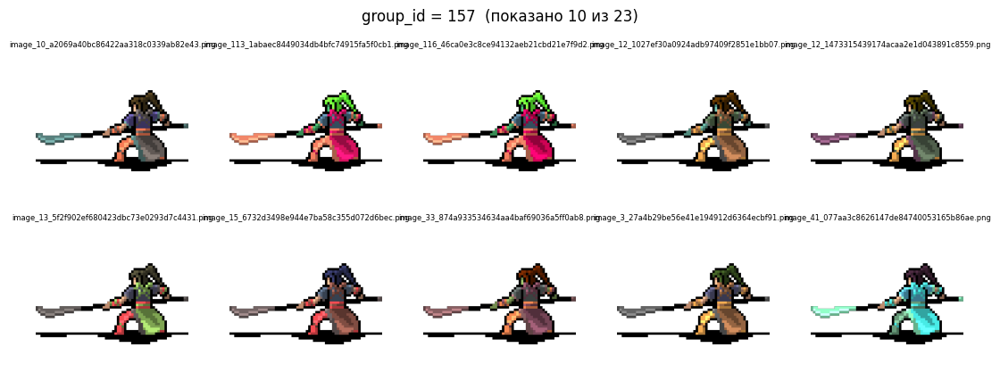

Enter — следующая группа, 'q' — выйти:  


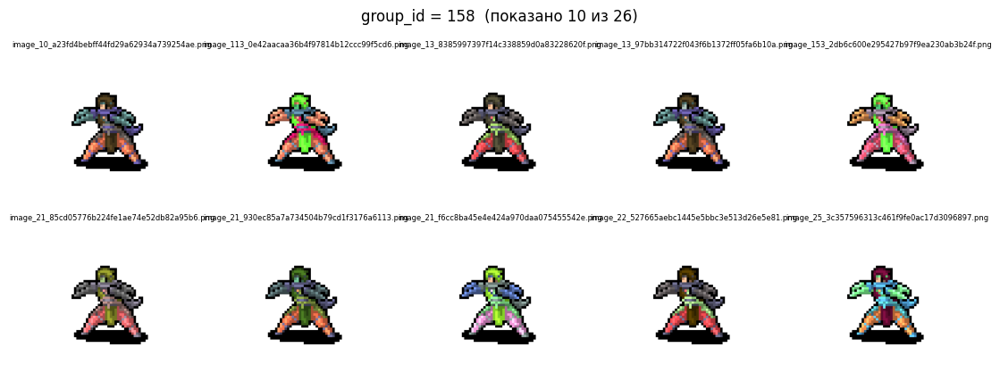

Enter — следующая группа, 'q' — выйти:  


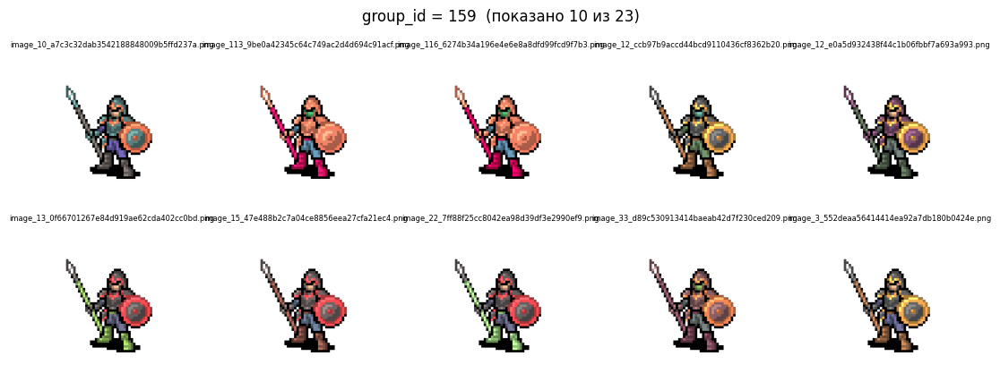

Enter — следующая группа, 'q' — выйти:  


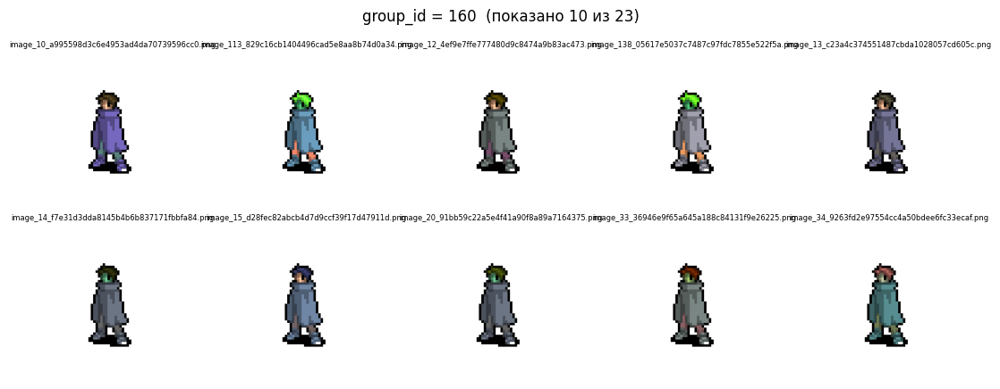

Enter — следующая группа, 'q' — выйти:  


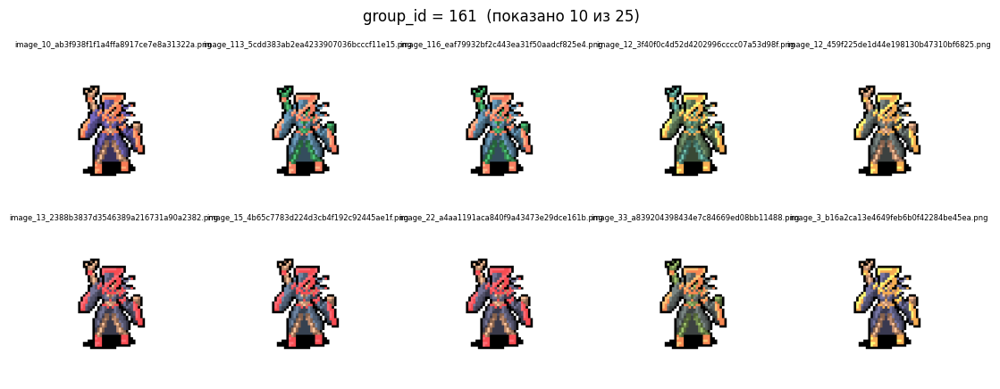

Enter — следующая группа, 'q' — выйти:  


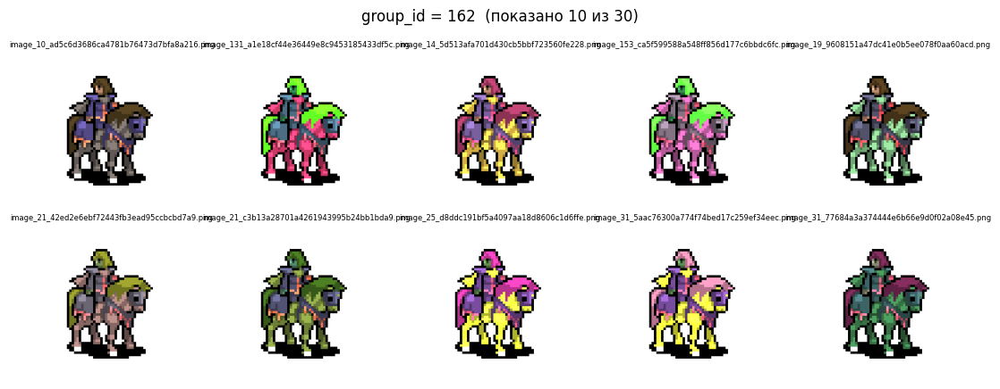

Enter — следующая группа, 'q' — выйти:  


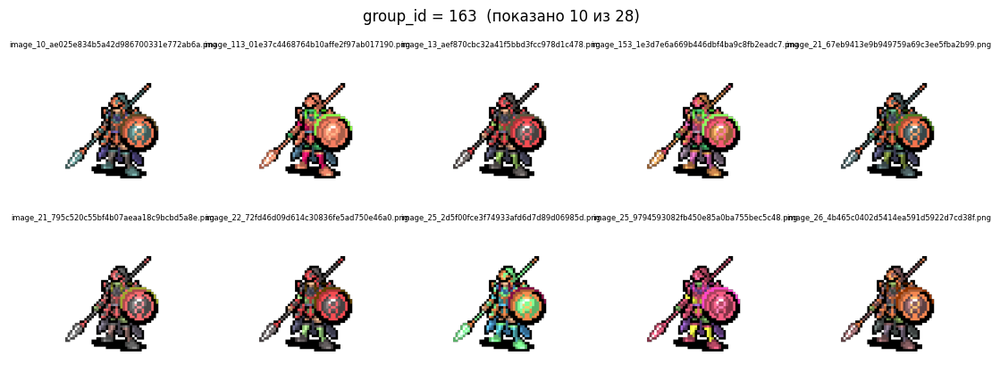

Enter — следующая группа, 'q' — выйти:  


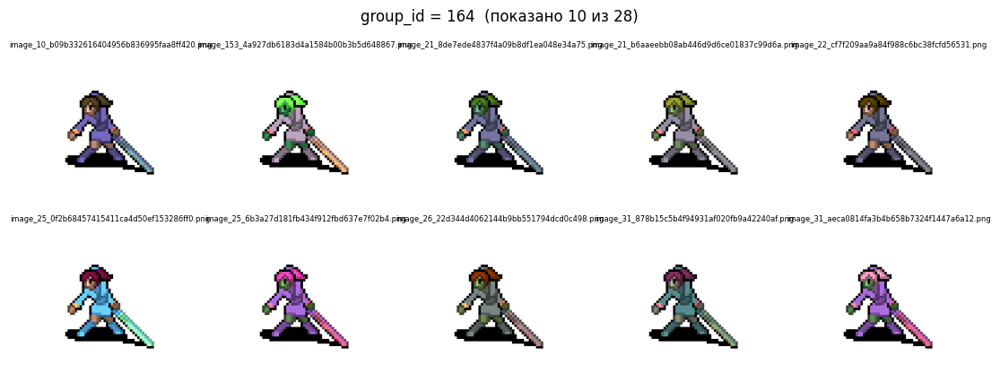

Enter — следующая группа, 'q' — выйти:  


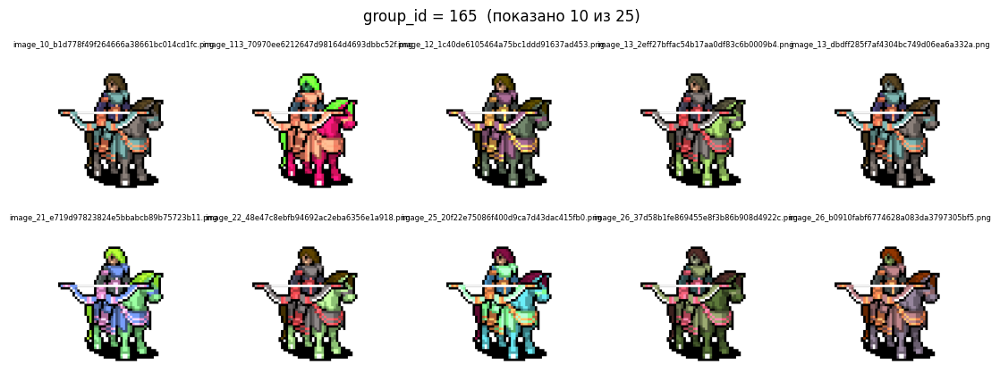

Enter — следующая группа, 'q' — выйти:  


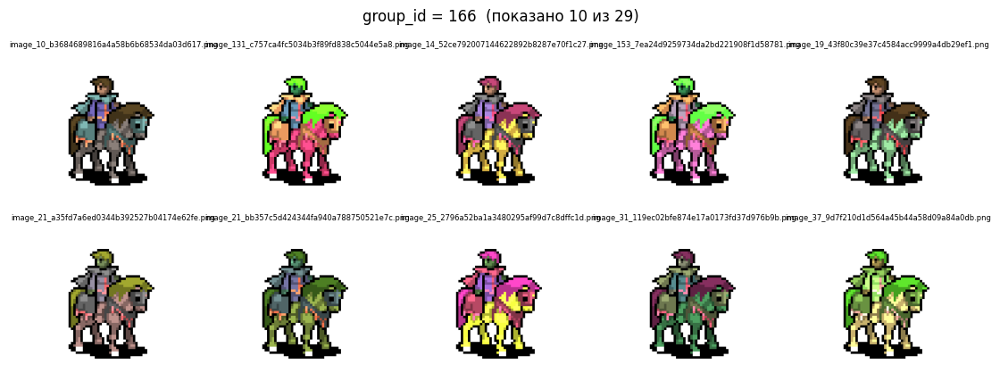

Enter — следующая группа, 'q' — выйти:  


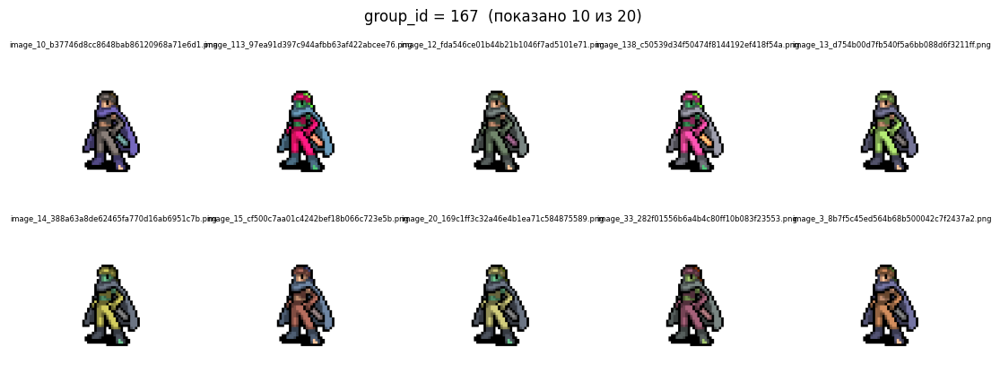

Enter — следующая группа, 'q' — выйти:  


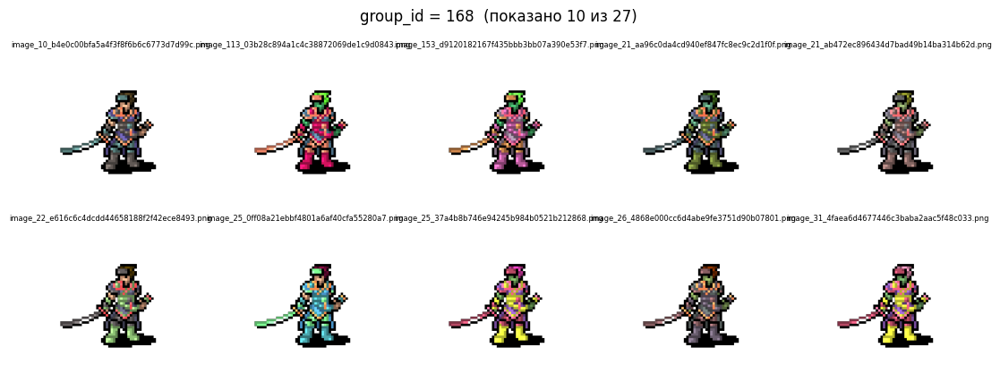

Enter — следующая группа, 'q' — выйти:  


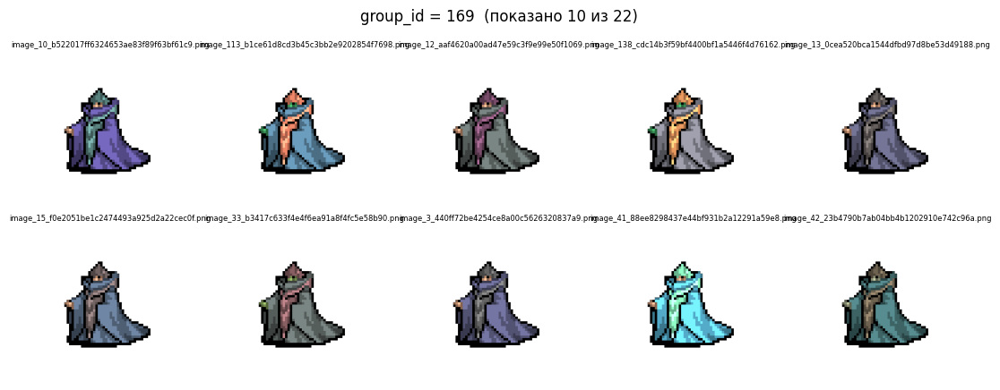

Enter — следующая группа, 'q' — выйти:  


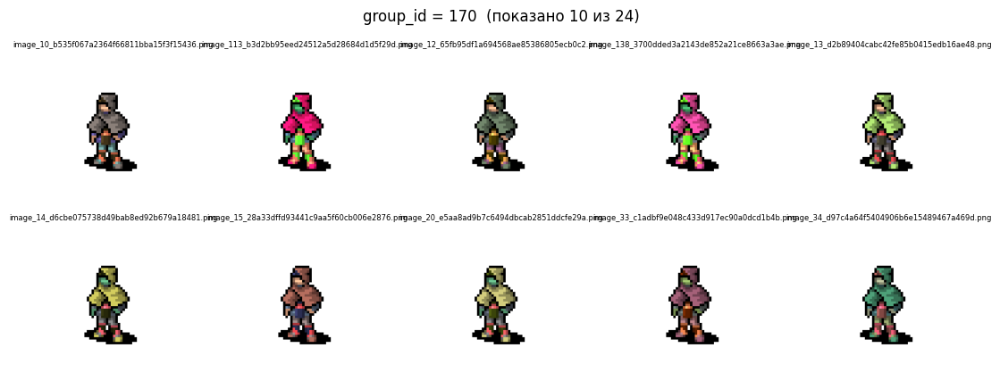

Enter — следующая группа, 'q' — выйти:  


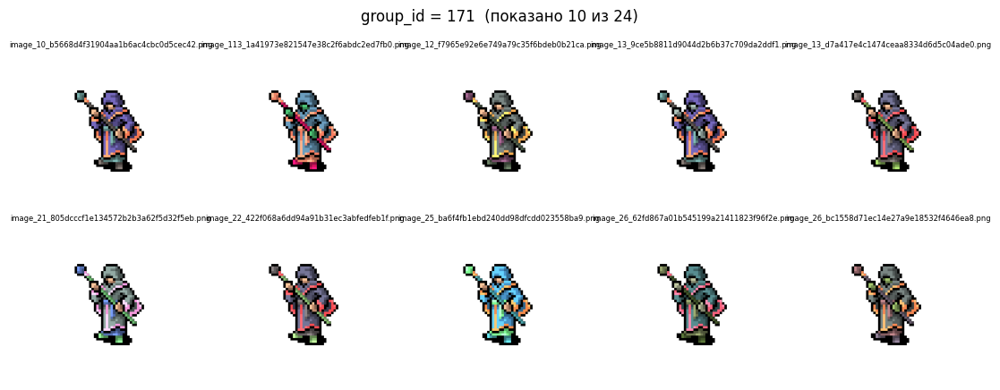

Enter — следующая группа, 'q' — выйти:  


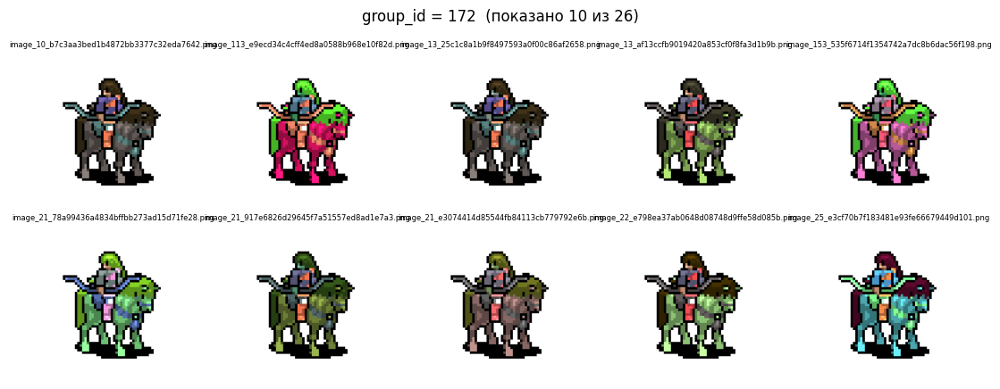

Enter — следующая группа, 'q' — выйти:  


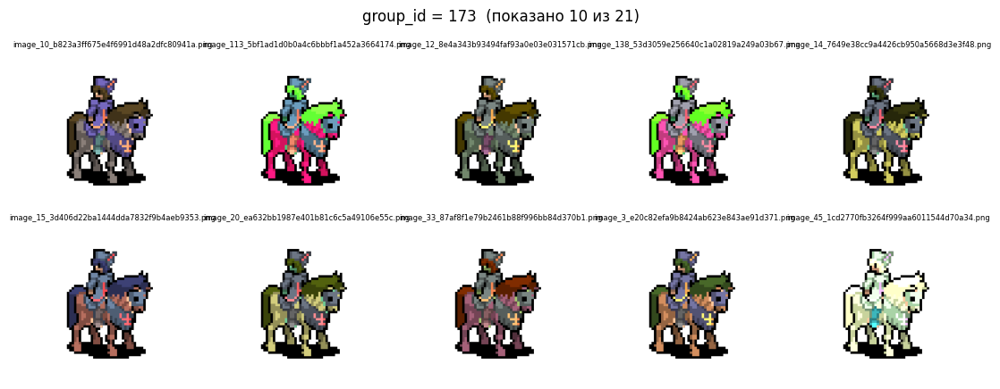

Enter — следующая группа, 'q' — выйти:  


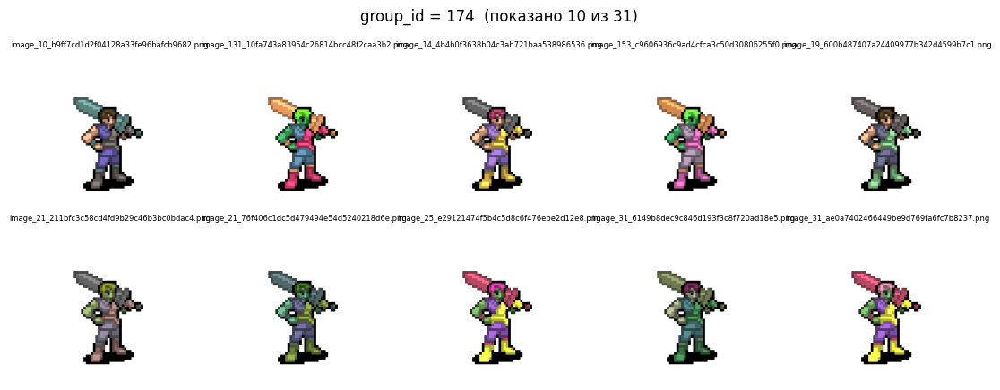

Enter — следующая группа, 'q' — выйти:  


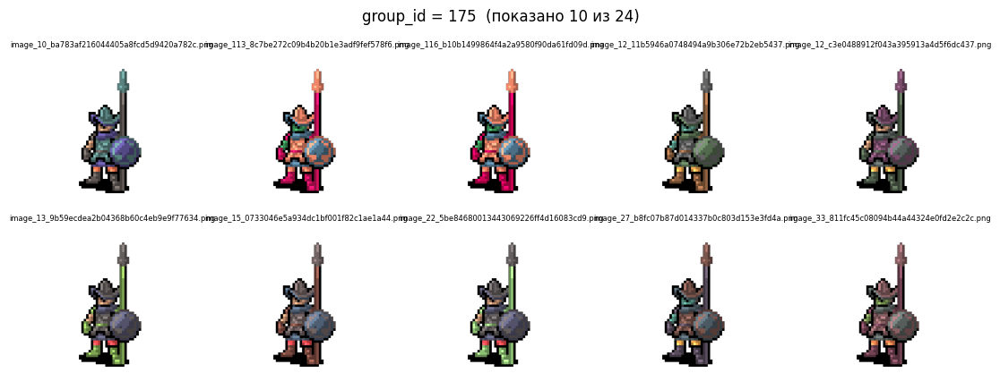

Enter — следующая группа, 'q' — выйти:  


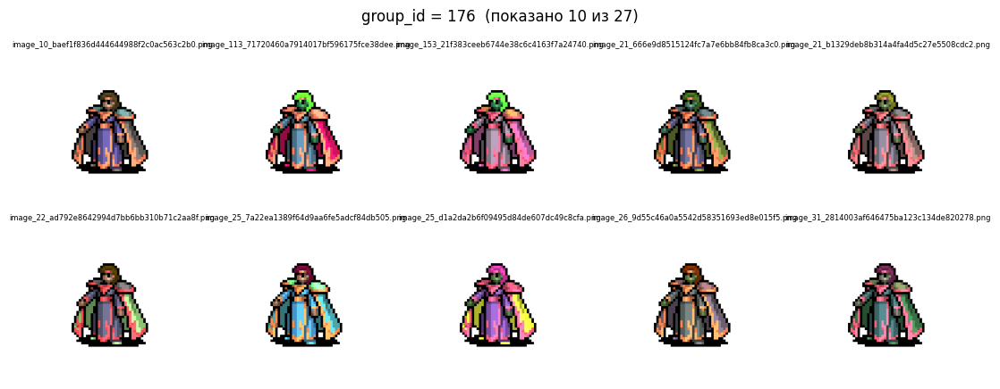

Enter — следующая группа, 'q' — выйти:  


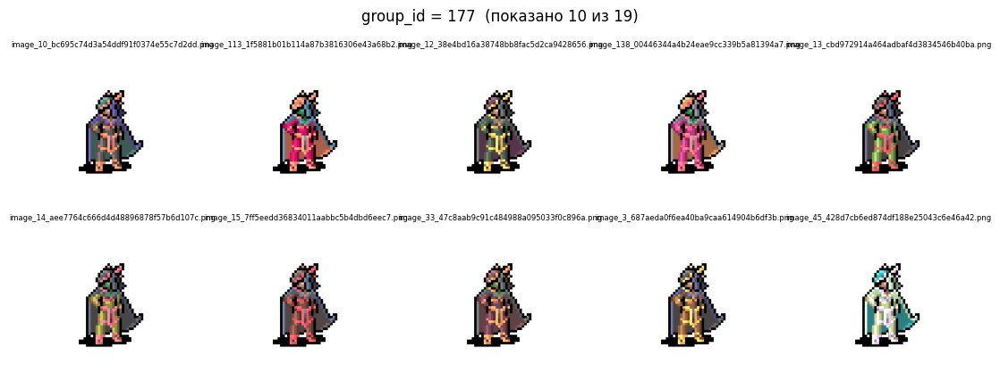

Enter — следующая группа, 'q' — выйти:  


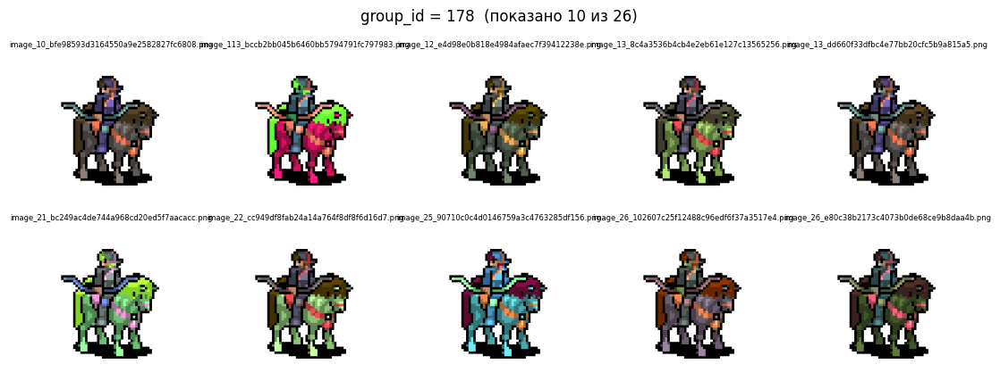

Enter — следующая группа, 'q' — выйти:  


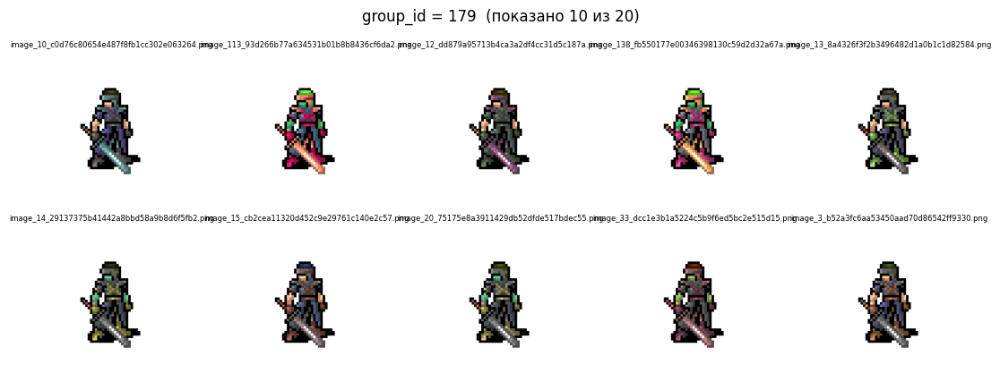

Enter — следующая группа, 'q' — выйти:  


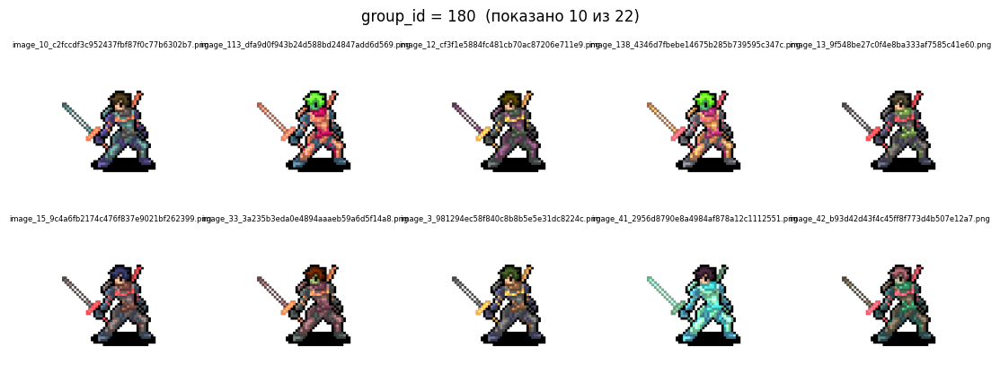

Enter — следующая группа, 'q' — выйти:  


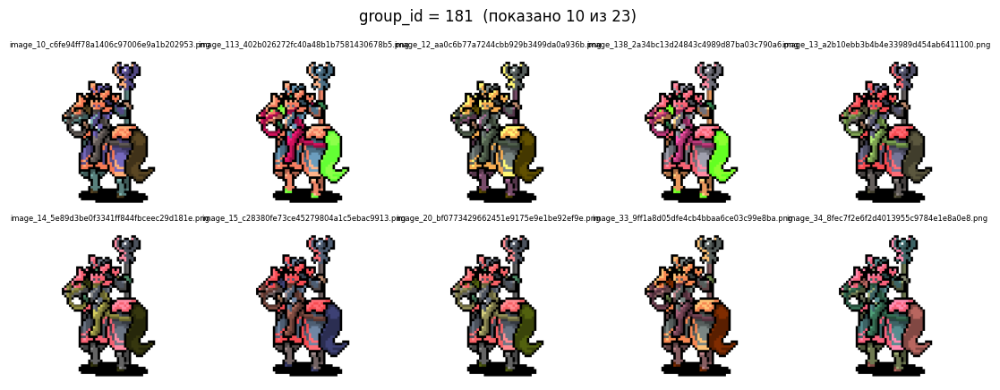

Enter — следующая группа, 'q' — выйти:  


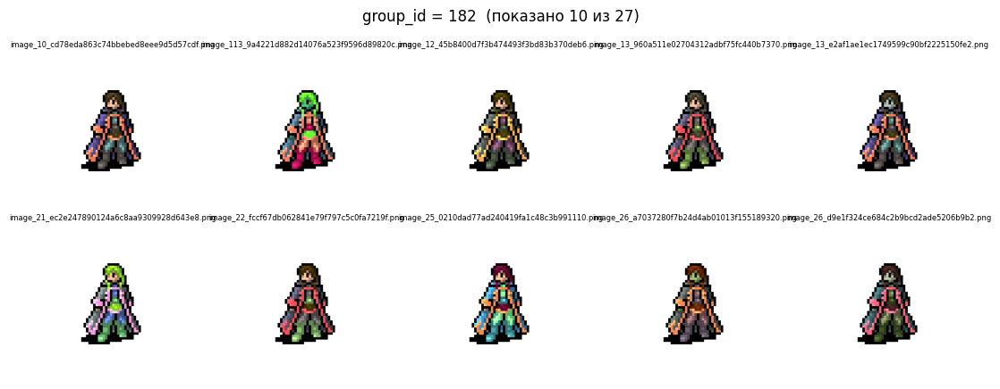

Enter — следующая группа, 'q' — выйти:  


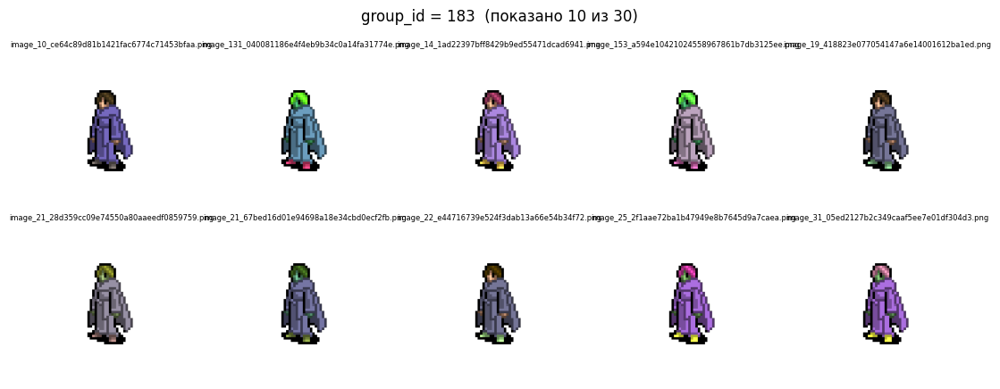

Enter — следующая группа, 'q' — выйти:  


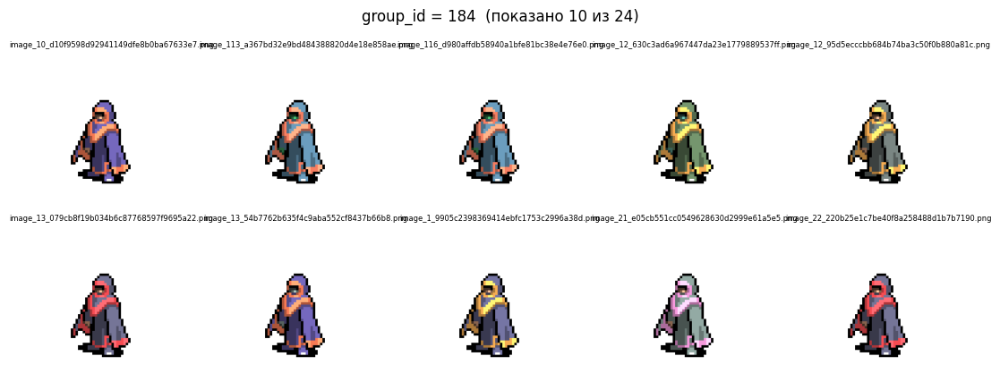

Enter — следующая группа, 'q' — выйти:  


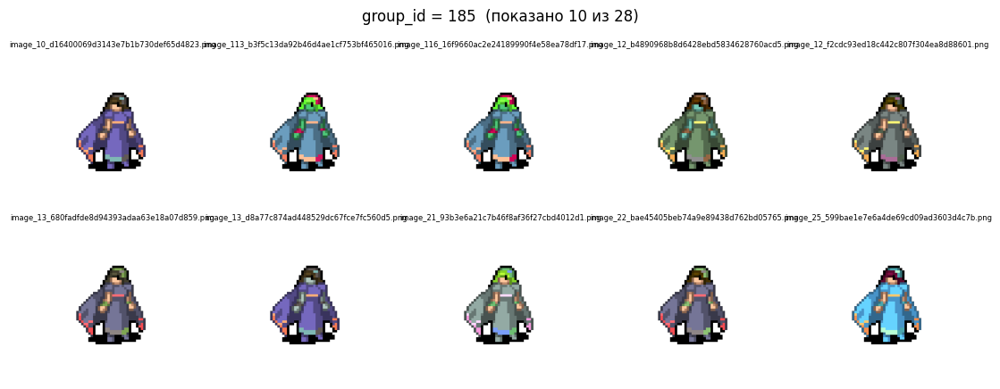

Enter — следующая группа, 'q' — выйти:  


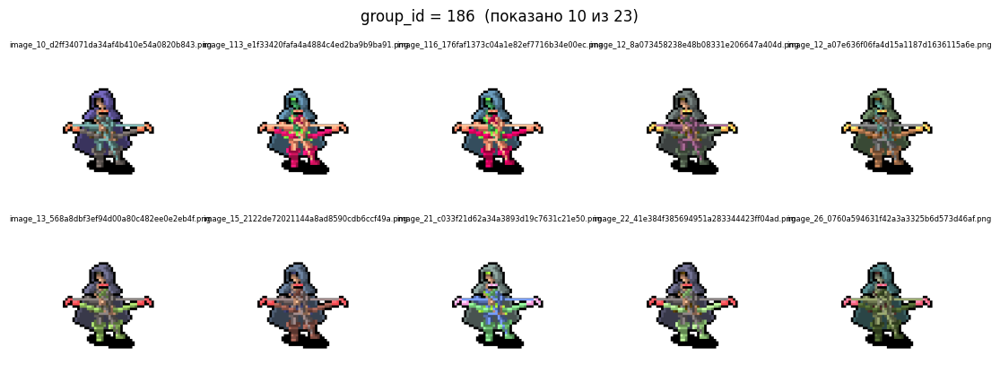

Enter — следующая группа, 'q' — выйти:  


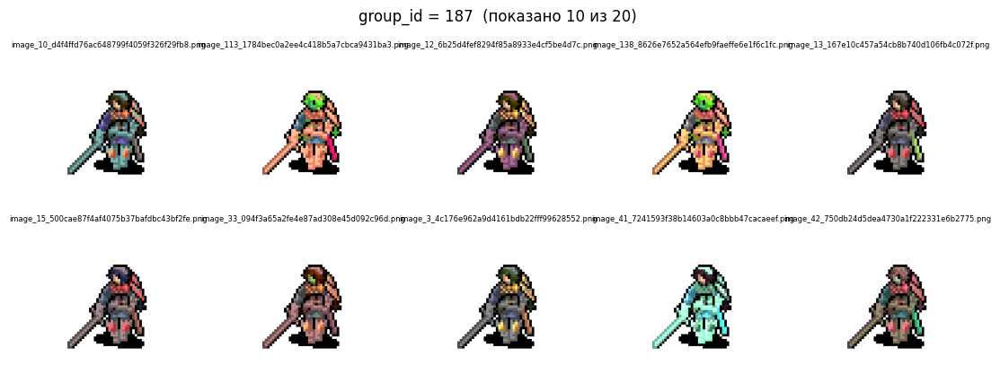

Enter — следующая группа, 'q' — выйти:  


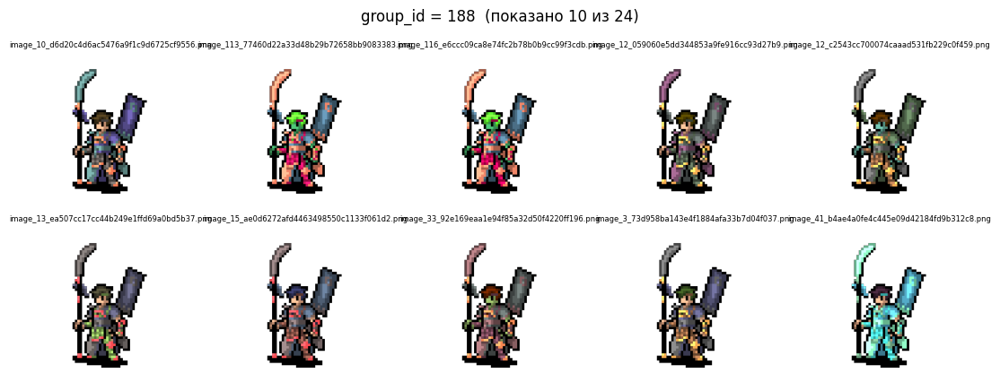

Enter — следующая группа, 'q' — выйти:  


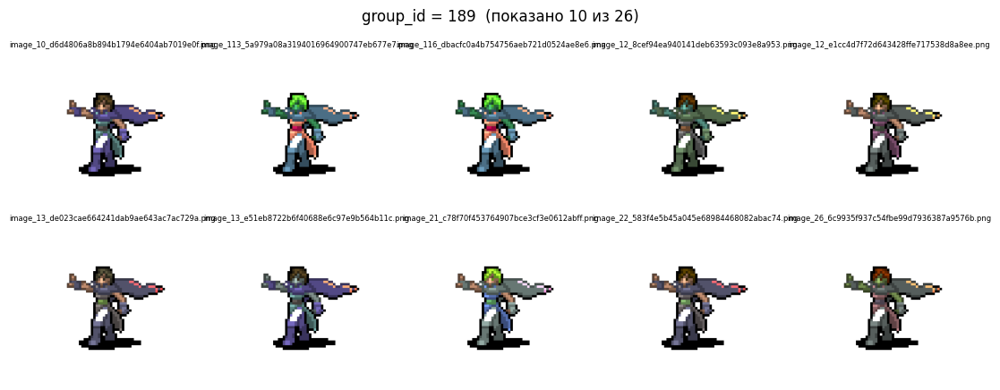

Enter — следующая группа, 'q' — выйти:  


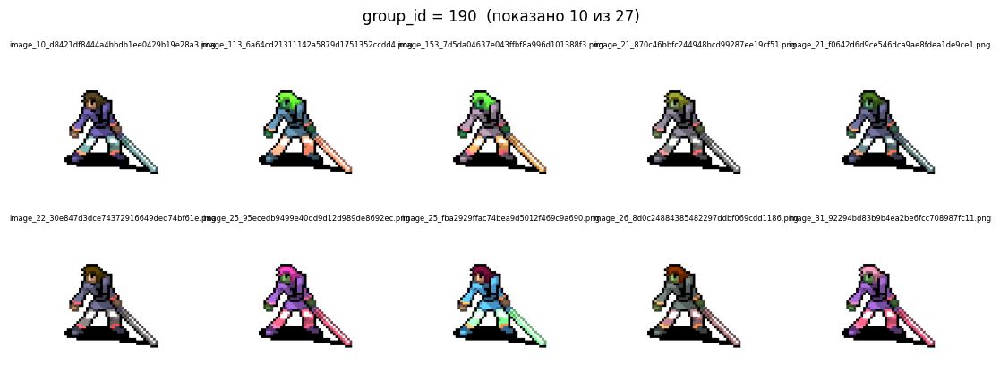

Enter — следующая группа, 'q' — выйти:  


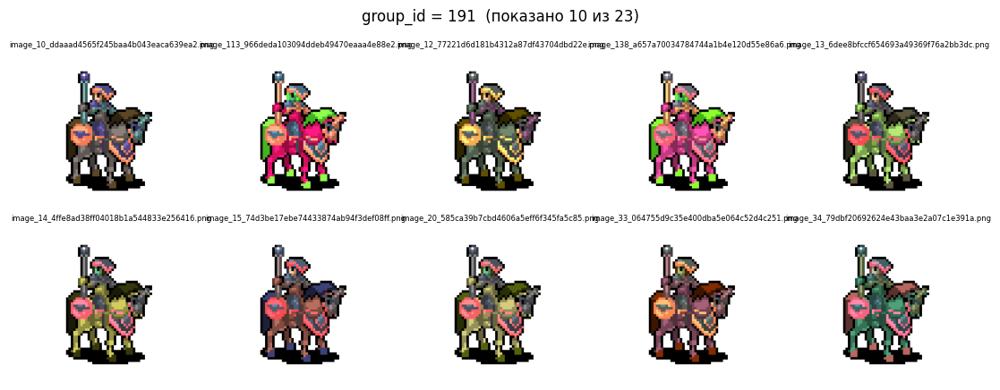

Enter — следующая группа, 'q' — выйти:  


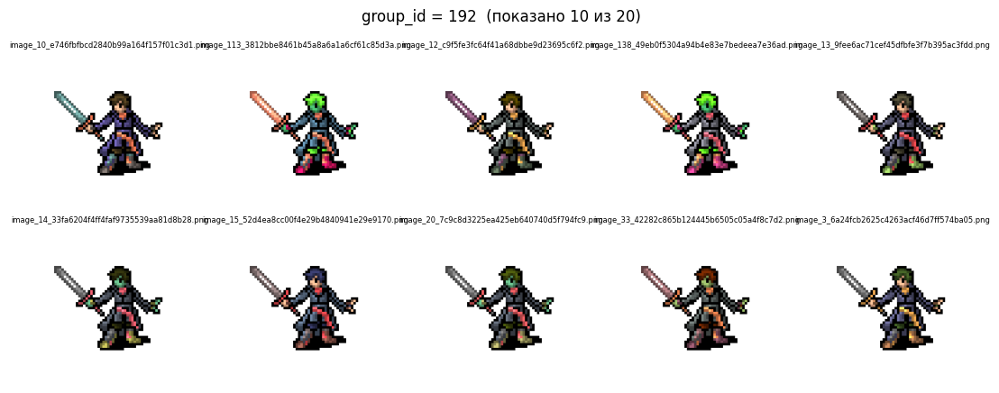

Enter — следующая группа, 'q' — выйти:  


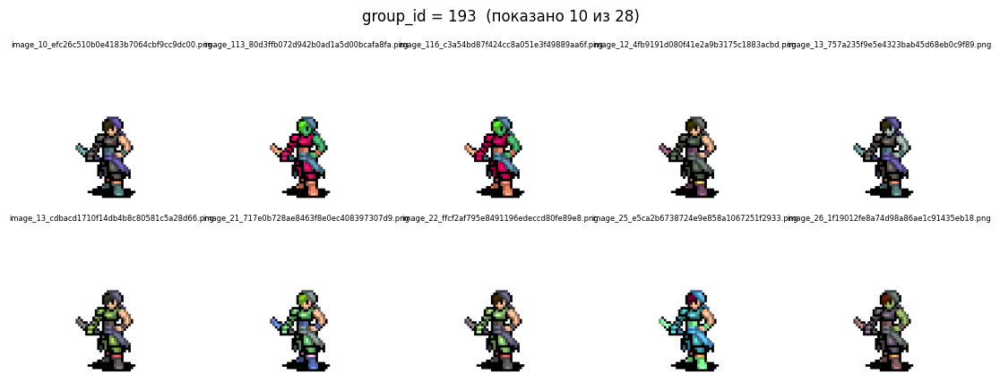

Enter — следующая группа, 'q' — выйти:  


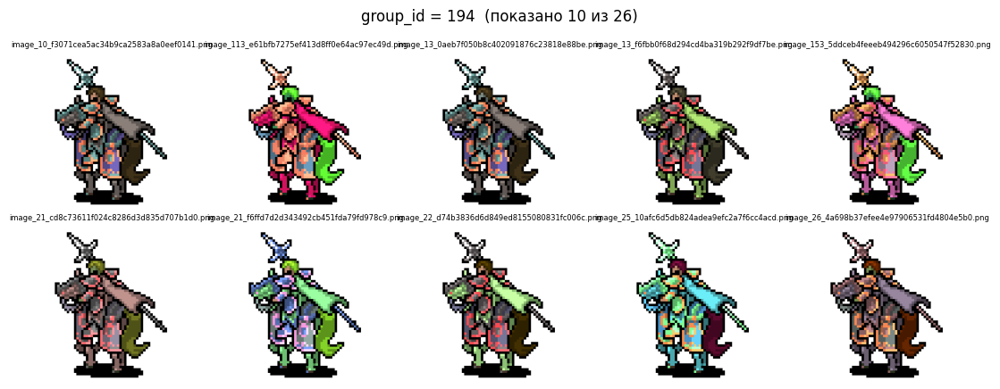

Enter — следующая группа, 'q' — выйти:  


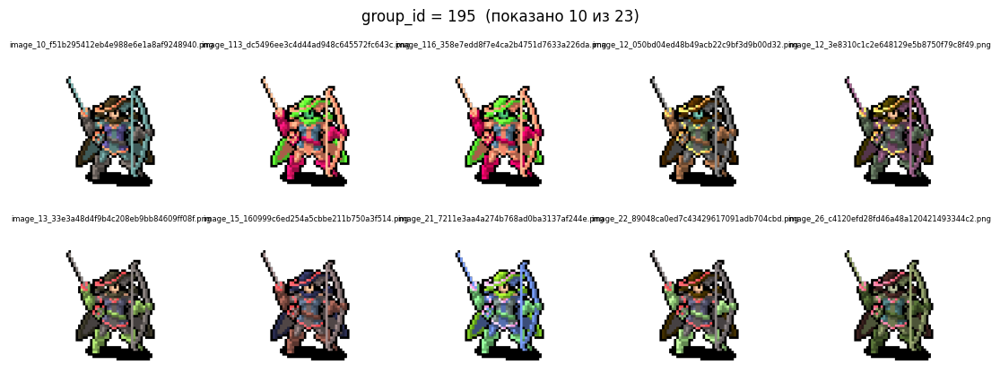

Enter — следующая группа, 'q' — выйти:  


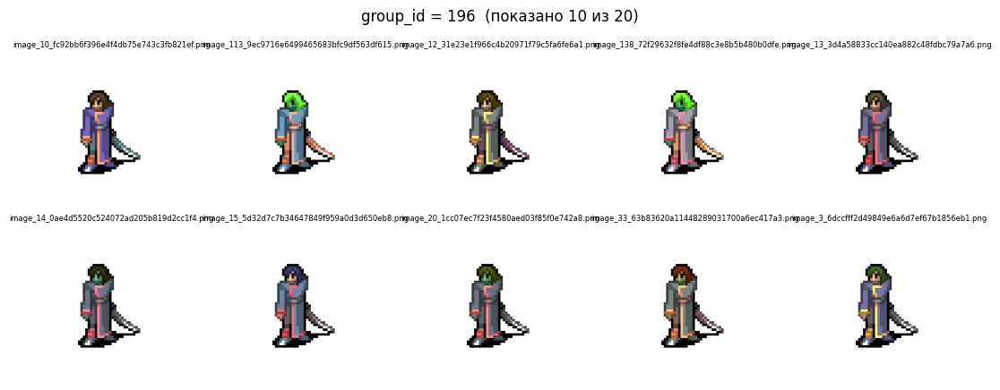

Enter — следующая группа, 'q' — выйти:  


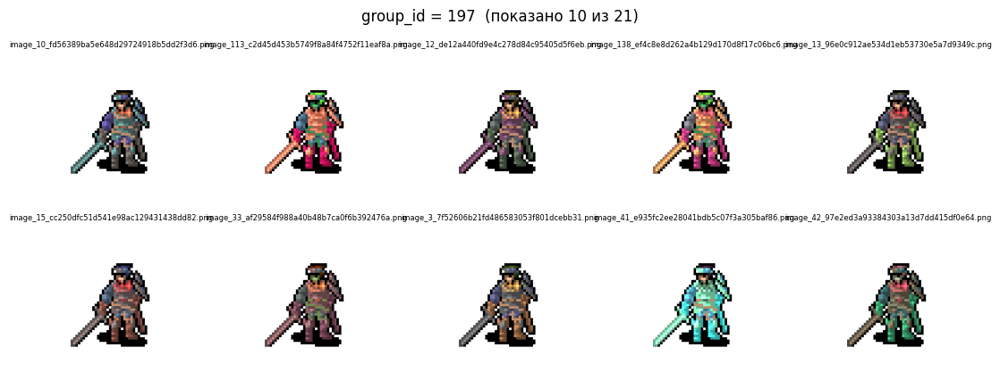

Enter — следующая группа, 'q' — выйти:  


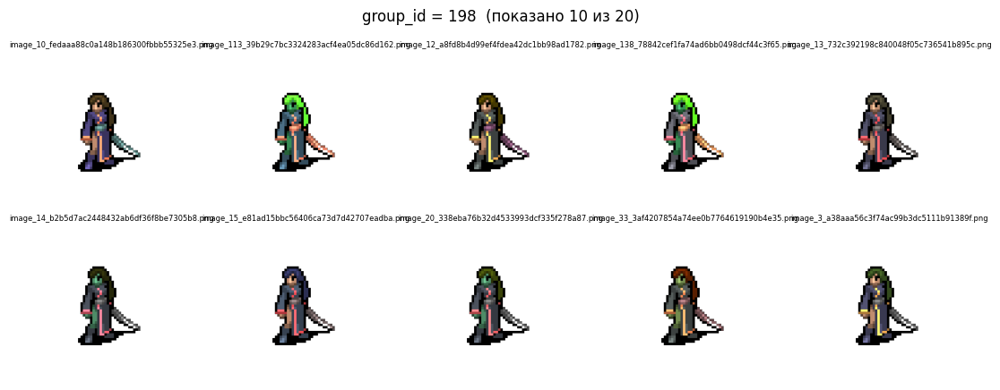

Enter — следующая группа, 'q' — выйти:  


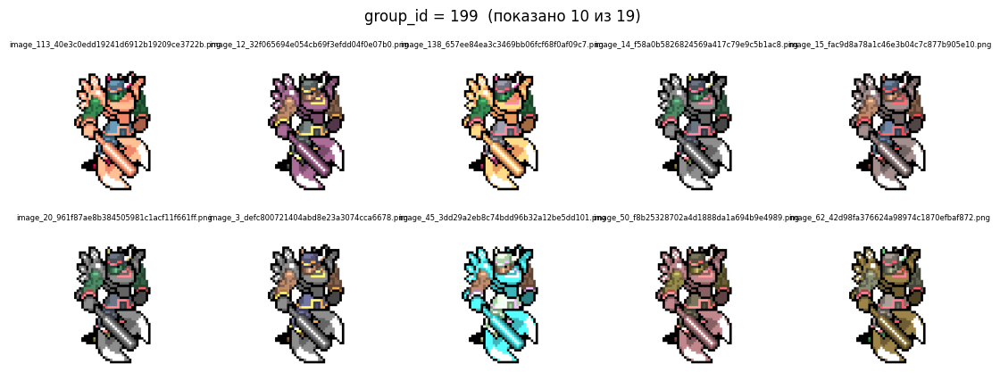

Enter — следующая группа, 'q' — выйти:  


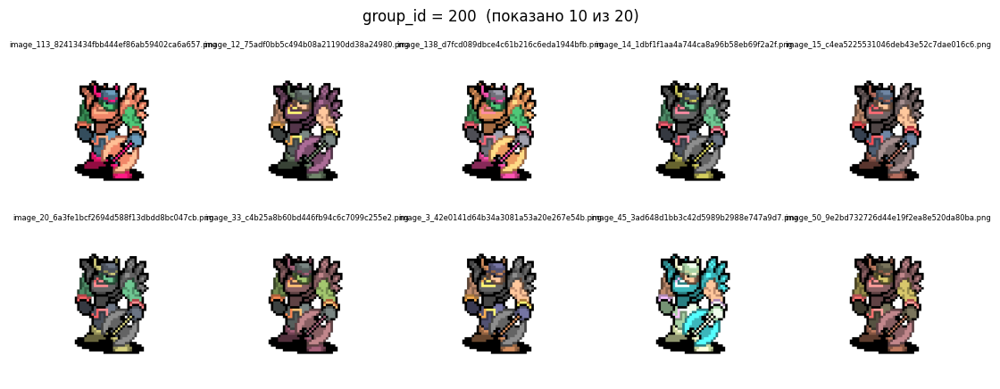

Enter — следующая группа, 'q' — выйти:  


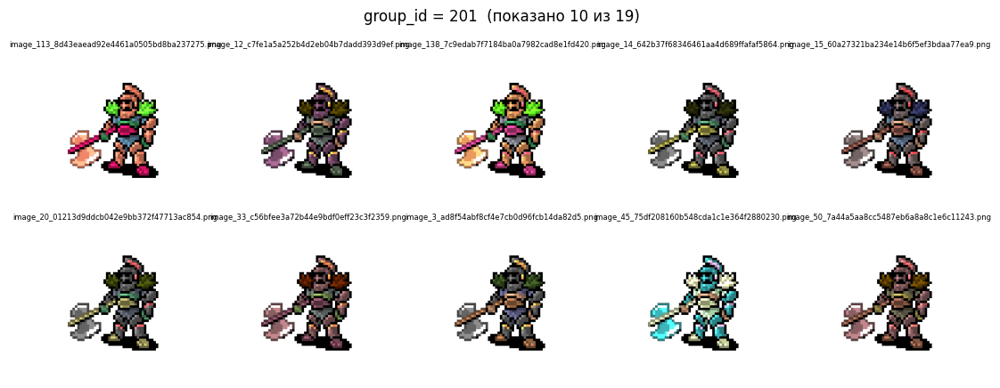

Enter — следующая группа, 'q' — выйти:  


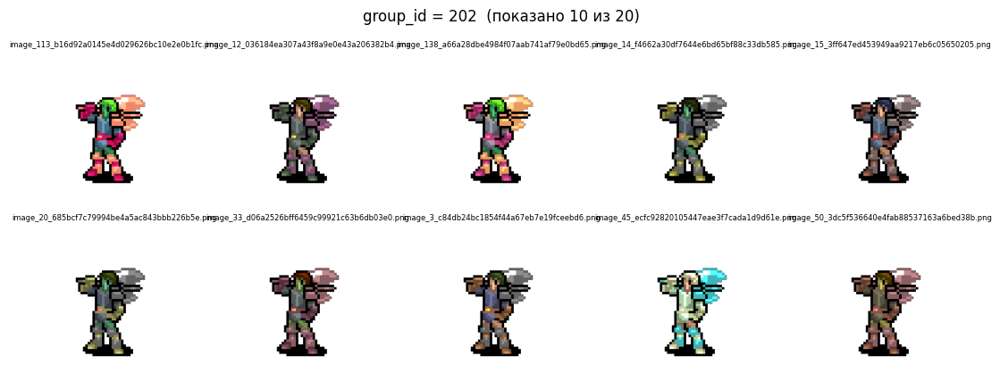

Enter — следующая группа, 'q' — выйти:  


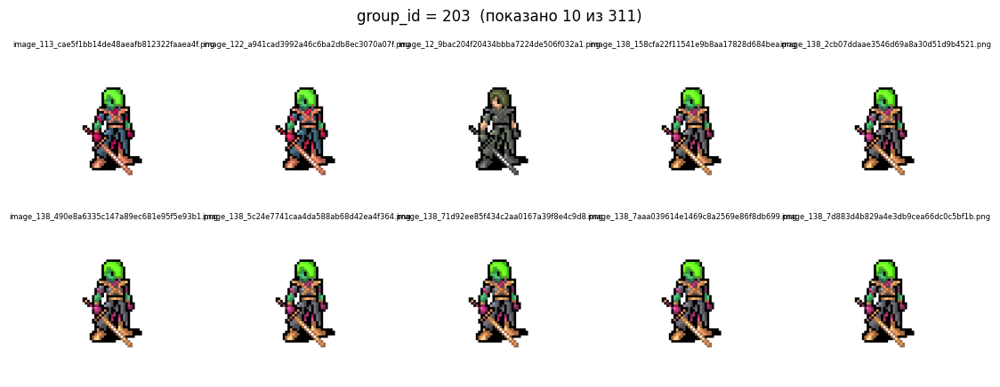

Enter — следующая группа, 'q' — выйти:  


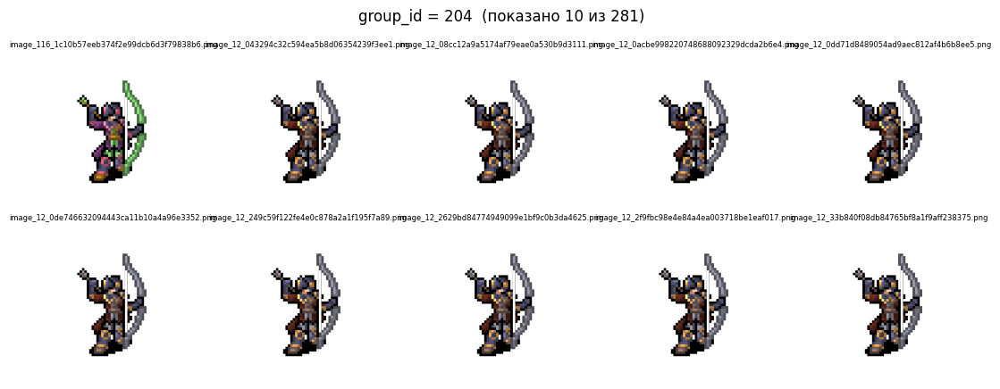

Enter — следующая группа, 'q' — выйти:  


In [14]:
# путь к sprite_groups.csv
GROUPS_CSV = DATA_DI / "sprite_groups.csv"

df = pd.read_csv(GROUPS_CSV)

# на всякий случай отсортируем группы по id
group_ids = sorted(df["group_id"].unique())

print(f"Всего групп: {len(group_ids)}")

for gid in group_ids:
    sub = df[df["group_id"] == gid]
    total_in_group = len(sub)
    # берём до 10 представителей
    sub = sub.head(10).reset_index(drop=True)
    n = len(sub)

    cols = 5
    rows = math.ceil(n / cols)

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2.2, rows * 2.2))
    axes = axes.ravel()

    for ax, (_, row) in zip(axes, sub.iterrows()):
        img_path = row["path"]
        img = Image.open(img_path).convert("RGBA")
        ax.imshow(img)
        ax.axis("off")
        ax.set_title(Path(row["filename"]).name, fontsize=6)

    # выключаем лишние оси, если картинок < rows*cols
    for ax in axes[n:]:
        ax.axis("off")

    fig.suptitle(f"group_id = {gid}  (показано {n} из {total_in_group})", fontsize=12)
    plt.tight_layout()
    plt.show()

    ans = input("Enter — следующая группа, 'q' — выйти: ")
    if ans.lower().startswith("q"):
        print("Остановлено по запросу.")
        break

In [18]:
groups = pd.read_csv(GROUPS_CSV)
group_ids = sorted(groups["group_id"].unique())
len(group_ids)

205

In [20]:
labels = pd.DataFrame({
    "group_id": group_ids,
    "gender": ["" for _ in group_ids],
    "hero_class": ["" for _ in group_ids],
})

out_path = DATA_DIR / "group_labels_template.csv"
labels.to_csv(out_path, index=False)
print(out_path)

D:\ML\LS\Deep_learning\GAN\hero_portrait_generator\group_labels_template.csv


In [21]:
groups = pd.read_csv(DATA_DIR / "sprite_groups.csv")
labels = pd.read_csv(DATA_DIR / "group_labels_template.csv")

# на всякий случай проверка:
missing = set(groups["group_id"].unique()) - set(labels["group_id"].unique())
print("Группы без меток:", missing)

merged = groups.merge(labels, on="group_id", how="left")

print(merged.head())
print("Всего строк:", len(merged))

out_path = DATA_DIR / "sprites_labeled.csv"
merged.to_csv(out_path, index=False)
print("Сохранено:", out_path)

Группы без меток: set()
                                       filename  \
0  image_0_017767286f7f40fdac605acf20e0abd0.png   
1  image_0_0c675f243c4144d98e5d21061d661911.png   
2  image_0_1c6697f5b9684e28b67d9e1f36c20e2a.png   
3  image_0_1ed2ac7ca5e44321ae1dbad2a4c523fc.png   
4  image_0_2630d288f1c540e19246aff50a66625e.png   

                                                path  idx  \
0  D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...    0   
1  D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...    0   
2  D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...    0   
3  D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...    0   
4  D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...    0   

                    silhouette_hash  group_id     gender hero_class  
0  eec6bb950739fea09983e1f52b0cd4e3         0  masculine     knight  
1  e87042f6b71065c219f8456ec2d18732         1   feminine    cavalry  
2  c1012a17d3ed53d968679e18a1729120         2  masculine    warrior  
3  3d1c8e4373c5622762a

In [1]:
df = pd.read_csv(DATA_DIR / "sprites_labeled.csv")

def classify_palette(rgb):
    r, g, b = rgb

    # яркость
    brightness = (r + g + b) / 3

    # насыщенность
    mx = max(r, g, b)
    mn = min(r, g, b)
    saturation = mx - mn

    # доминирующий канал
    if r > g and r > b:
        dominant = "red"
    elif g > r and g > b:
        dominant = "green"
    else:
        dominant = "blue"

    # правила классификации
    if brightness < 80:
        return "dark"
    if brightness > 180:
        return "bright"
    if saturation < 25:
        return "neutral"
    if dominant == "red":
        return "warm"
    if dominant == "green":
        return "muted"
    if dominant == "blue":
        return "cool"

    return "neutral"

palettes = []

for path in tqdm(df["path"], desc="Processing palette"):
    img = Image.open(path).convert("RGBA")
    arr = np.array(img)

    # маска пикселей, которые не прозрачные
    mask = arr[:, :, 3] > 0

    rgb = arr[:, :, :3][mask]

    if len(rgb) == 0:
        palettes.append("unknown")
        continue

    mean_rgb = rgb.mean(axis=0)
    palette = classify_palette(mean_rgb)
    palettes.append(palette)

df["palette"] = palettes

out = DATA_DIR / "sprites_final.csv"
df.to_csv(out, index=False)
print("Сохранено:", out)

Processing palette: 100%|██████████| 7596/7596 [01:14<00:00, 102.52it/s]


Сохранено: D:\ML\LS\Deep_learning\GAN\hero_portrait_generator\sprites_final.csv


In [6]:
res = pd.read_csv(DATA_DIR / "sprites_final.csv")
res.head(10)

,filename,path,idx,silhouette_hash,group_id,gender,hero_class,palette
0,image_0_017767286f7f40fdac605acf20e0abd0.png,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...,0,eec6bb950739fea09983e1f52b0cd4e3,0,masculine,knight,warm
1,image_0_0c675f243c4144d98e5d21061d661911.png,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...,0,e87042f6b71065c219f8456ec2d18732,1,feminine,cavalry,dark
2,image_0_1c6697f5b9684e28b67d9e1f36c20e2a.png,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...,0,c1012a17d3ed53d968679e18a1729120,2,masculine,warrior,dark
3,image_0_1ed2ac7ca5e44321ae1dbad2a4c523fc.png,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...,0,3d1c8e4373c5622762aa9b59c741a30f,3,masculine,cavalry,dark
4,image_0_2630d288f1c540e19246aff50a66625e.png,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...,0,c6a807ea2c297b40193171d74ce4b45b,4,feminine,warrior,dark
5,image_0_2e0af0718a1a4c0a9e3b94699c4c6a3b.png,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...,0,1cdc87b5892c99dec5e5c93e6fafb777,5,masculine,cavalry,dark
6,image_0_325d3e46e3bd4a1c9219cf85851be077.png,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...,0,dc2de34479947013cd81d51b1aceb70f,6,feminine,cavalry,dark
7,image_0_380c2ffe66a94f13807a864f996b86b1.png,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...,0,4e2b52d84b31543dec023750351c882f,7,masculine,warrior,dark
8,image_0_46be5da480d442c391ef5f402263c055.png,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...,0,66abdd87525a58280cd8ec433c1f65a7,8,masculine,warrior,dark
9,image_0_4a518024622541f4b04a98a6feea144f.png,D:\ML\LS\Deep_learning\GAN\hero_portrait_gener...,0,c79b49cc4bc355587c48fb2aa98f7a58,9,masculine,barbarian,dark
